In [1]:
import torch
import pandas as pd

from datasets import Dataset
from transformers import AutoTokenizer, AutoModelForCausalLM
from trl import RLOOConfig, RLOOTrainer
from trl import GRPOConfig, GRPOTrainer

#from llarm.src.environment.reinforcement_learning import calculate_reward, get_prompts
#from llarm.src.environment.reinforcement_learning import get_prompts
from llarm.src.environment import Base
from llarm.src.utility import PyBulletContext
from pybullet import saveState, restoreState
import random
from openai import AzureOpenAI

from llarm.src.workflow.core import WorkflowFunctionSignatureFormatter
from threading import Thread, Event, Lock
from asyncio import run

import os
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

pybullet build time: Jan 29 2025 23:17:20


In [2]:
def format_system_role_content():
    return """
You are a Python 3 code generator. You are the controller of an robotic arm, that uses Python for interaction.
Please write and call your written Python 3 function with the name main for the command. 
Provide the code using python``` and ```.

Example:
    World:
    cube [blue] (size=[0.07, 0.07, 0.07]; center_position=[0.07, 0.11, 0.66])

    Intention:
    Lift blue

    Output:
    python```
    def main():
        move_gripper_to((0.07, 0.11, 0.66))
        close_gripper()
        move_gripper_to((0.07, 0.11, 0.75))

    main()
    ```

Use only the provided functions.
Functions:
{functions_prompt}""".format(
    functions_prompt="\n".join(
        map(
            WorkflowFunctionSignatureFormatter().format,
            [*base.workflow_manager.functions.functions],
        )
    ),
)
    
def format_user_role_content(intention, objects):
    return """
World:
{world_prompt}

Intention:
{intention}""".format(
    world_prompt="\n".join(
        map(
            lambda object: "{name} [{tags}] (size={size}; center_position={center_position})\n".format(
                name="cube",
                tags=", ".join([object["color"]]),
                size=[object["size"], object["size"], object["size"]],
                center_position=object["position"],
            ),
            objects,
        ),
    ),
    intention=intention,
)

def format_prompt(intention, objects):
    return [
        {
            "role": "system",
            "content": format_system_role_content(),
        },
        {
            "role": "user",
            "content": format_user_role_content(intention, objects),
        }
    ]

def generate_lift_train_dataset():
    verbs = [
        "Lift {}", "Pick {}", "Take {}", "Grab {}", "Raise {}",
        "Hoist {}", "Fetch {}", "Collect {}", "Retrieve {}", "Grasp {}",
        "Seize {}", "Get {}", "Acquire {}", "Carry {}", "Hold {}",
    ]
    data = []

    for verb in verbs:
        for _i in range(2):
            colors = [
                "red",
                "blue",
                "green",
            ]
            random.shuffle(colors)
            
            objects = []
            object_size = 0.07
            maximum_attemps = 100
            
            for i in range(random.randrange(1, 4)):
                placed = False

                for _ in range(maximum_attemps):
                    x = round(random.uniform(-0.30, 0.1), 2)
                    y = round(random.uniform(-0.35, 0.35), 2)

                    intersection = False

                    for object in objects:
                        if (x - object["position"][0]) ** 2 + (y - object["position"][1]) ** 2 < object_size:
                            intersection = True
                            break
    
                    if intersection is False:
                        placed = True

                if placed:
                    objects.append(
                        {
                            "position": [x, y, 0.66],
                            "color": colors[i],
                            "size": object_size,
                        },
                    )

            intention = verb.format(colors[0])
            
            data.append({
                "method_args": {
                    "objects": objects,
                    "intention_verb": verb,
                    "intention_object": colors[0],
                    "intention": intention,
                },
                "prompt": format_prompt(intention, objects),
            })
            
    return data

def generate_simple_train_dataset():
    data = []
    
    for _i in range(10):
        data.append(
            {
                "method_args": {
                    "objects": [],
                    "intention": "Do nothing",
                },
                "prompt": format_prompt("Do nothing", []),
            }
        )

    return data

def generate_train_dataset():
    return pd.DataFrame([
        #*generate_simple_train_dataset(),
        *generate_lift_train_dataset(),
    ])

In [3]:
def extract_with_marker(output):
    marker = "```"

    left_markers = [marker + "python3", marker + "python", marker]
    right_marker = marker

    output = output.strip("\n\r ")

    start = None
    start_padding = None

    for left_marker in left_markers:
        index = output.find(left_marker)

        if index < 0:
            continue

        start = index
        start_padding = len(left_marker)

        break

    if start is None:
        return None

    end = output.find(right_marker, start + start_padding)
    if end < 0:
        end = len(output)

    if end is None:
        return None

    return output[start + start_padding:end]

def calculate_reward(base, llm_completion, **kwargs):
    #print("intention ###########################################")
    print(kwargs['intention'])
    base.reload_objects(kwargs['objects'])

    #print("llm_completion", llm_completion)
    
    llm_completion = extract_with_marker(llm_completion)

    # No code generated
    if llm_completion is None:
        print("llm_completion fail")
        return -1.0
        
    #print("extracted", llm_completion)

    #base.show_image(base.create_overview_image(width=640, height=480))

    event = Event()
    execution = {"value": None}
    
    def evaluate():
        try:
            execution["value"] = run(base.workflow_manager.execute(llm_completion, timeout_in_seconds=5, context={}))
        except Exception as e:
            print("Exception", e)
            execution["value"] = None
        finally:
            event.set()

    def evaluate():
        try:
            execution["value"] = run(base.workflow_manager.execute(llm_completion, timeout_in_seconds=5))
        except TimeoutError as e:
            execution["value"] = None
        except Exception as e:
            print("Exception", e)
            execution["value"] = None
        finally:
            event.set()
    
    def update():
        while not event.is_set():
            base.update()
    
    evaluate_thread = Thread(target=evaluate)
    evaluate_thread.start()
    
    update_thread = Thread(target=update)
    update_thread.start()

    evaluate_thread.join()
    update_thread.join()

    image = base.create_front_image(width=640, height=480)
    base.show_image(image)

    #print("<states>")
    #for state in base.arm_controller.states:
    #    print(state.name, state.data)
    #print(base.arm_controller.state.name, base.arm_controller.state.data)
    #print("</states>")
    
    if execution["value"] is None:
        print(base.arm_controller.get_endeffector_position())
        print("run fail")
        return -1

    from PIL import Image, ImageDraw
    from io import BytesIO
    from base64 import b64encode

    width = 640
    height = 480
        
    #image = base.create_front_image()
    img = Image.fromarray(image)
    buffer = BytesIO()
    img.save(buffer, format="JPEG")
    img_base64 = b64encode(buffer.getvalue()).decode("utf-8")
    image_data = f"data:image/jpeg;base64,{img_base64}"

    #if True:
    #    return 1

    text = """A robotic gripper arm had the following task:
{}

Please answer with 'yes' or 'no' only, whether the robotic arm addressed the intention correctly.""".format(
            kwargs["intention"]
        )

    response = client.chat.completions.create(
        model="gpt-4.1-mini",
        messages=[
            {
                "role": "user",
                "content": [
                    {"type": "text", "text": text},
                    {"type": "image_url", "image_url": {"url": image_data}},
                ]
            }
        ]
    )

    if response.choices[0].message.content.strip().lower() == "yes":
        return 1
        
    return 0

def reward_function(completions, prompts, method_args, **kwargs):
    rewards = []
    for i, (compl, args) in enumerate(zip(completions, method_args)):
        if compl:
            reward = calculate_reward(base, compl, **args)
        else:
            reward = 0
        rewards.append(reward)
        #print(compl)

        #print(prompts[i])
        #print(f"[Reward Debug] | Completion: {compl} | "
        #      f"Target: {args} | Reward: {reward}\n")
        print("[Reward]: " + str(reward))
    return rewards

In [4]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
#model_name = "Qwen/Qwen3-0.6B"
model_name = "Qwen/Qwen3-4B-Instruct-2507"

tokenizer = AutoTokenizer.from_pretrained(model_name, cache_dir="/tf/llms/")
tokenizer.pad_token = tokenizer.eos_token
        
model = AutoModelForCausalLM.from_pretrained(model_name, cache_dir="/tf/llms/")
model = model.to(device)

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

In [5]:
def tokenize_dataset(tokenizer, train_dataset):
    train_dataset['prompt'] =  train_dataset['prompt'].apply(
        lambda prompt: tokenizer.apply_chat_template(
            prompt,
            tokenize=False,
            add_generation_prompt=True,
        )
    )

    return Dataset.from_pandas(train_dataset)

In [6]:
 # Training
"""
training_args = RLOOConfig(
    output_dir="Qwen3-0.6B-RLOO",
    learning_rate=1e-4,
    log_completions=True,
    num_completions_to_print=1,
    logging_strategy="steps",
    logging_steps=1,
    eval_steps=1,
    save_strategy="no",
    gradient_accumulation_steps=2,
    use_vllm=False,
    run_name="Qwen3-0.6B-RLOO-Test",

    max_prompt_length=256,
    max_completion_length=256,
    temperature=0.6,
    top_p=0.95,
    max_steps=10,
    steps_per_generation=1,
    num_generations=2
)
"""

training_args = GRPOConfig(
    gradient_accumulation_steps=2,
    max_prompt_length=1024,
    max_completion_length=1024,
    generation_batch_size=16,
    num_generations=2,
    num_train_epochs=10,
    logging_steps=1,
    logging_strategy="steps",
)

client = AzureOpenAI(
    api_version="2024-12-01-preview",
    azure_endpoint="",
    api_key=""
)

The tokenizer has new PAD/BOS/EOS tokens that differ from the model config and generation config. The model config and generation config were aligned accordingly, being updated with the tokenizer's values. Updated tokens: {'bos_token_id': None, 'pad_token_id': 151645}.
`generation_config` default values have been modified to match model-specific defaults: {'temperature': 0.7, 'top_p': 0.8}. If this is not desired, please set these values explicitly.


Fetch green


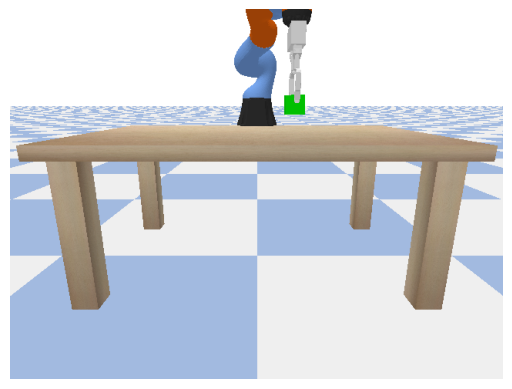

[Reward]: 1
Fetch green


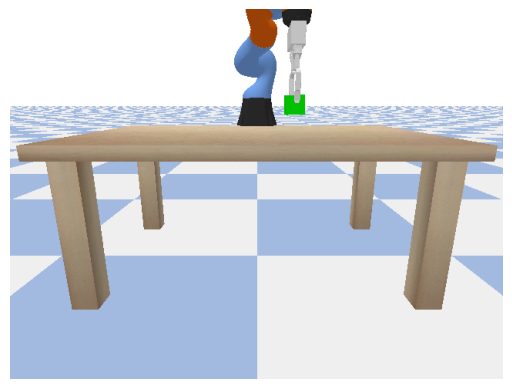

[Reward]: 1
Lift blue


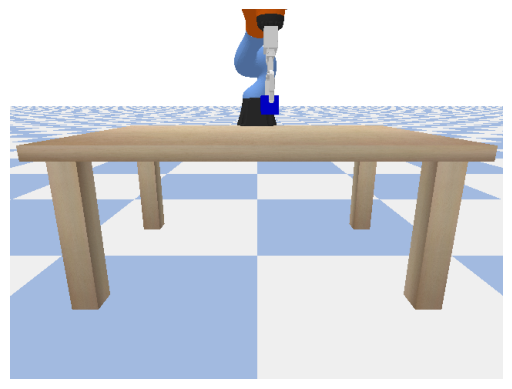

[Reward]: 1
Lift blue


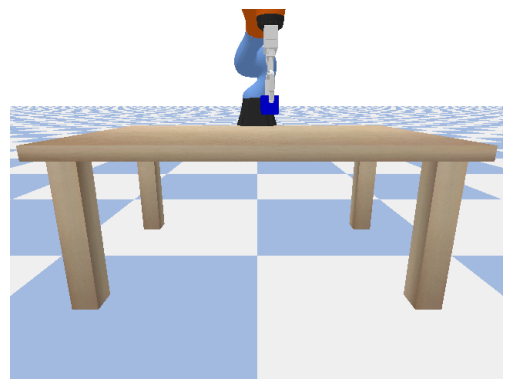

[Reward]: 1
Grab blue


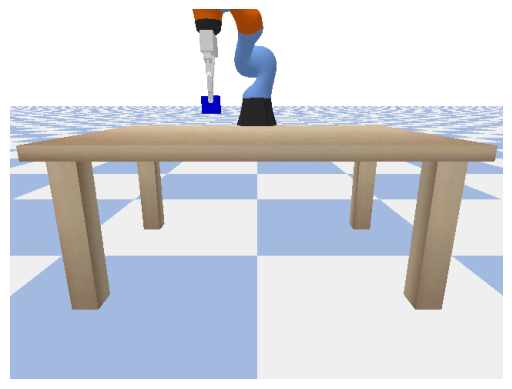

[Reward]: 1
Grab blue


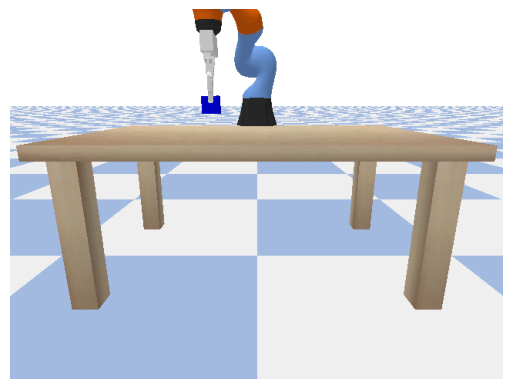

[Reward]: 1
Acquire green


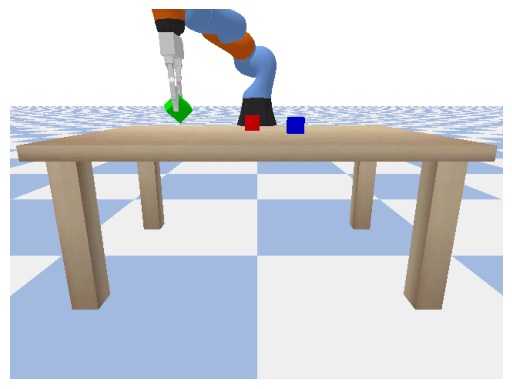

(-0.23983272910118103, 0.3088059723377228, 1.2815494537353516)
run fail
[Reward]: -1
Acquire green
Exception expected an indented block after function definition on line 1 (<string>, line 1)


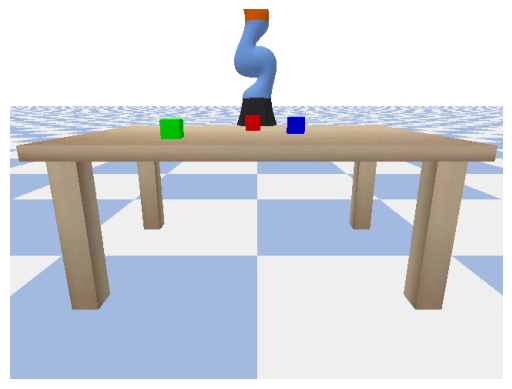

(0.4380102753639221, 8.451439498458058e-05, 2.131457805633545)
run fail
[Reward]: -1
Raise green


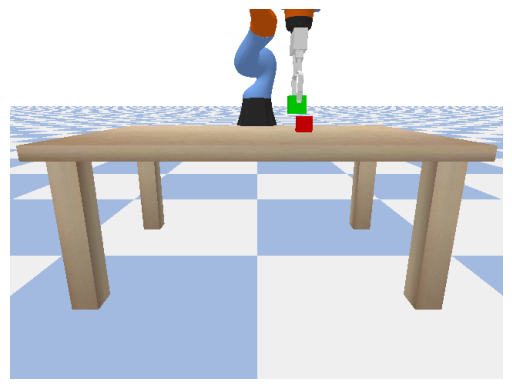

[Reward]: 1
Raise green
Exception expected an indented block after function definition on line 1 (<string>, line 1)


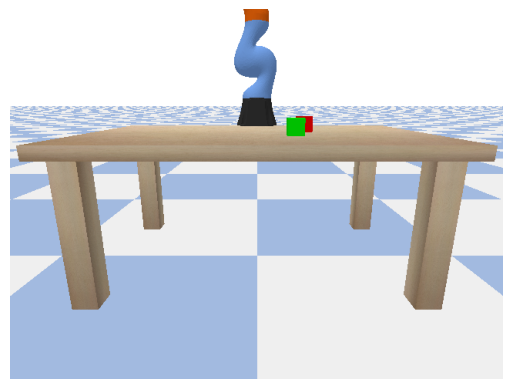

(0.4380102753639221, 8.451439498458058e-05, 2.131457805633545)
run fail
[Reward]: -1
Collect green


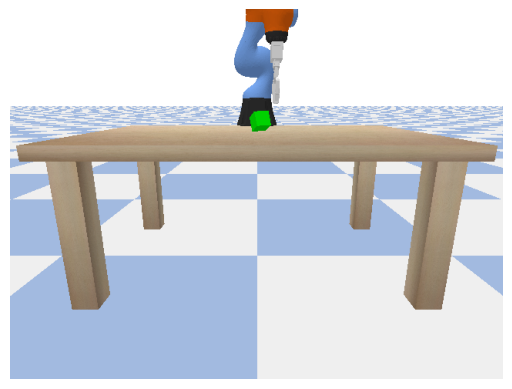

[Reward]: 1
Collect green


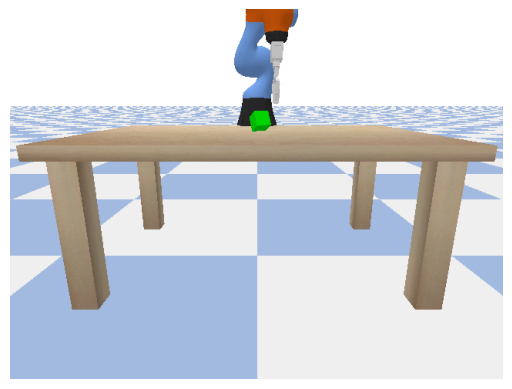

[Reward]: 1
Hoist blue


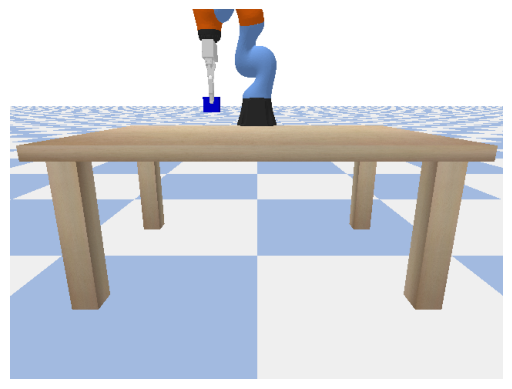

[Reward]: 1
Hoist blue


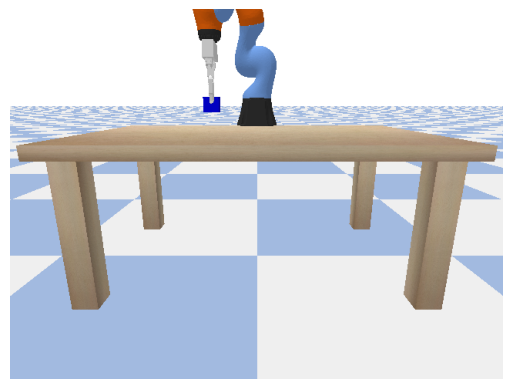

[Reward]: 1
Grasp green


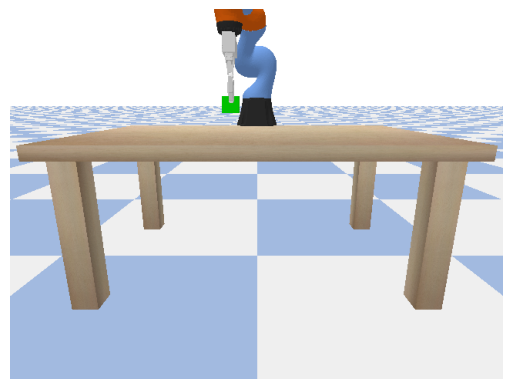

[Reward]: 1
Grasp green


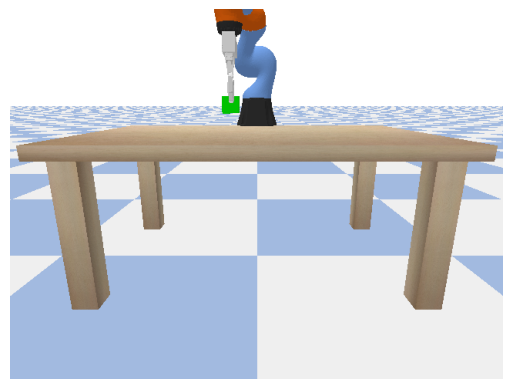

[Reward]: 1


Step,Training Loss
1,-0.000700
2,0.000000
3,0.000000
4,0.000000
5,0.000000
6,0.000000
7,0.000000
8,0.000000
9,0.000000
10,0.000000


Retrieve green


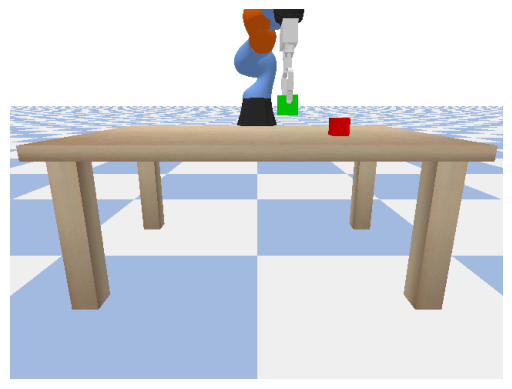

[Reward]: 1
Retrieve green


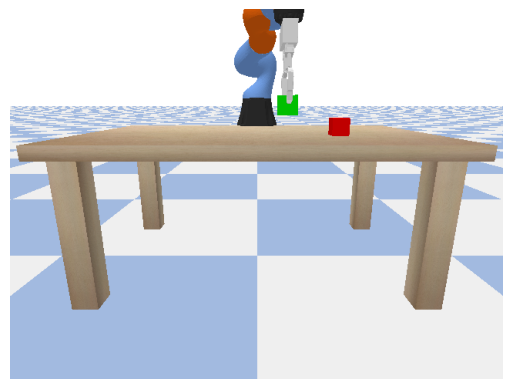

[Reward]: 1
Get red


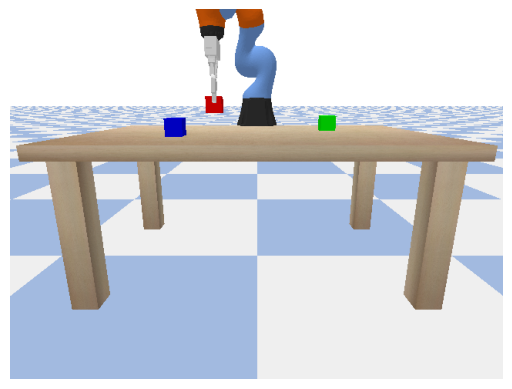

[Reward]: 1
Get red


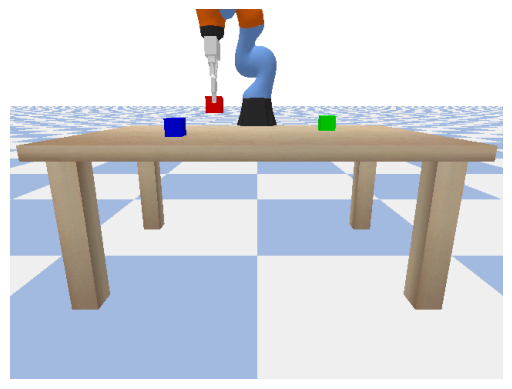

[Reward]: 1
Hold blue


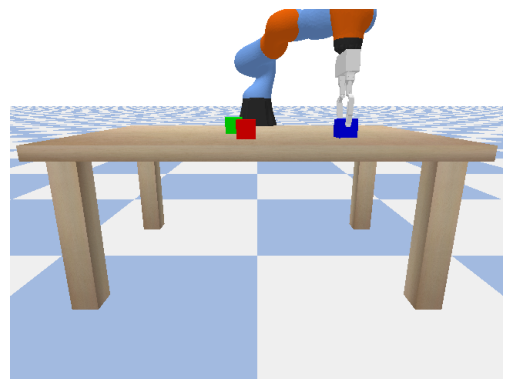

[Reward]: 1
Hold blue


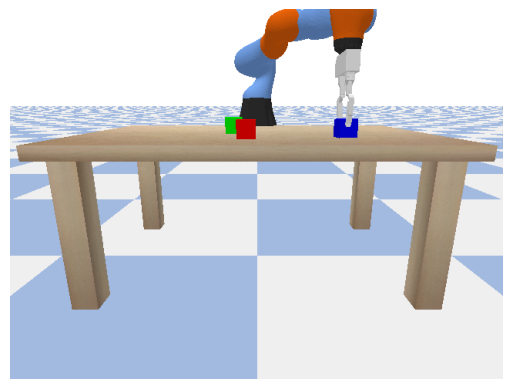

[Reward]: 1
Carry blue


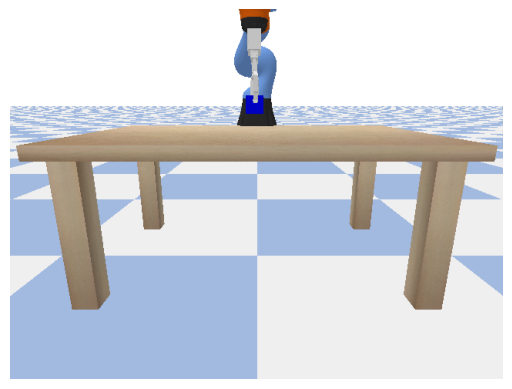

[Reward]: 1
Carry blue


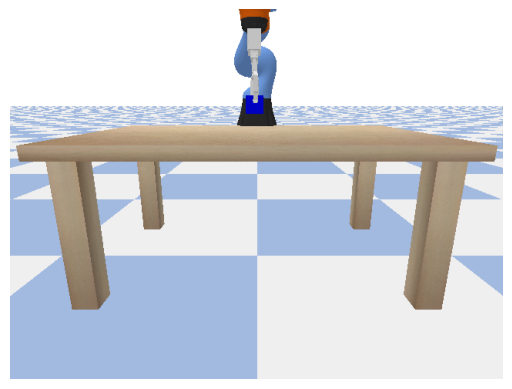

[Reward]: 1
Seize red


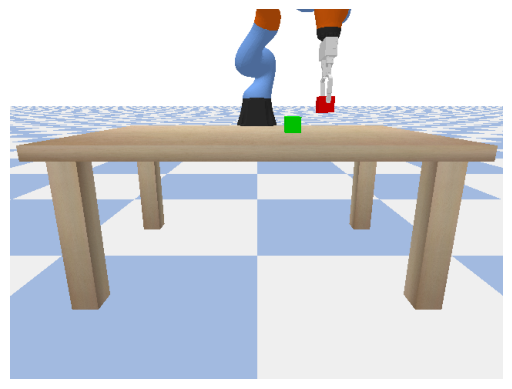

[Reward]: 1
Seize red


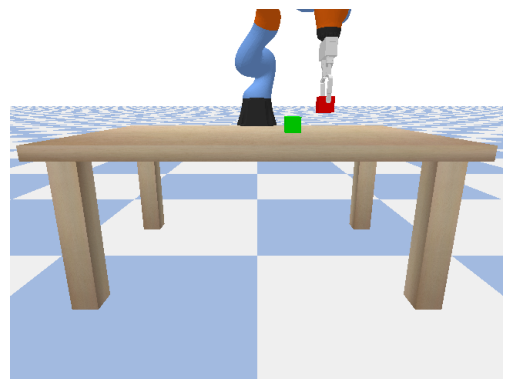

[Reward]: 1
Grab green


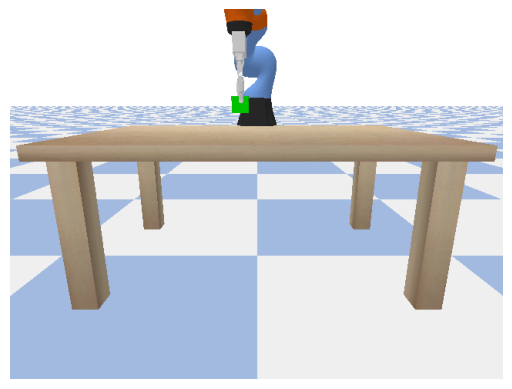

[Reward]: 1
Grab green


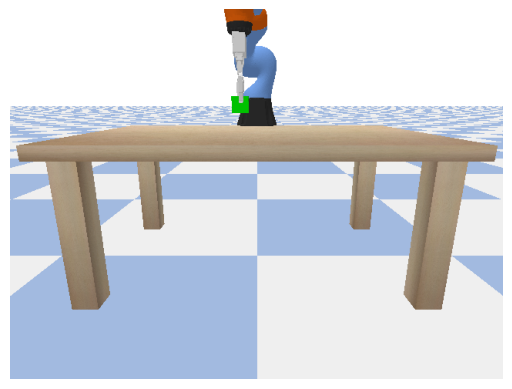

[Reward]: 1
Seize blue


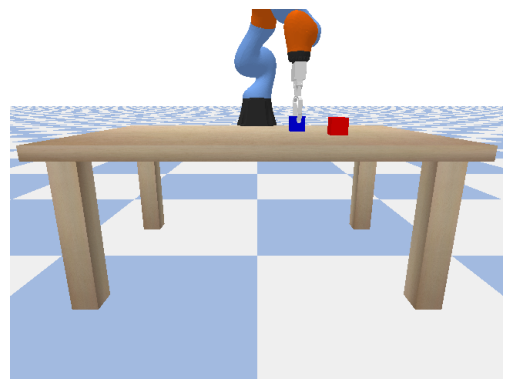

[Reward]: 1
Seize blue


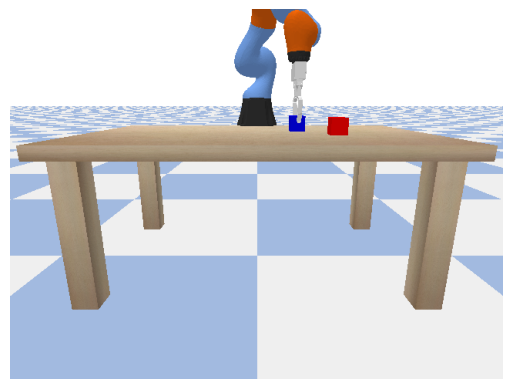

[Reward]: 1
Get green


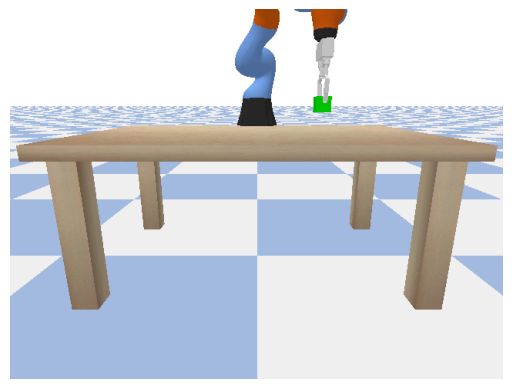

[Reward]: 1
Get green


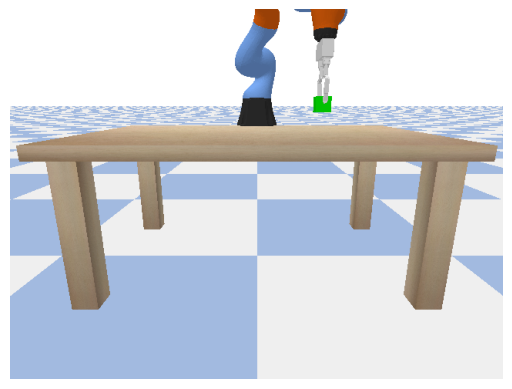

[Reward]: 1
Hold blue


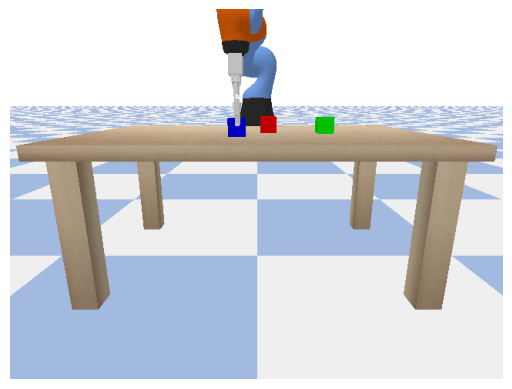

[Reward]: 1
Hold blue


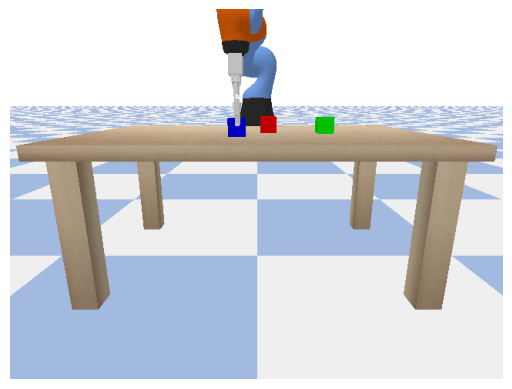

[Reward]: 1
Fetch blue


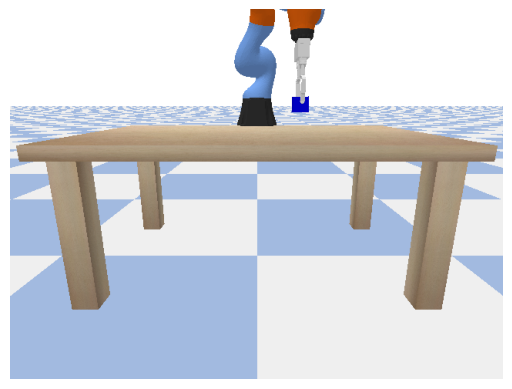

[Reward]: 1
Fetch blue


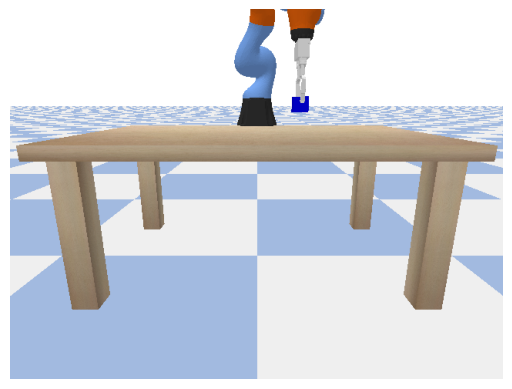

[Reward]: 1
Collect red


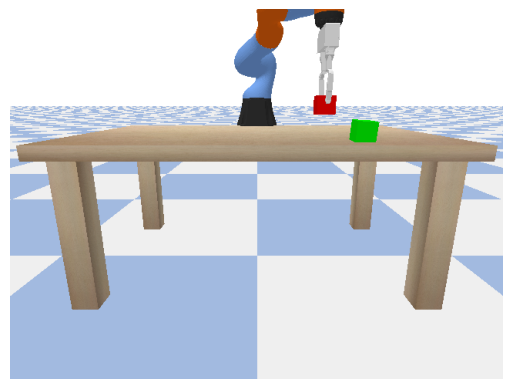

[Reward]: 1
Collect red


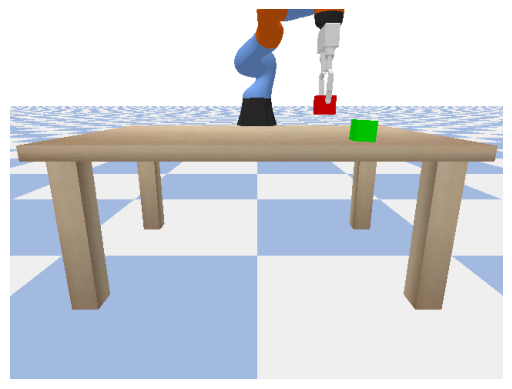

[Reward]: 1
Pick blue


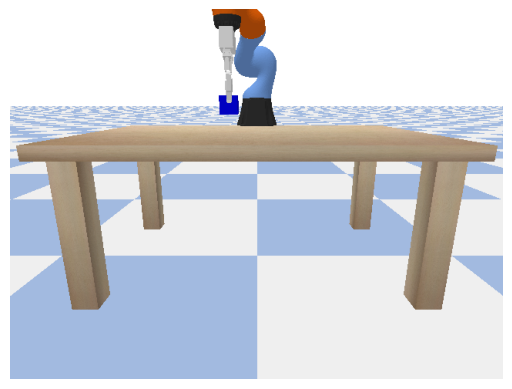

[Reward]: 1
Pick blue


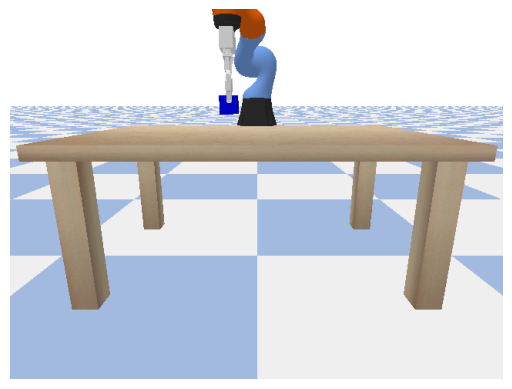

[Reward]: 1
Take green


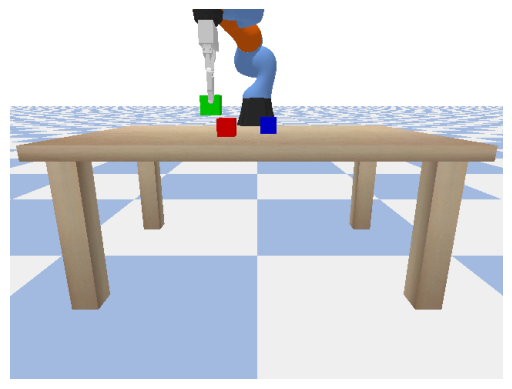

[Reward]: 1
Take green


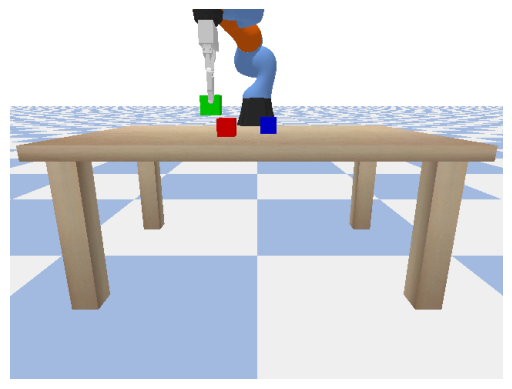

[Reward]: 1
Lift green


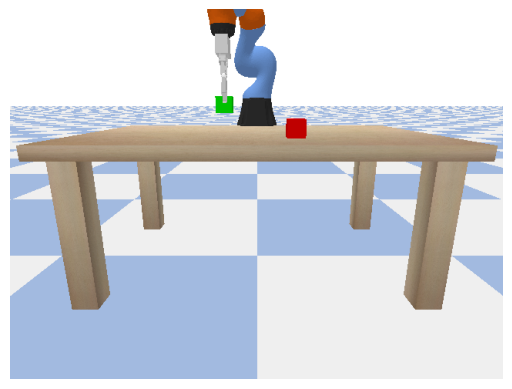

[Reward]: 1
Lift green


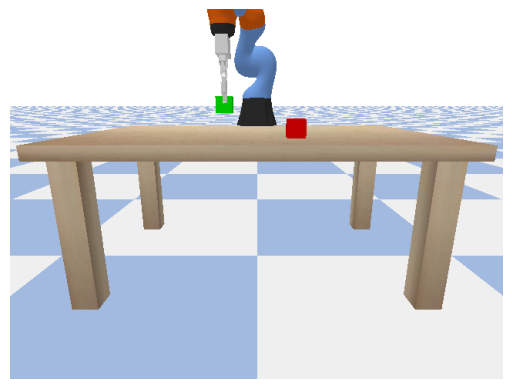

[Reward]: 1
Raise blue


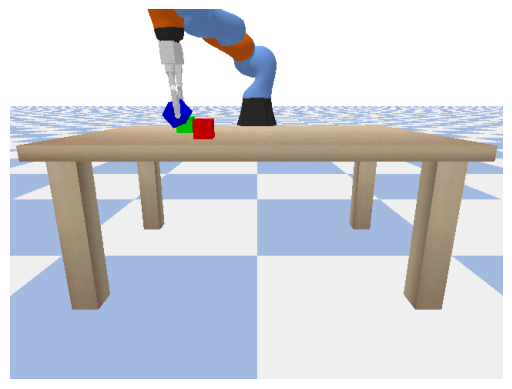

(-0.2364187389612198, 0.31454983353614807, 1.2584813833236694)
run fail
[Reward]: -1
Raise blue


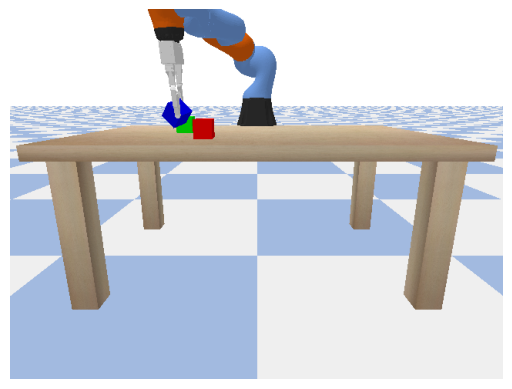

(-0.23641622066497803, 0.31455564498901367, 1.2584803104400635)
run fail
[Reward]: -1
Hoist green
Exception expected an indented block after function definition on line 1 (<string>, line 1)


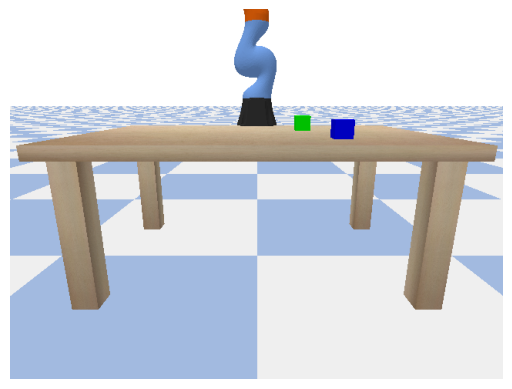

(0.4380102753639221, 8.451439498458058e-05, 2.131457805633545)
run fail
[Reward]: -1
Hoist green
Exception expected an indented block after function definition on line 1 (<string>, line 1)


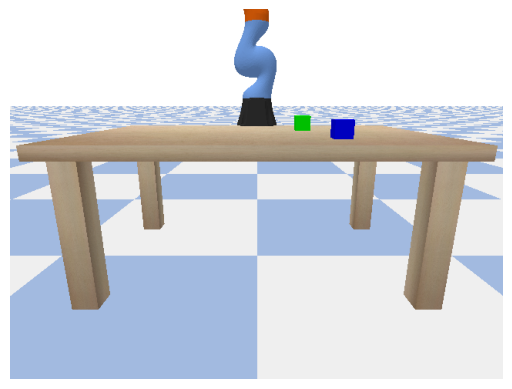

(0.4380102753639221, 8.451439498458058e-05, 2.131457805633545)
run fail
[Reward]: -1
Grasp red


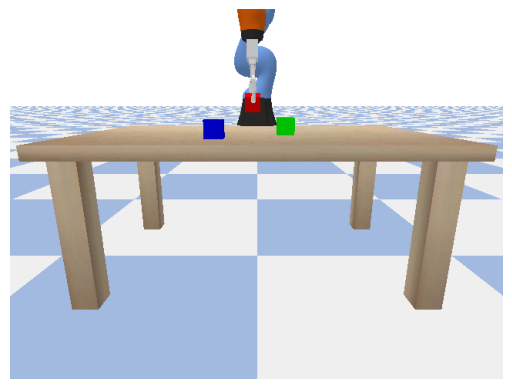

[Reward]: 1
Grasp red


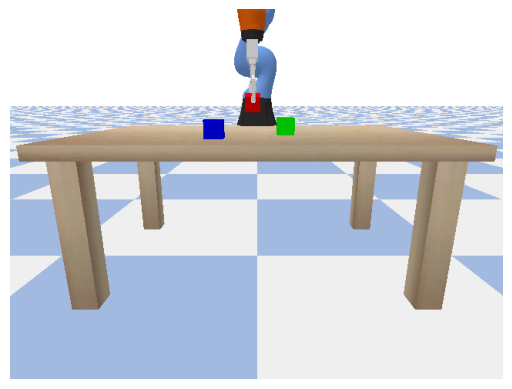

[Reward]: 1
Retrieve green


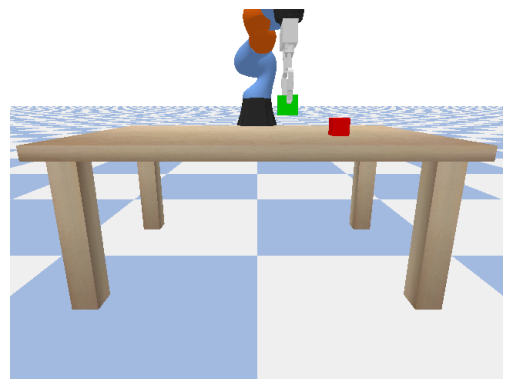

[Reward]: 1
Retrieve green


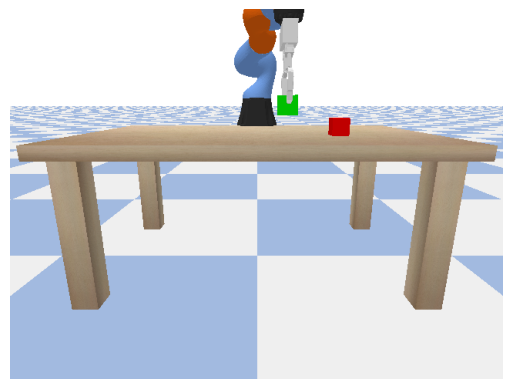

[Reward]: 1
Collect red


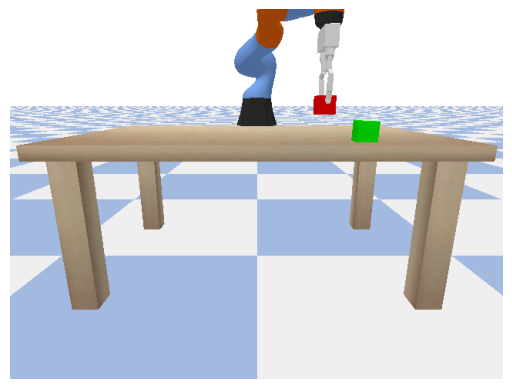

[Reward]: 1
Collect red


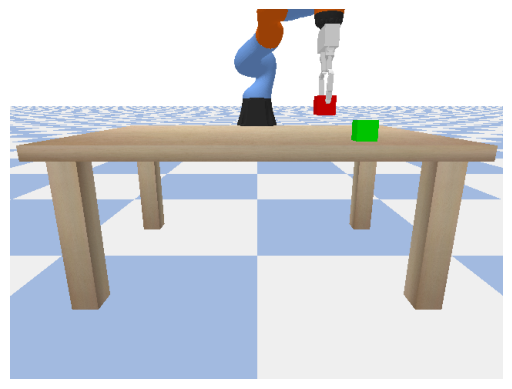

[Reward]: 1
Hoist blue


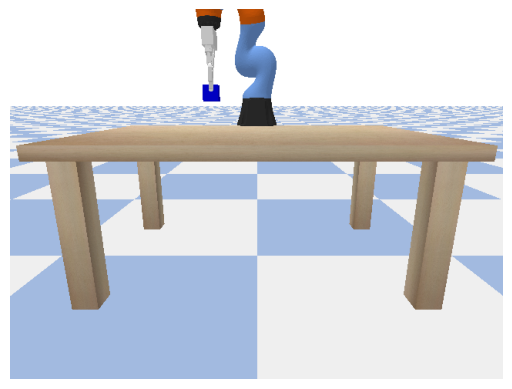

[Reward]: 1
Hoist blue


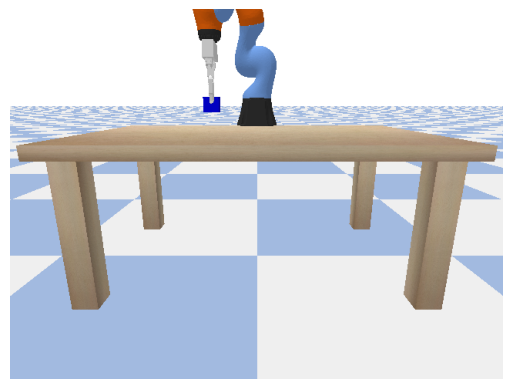

[Reward]: 1
Take green


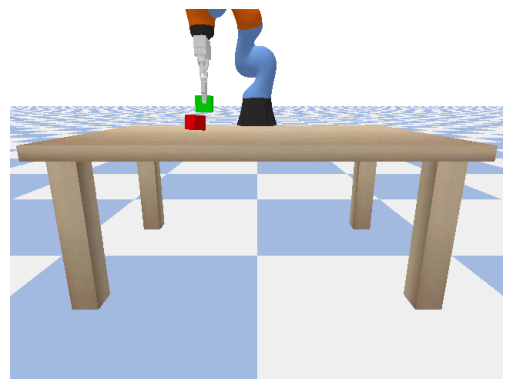

[Reward]: 0
Take green


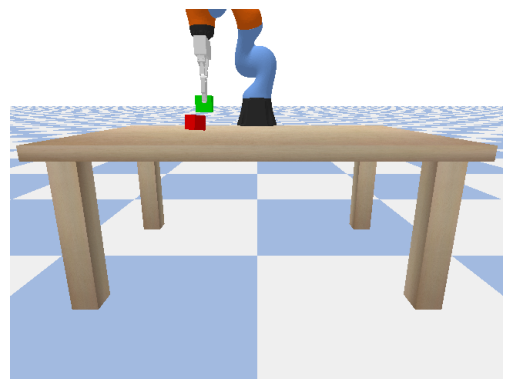

[Reward]: 1
Fetch blue


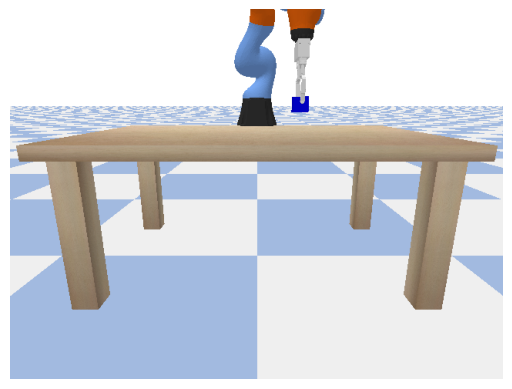

[Reward]: 1
Fetch blue


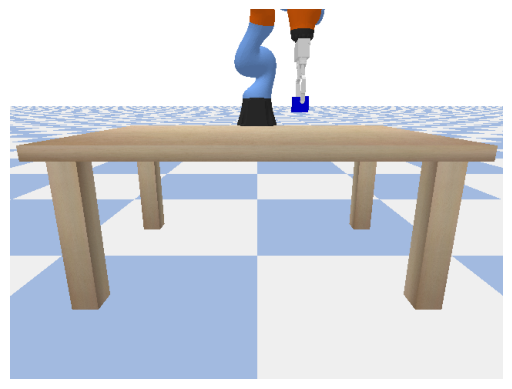

[Reward]: 1
Pick blue


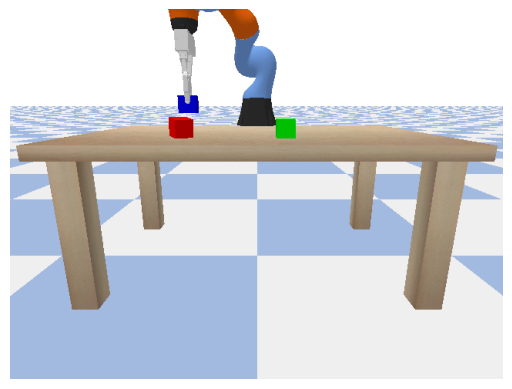

[Reward]: 1
Pick blue


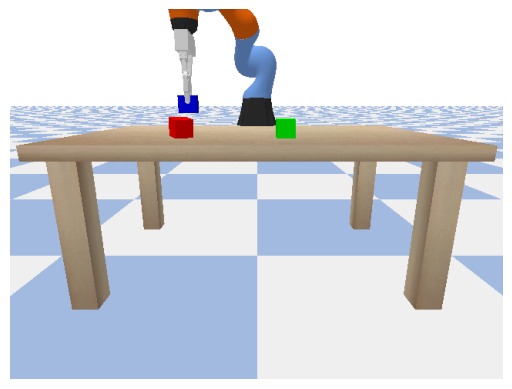

[Reward]: 1
Retrieve green


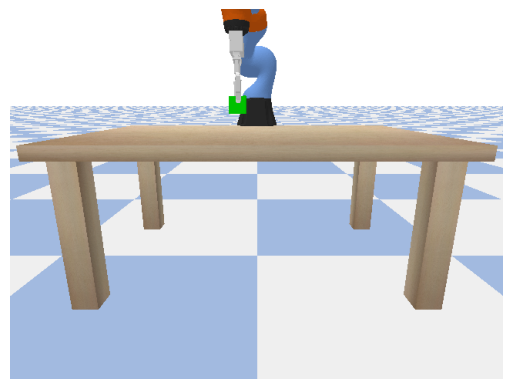

[Reward]: 1
Retrieve green


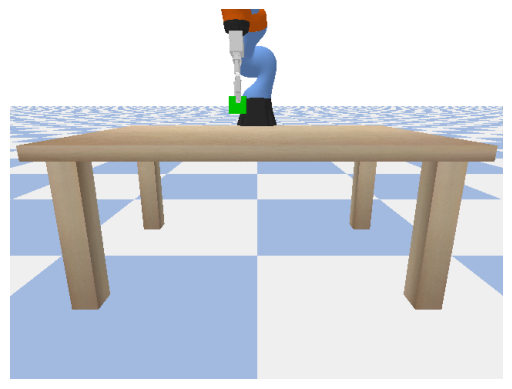

[Reward]: 1
Acquire blue


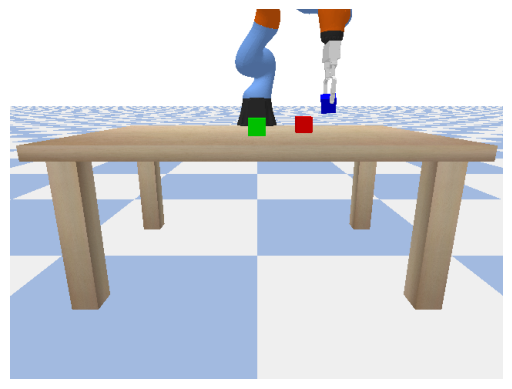

[Reward]: 1
Acquire blue


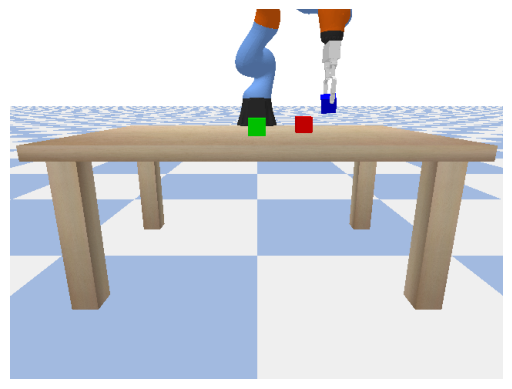

[Reward]: 1
Get green


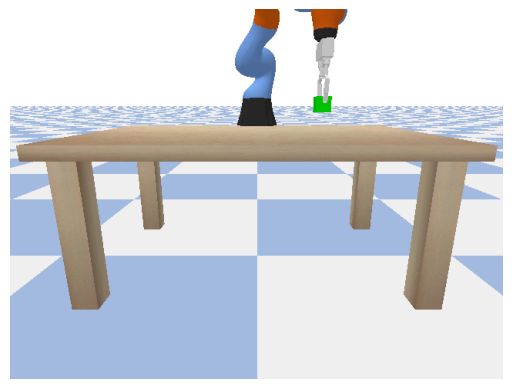

[Reward]: 1
Get green


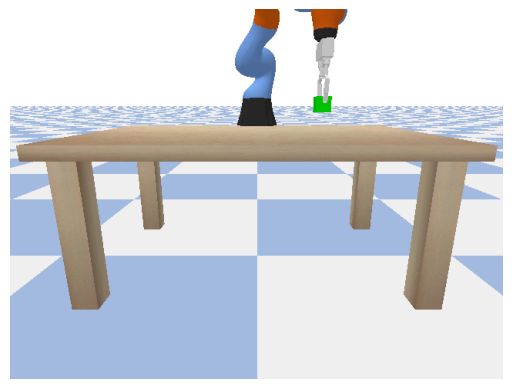

[Reward]: 1
Seize red


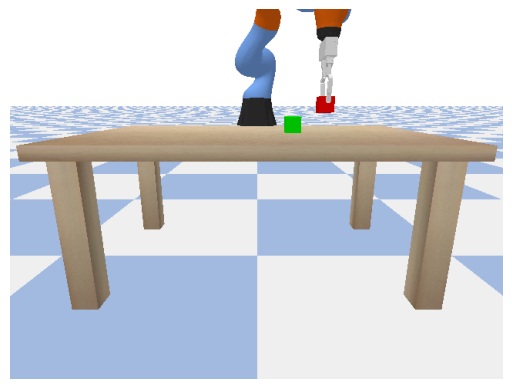

[Reward]: 1
Seize red


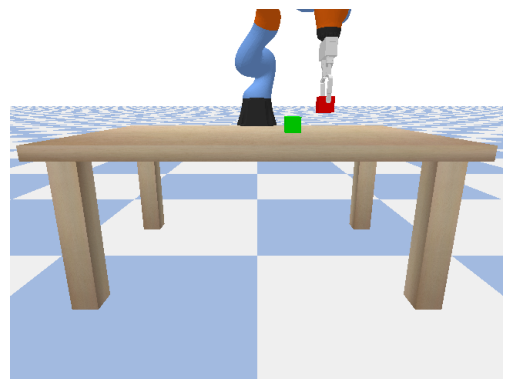

[Reward]: 1
Seize blue


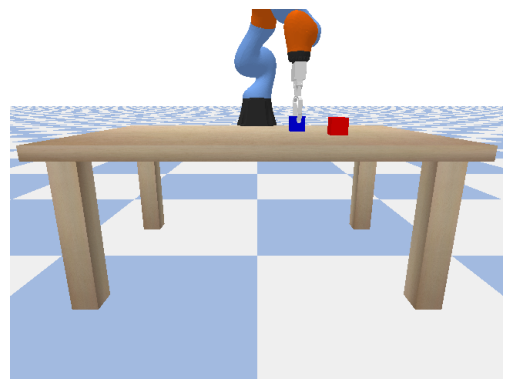

[Reward]: 1
Seize blue


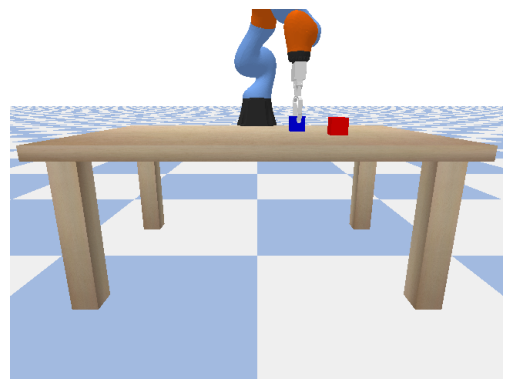

[Reward]: 1
Raise green


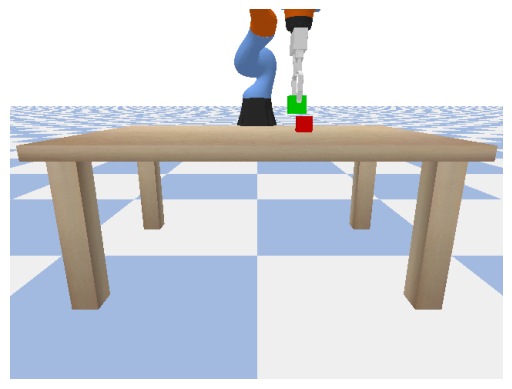

[Reward]: 0
Raise green


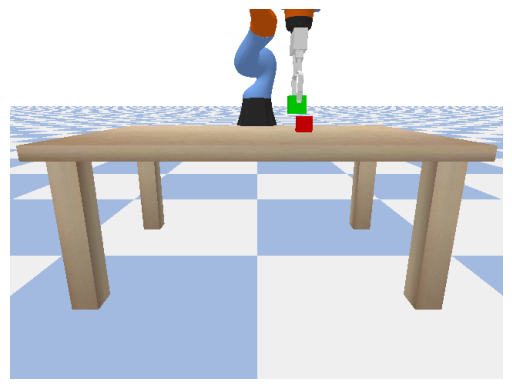

[Reward]: 1
Acquire green


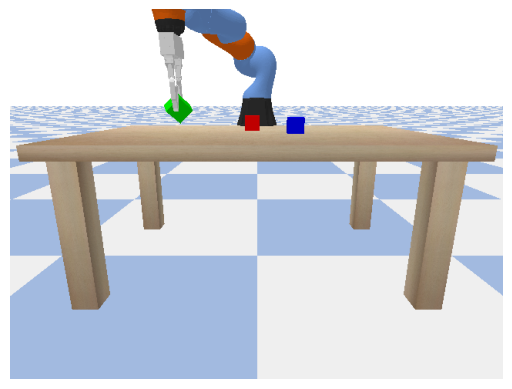

(-0.23983290791511536, 0.3088049292564392, 1.2815463542938232)
run fail
[Reward]: -1
Acquire green


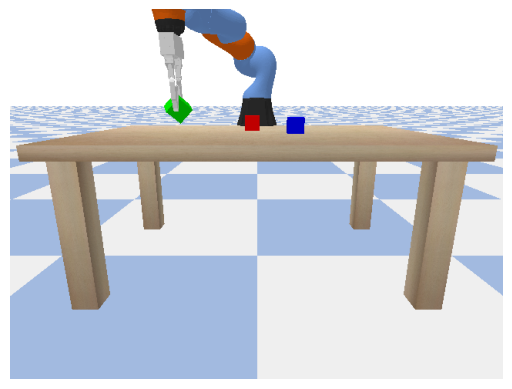

(-0.23983149230480194, 0.30880793929100037, 1.2815444469451904)
run fail
[Reward]: -1
Hold blue


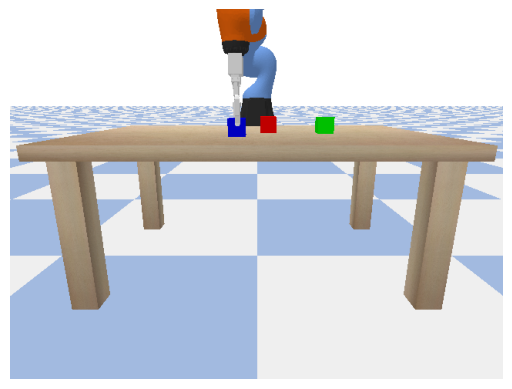

[Reward]: 1
Hold blue


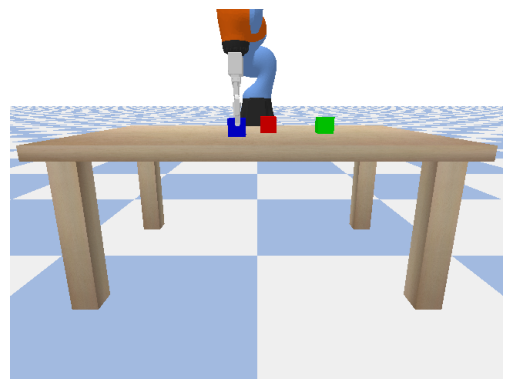

[Reward]: 1
Carry blue


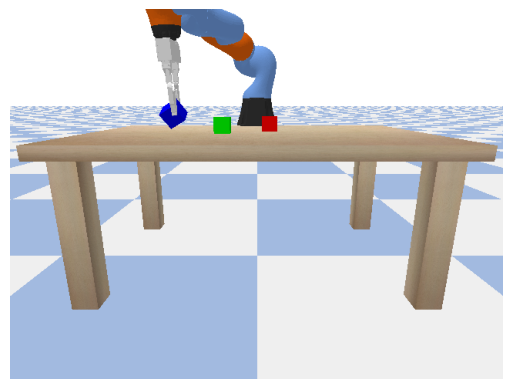

(-0.23196423053741455, 0.32571423053741455, 1.2666963338851929)
run fail
[Reward]: -1
Carry blue


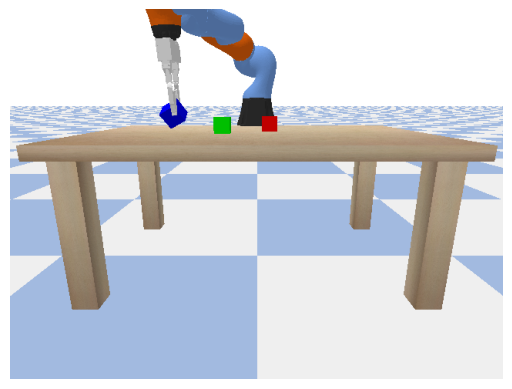

(-0.23197360336780548, 0.32569533586502075, 1.266697883605957)
run fail
[Reward]: -1
Collect green


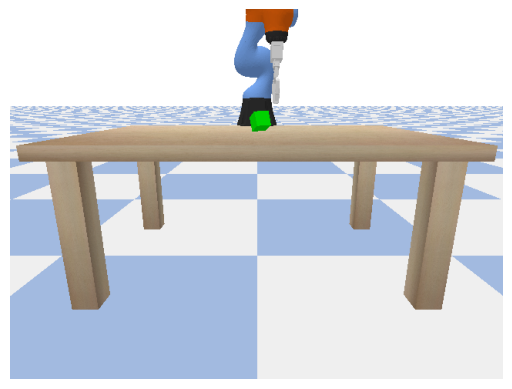

[Reward]: 1
Collect green


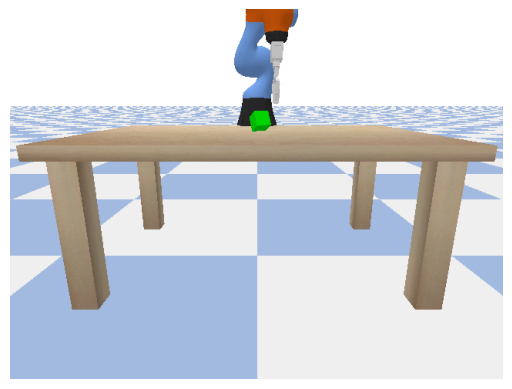

[Reward]: 1
Take green


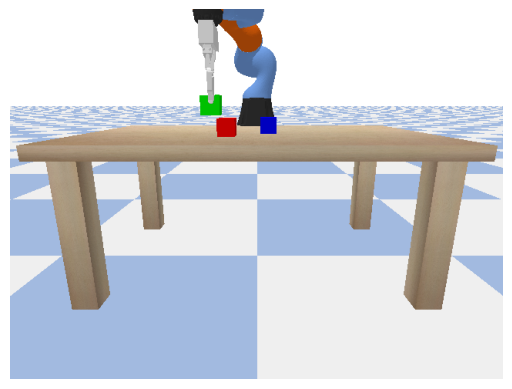

[Reward]: 1
Take green


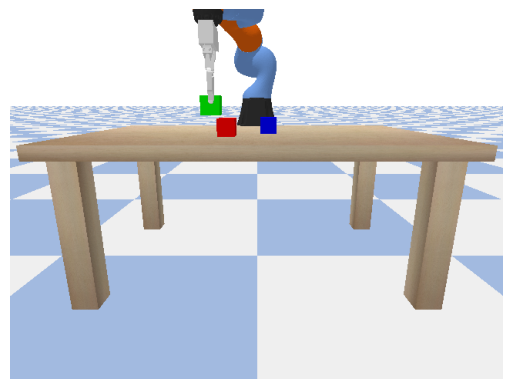

[Reward]: 1
Hold blue


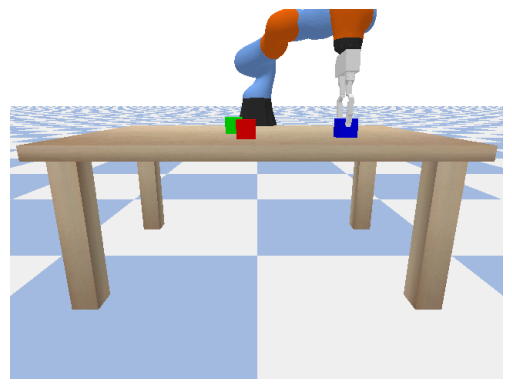

[Reward]: 1
Hold blue


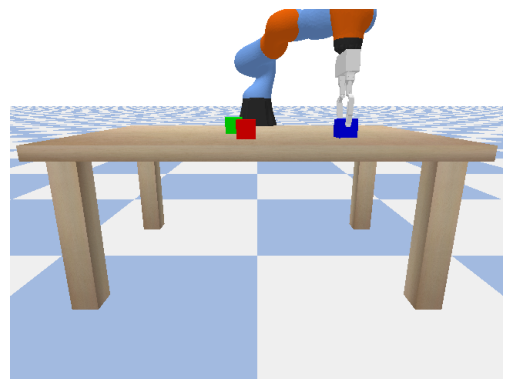

[Reward]: 1
Grasp green


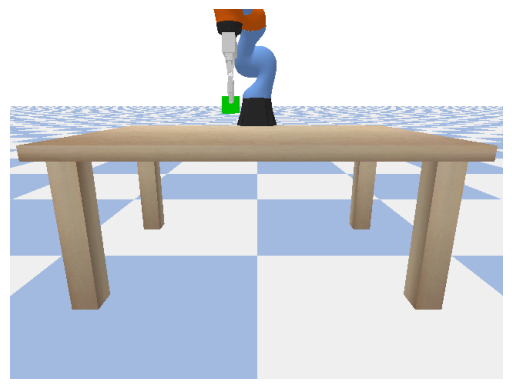

[Reward]: 1
Grasp green


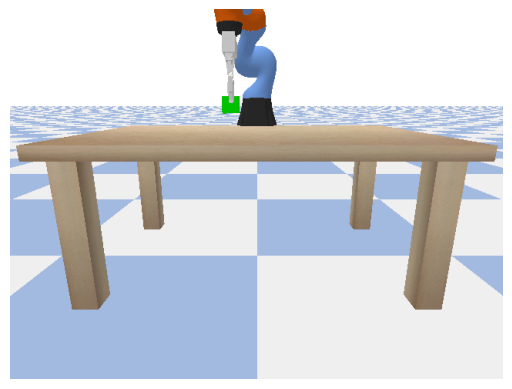

[Reward]: 1
Lift green


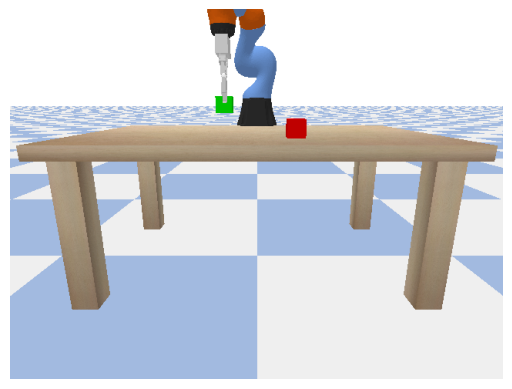

[Reward]: 1
Lift green


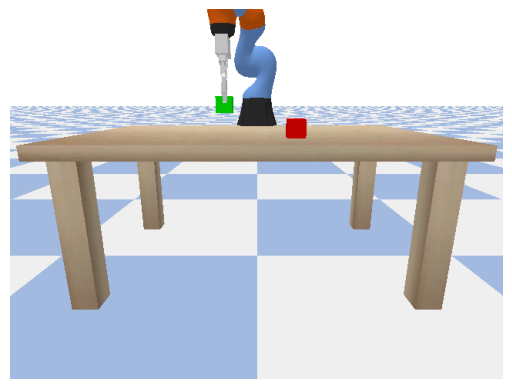

[Reward]: 1
Fetch green


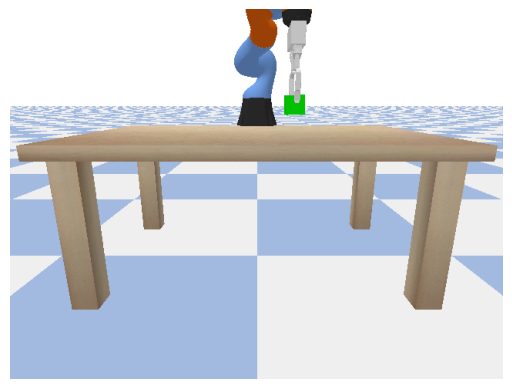

[Reward]: 1
Fetch green


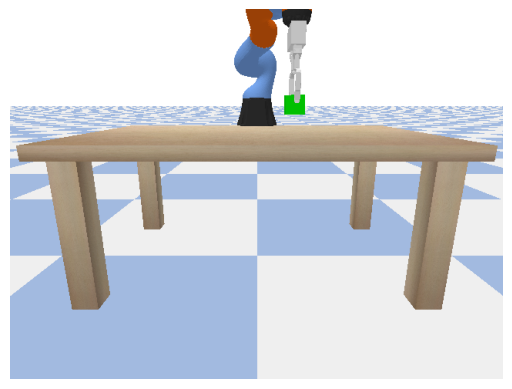

[Reward]: 1
Grab blue


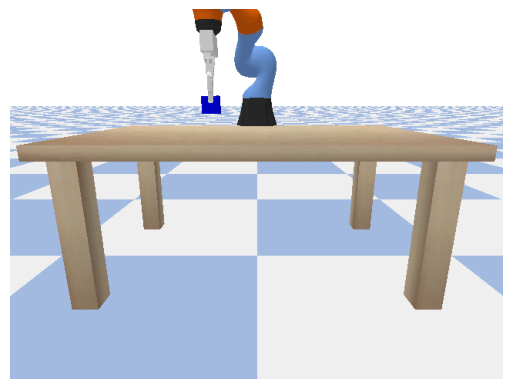

[Reward]: 1
Grab blue


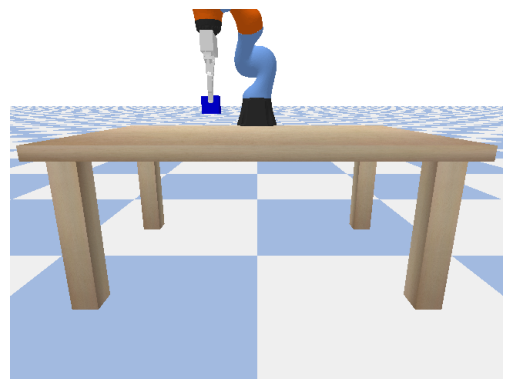

[Reward]: 1
Lift blue


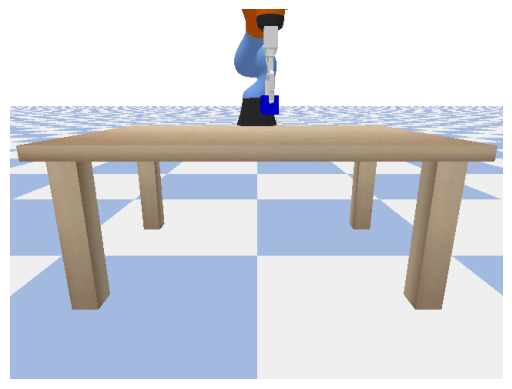

[Reward]: 1
Lift blue


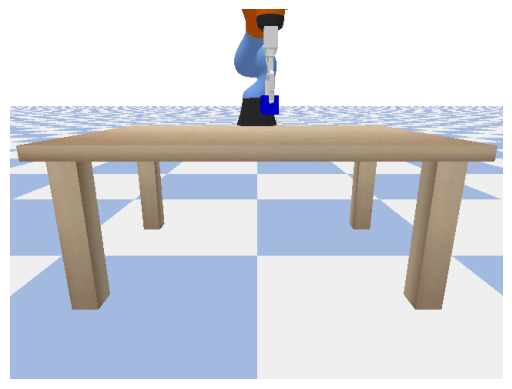

[Reward]: 1
Raise green


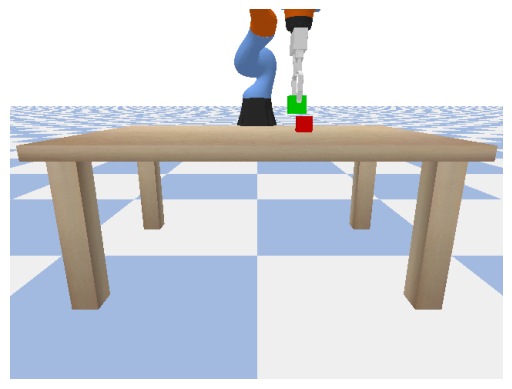

[Reward]: 0
Raise green


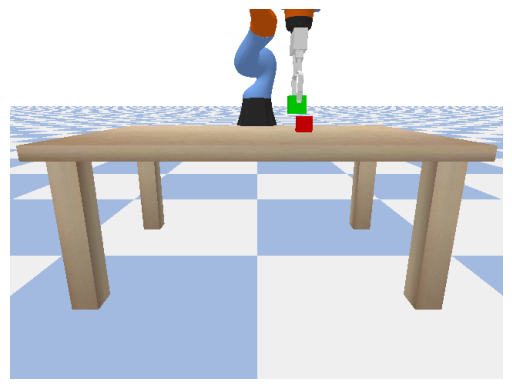

[Reward]: 1
Lift blue


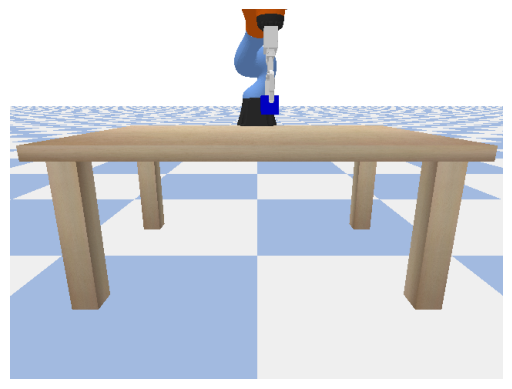

[Reward]: 1
Lift blue


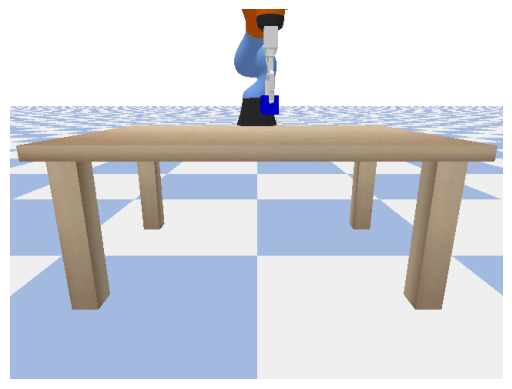

[Reward]: 1
Hold blue


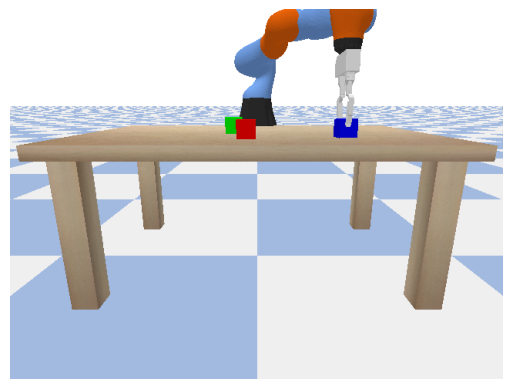

[Reward]: 1
Hold blue


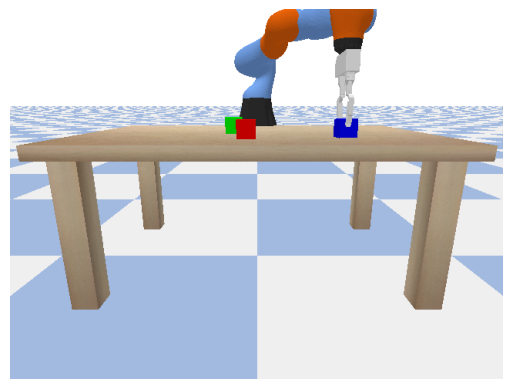

[Reward]: 1
Acquire blue


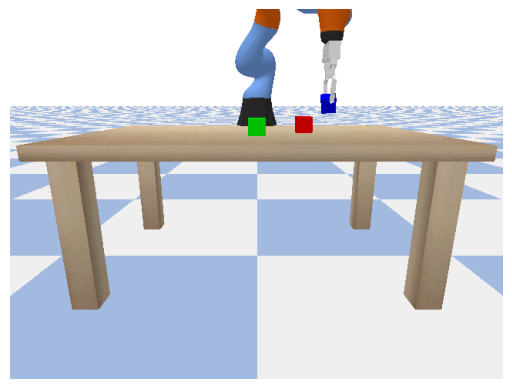

[Reward]: 1
Acquire blue


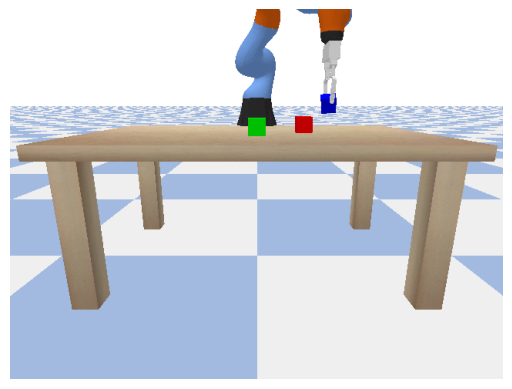

[Reward]: 1
Hoist blue


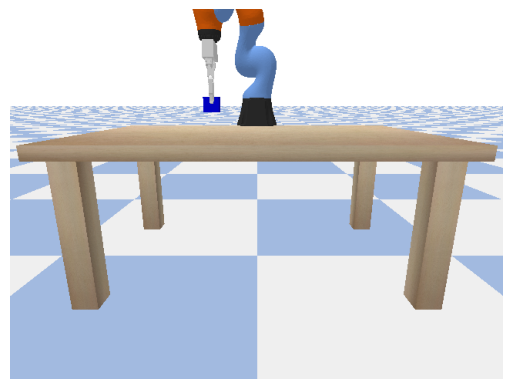

[Reward]: 1
Hoist blue


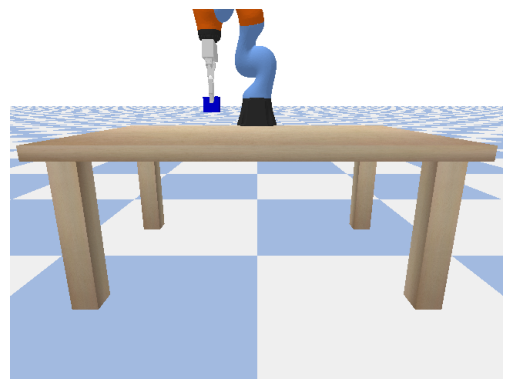

[Reward]: 1
Collect green


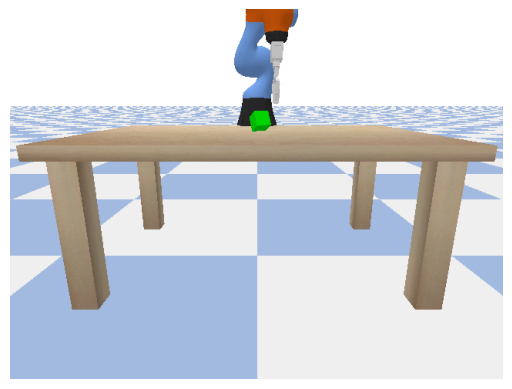

[Reward]: 1
Collect green


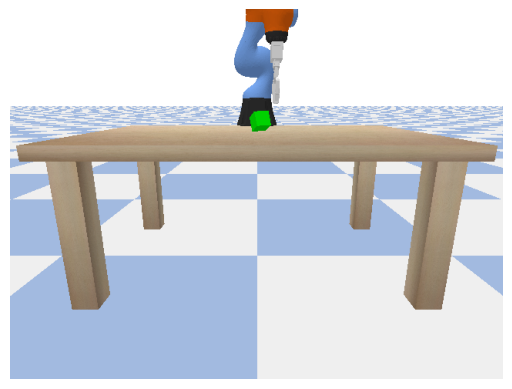

[Reward]: 1
Fetch green


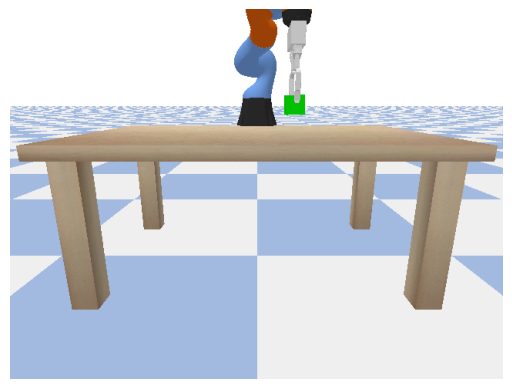

[Reward]: 1
Fetch green


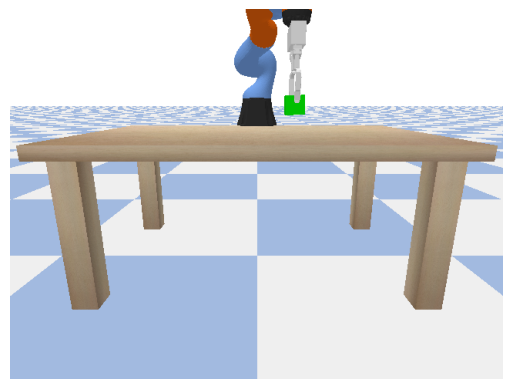

[Reward]: 1
Carry blue


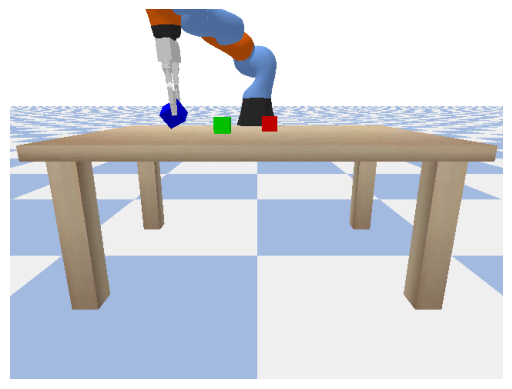

(-0.2319759726524353, 0.32569119334220886, 1.266701102256775)
run fail
[Reward]: -1
Carry blue


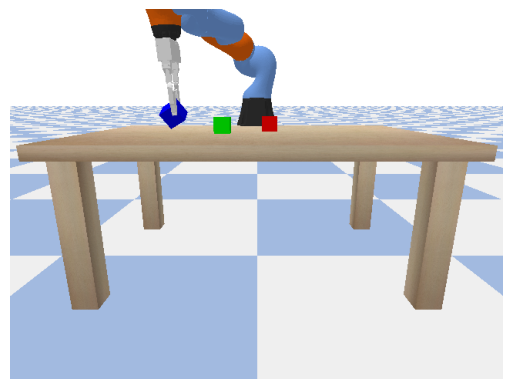

(-0.231976717710495, 0.3256918787956238, 1.2667300701141357)
run fail
[Reward]: -1
Acquire green


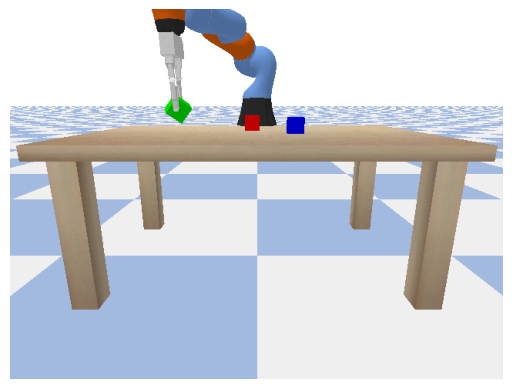

(-0.23982980847358704, 0.3088133633136749, 1.2815452814102173)
run fail
[Reward]: -1
Acquire green


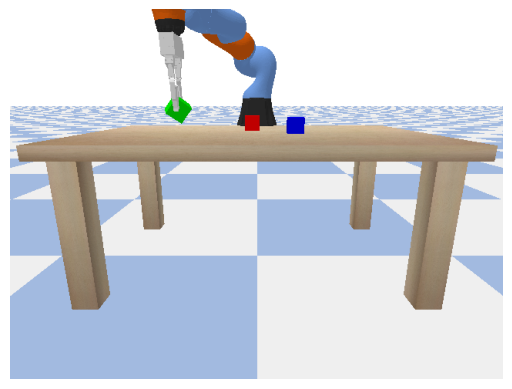

(-0.23983004689216614, 0.30881330370903015, 1.2815459966659546)
run fail
[Reward]: -1
Lift green


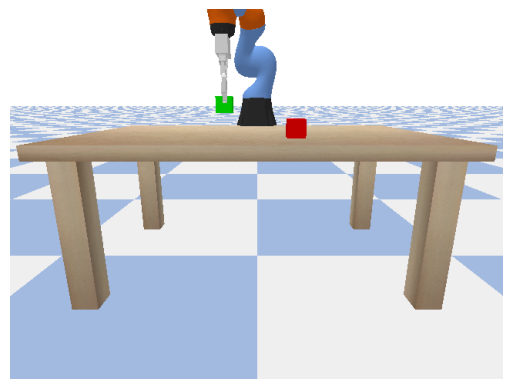

[Reward]: 1
Lift green


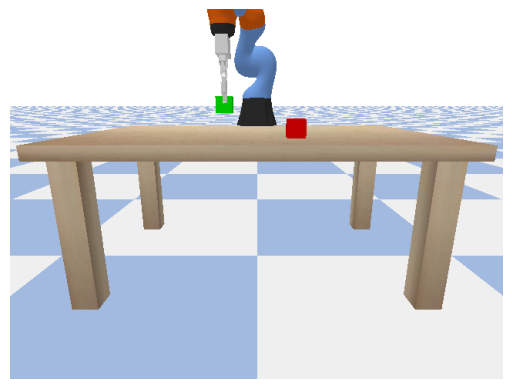

[Reward]: 1
Seize blue


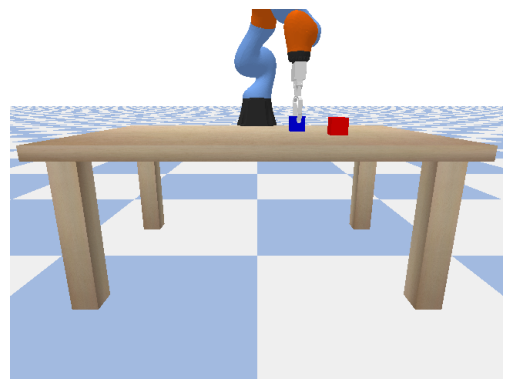

[Reward]: 1
Seize blue


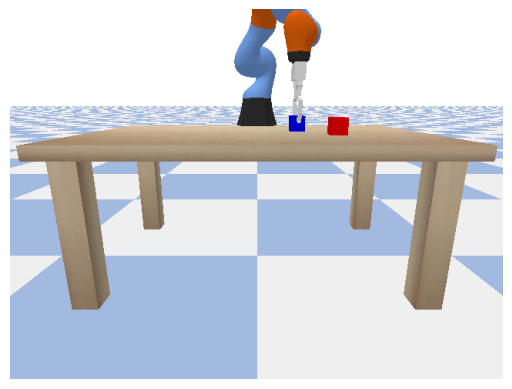

[Reward]: 1
Raise blue


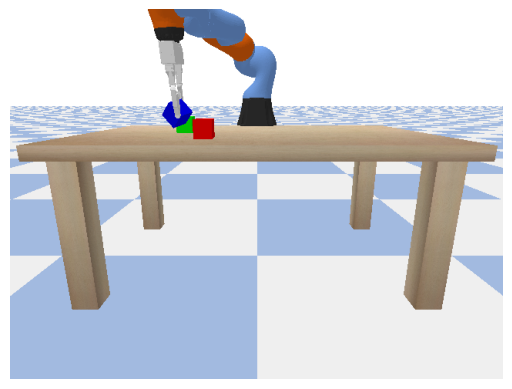

(-0.23641520738601685, 0.3145565986633301, 1.2584773302078247)
run fail
[Reward]: -1
Raise blue


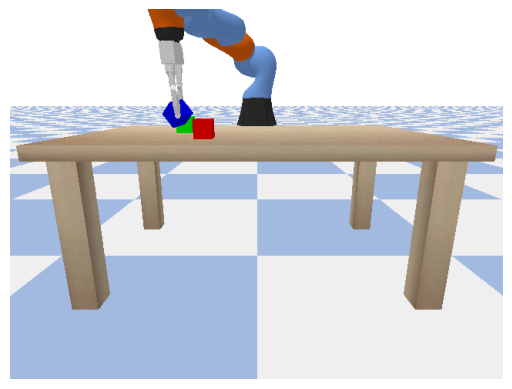

(-0.2364138811826706, 0.314558207988739, 1.2584738731384277)
run fail
[Reward]: -1
Hold blue


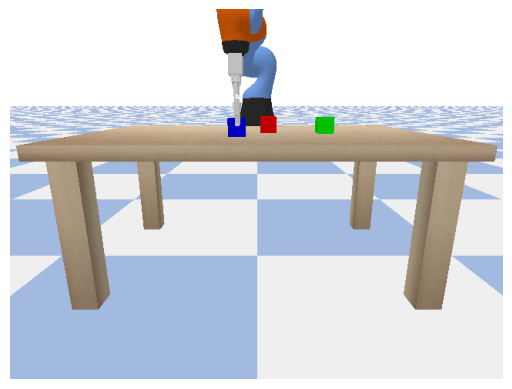

[Reward]: 1
Hold blue


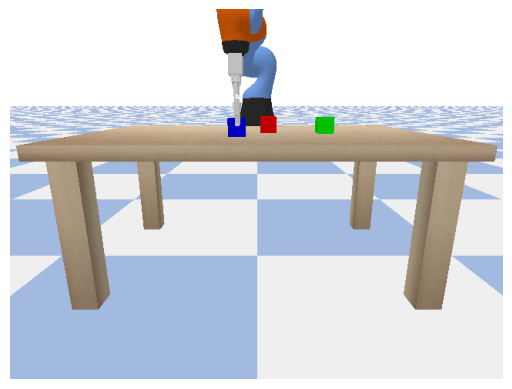

[Reward]: 1
Retrieve green


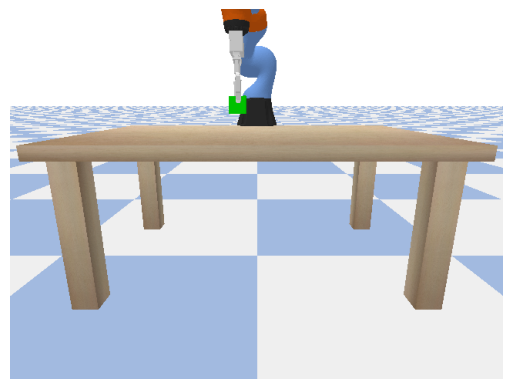

[Reward]: 1
Retrieve green


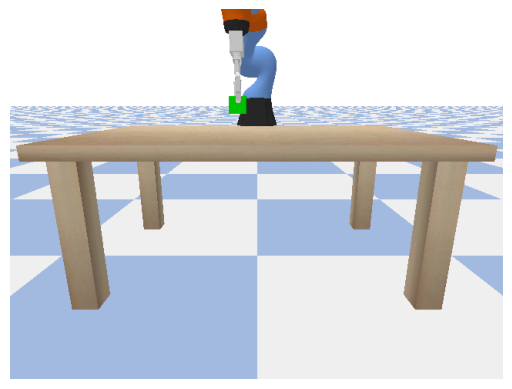

[Reward]: 1
Get green


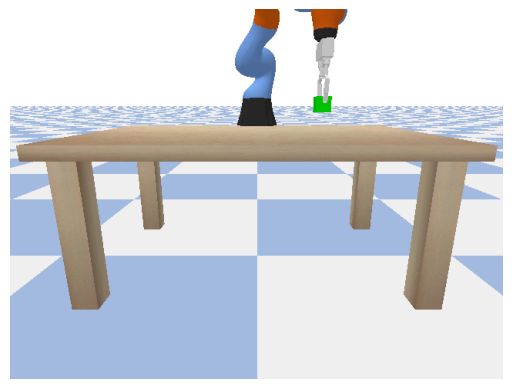

[Reward]: 1
Get green


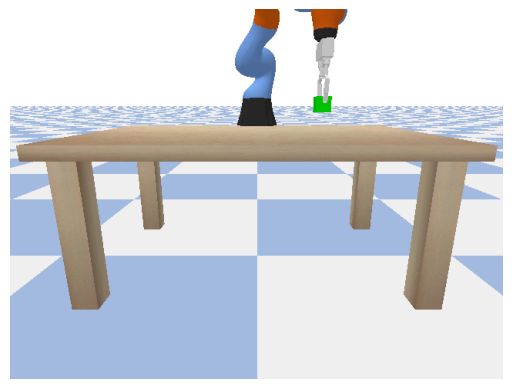

[Reward]: 1
Pick blue


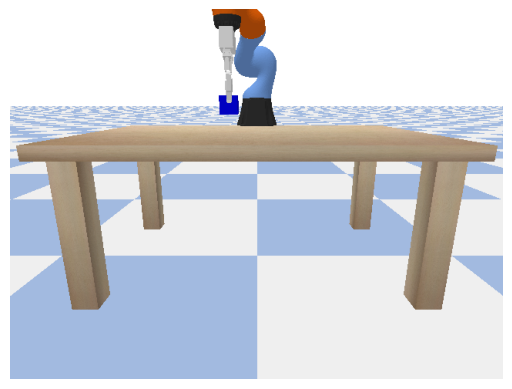

[Reward]: 1
Pick blue


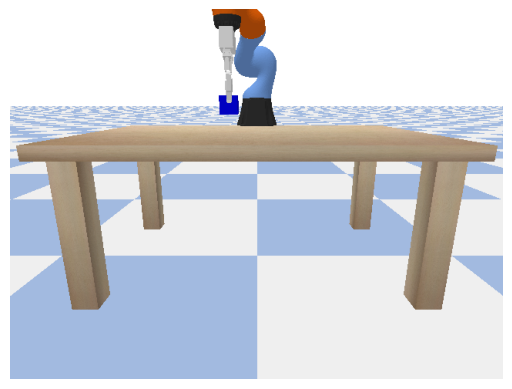

[Reward]: 1
Retrieve green


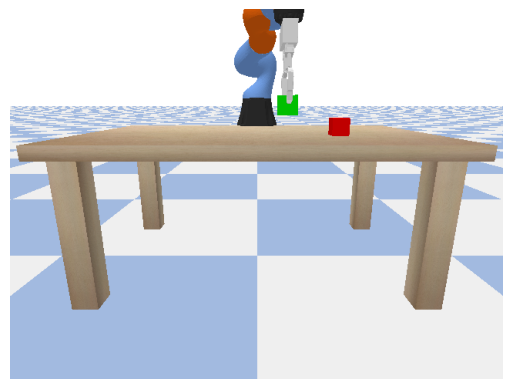

[Reward]: 1
Retrieve green


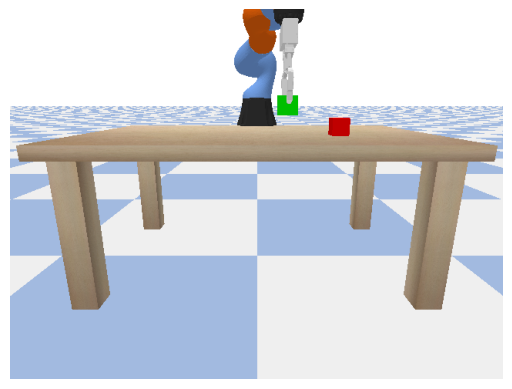

[Reward]: 1
Take green


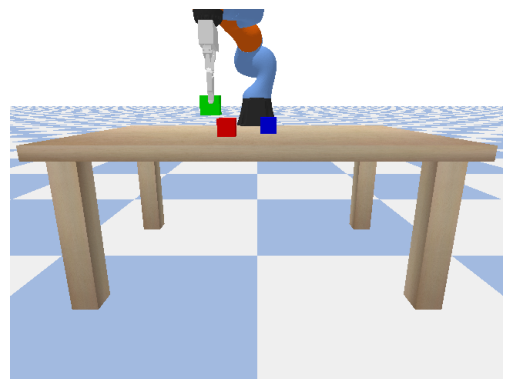

[Reward]: 1
Take green


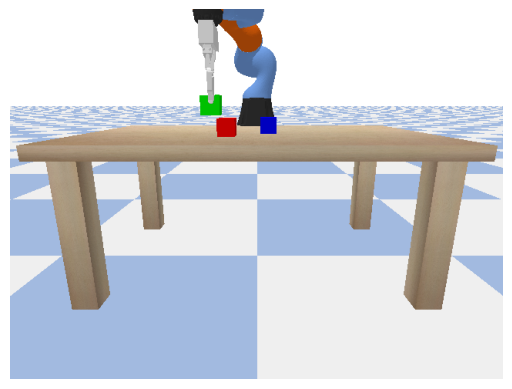

[Reward]: 1
Fetch blue


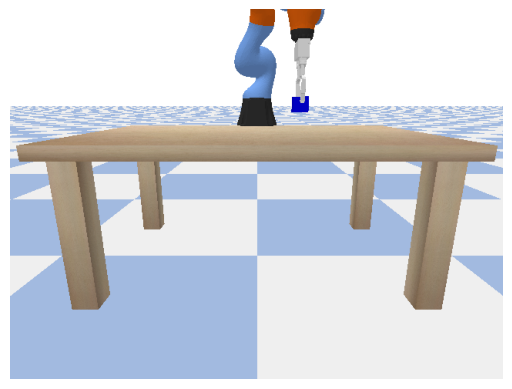

[Reward]: 1
Fetch blue


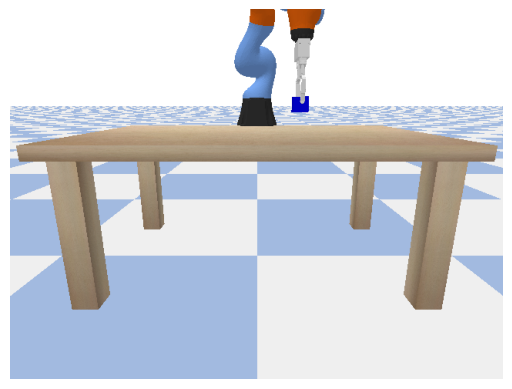

[Reward]: 1
Get red


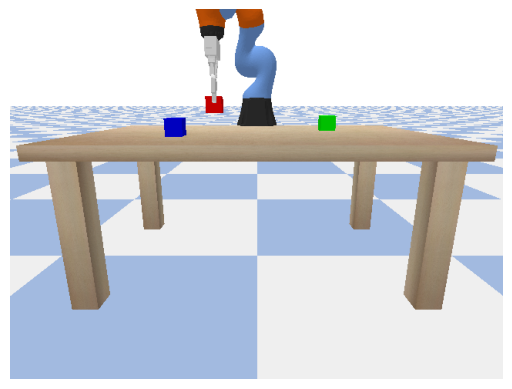

[Reward]: 1
Get red


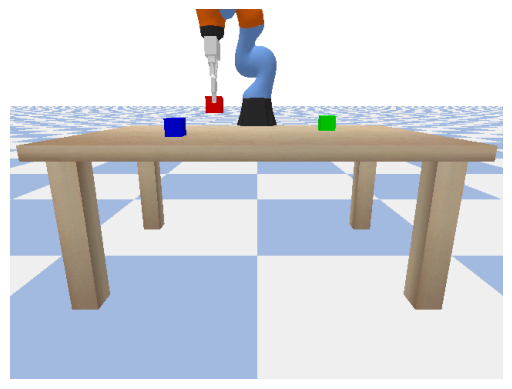

[Reward]: 1
Take green


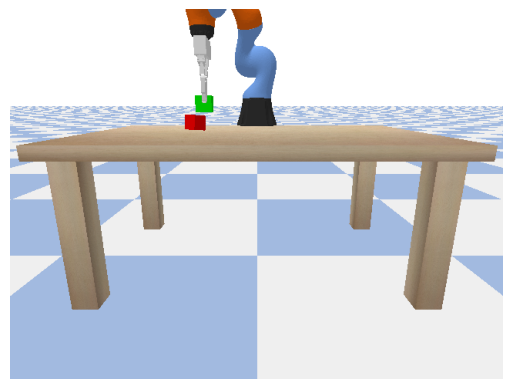

[Reward]: 1
Take green


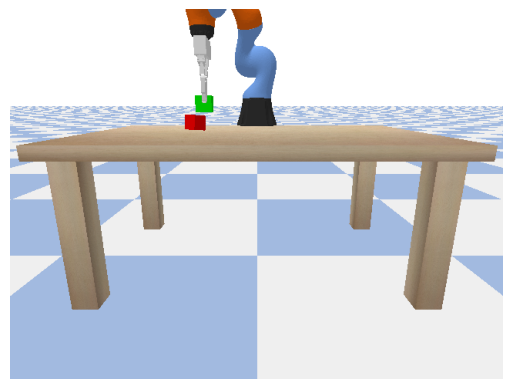

[Reward]: 1
Carry blue


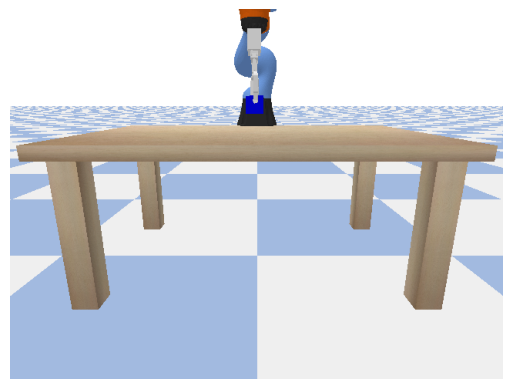

[Reward]: 1
Carry blue


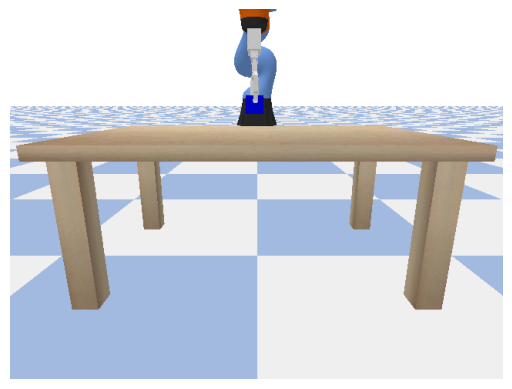

[Reward]: 1
Seize red


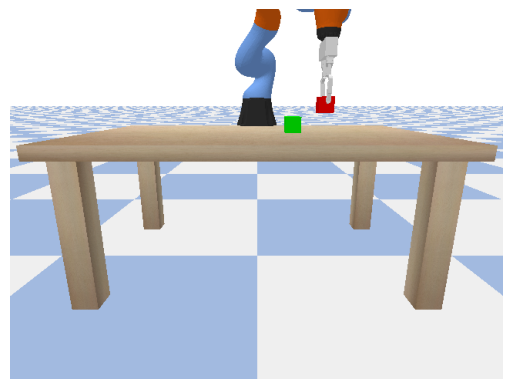

[Reward]: 1
Seize red


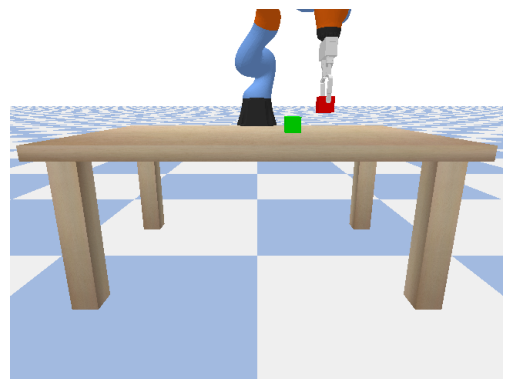

[Reward]: 1
Pick blue


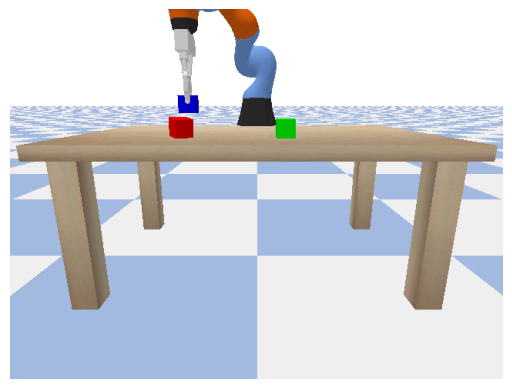

[Reward]: 1
Pick blue


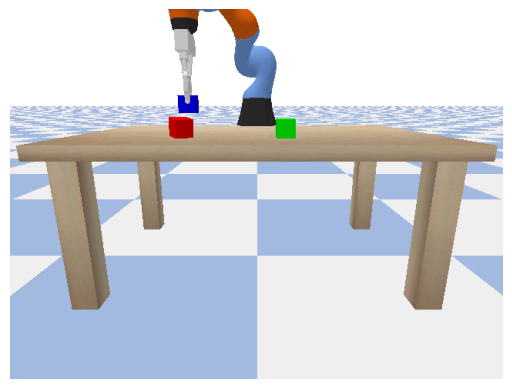

[Reward]: 1
Grasp green


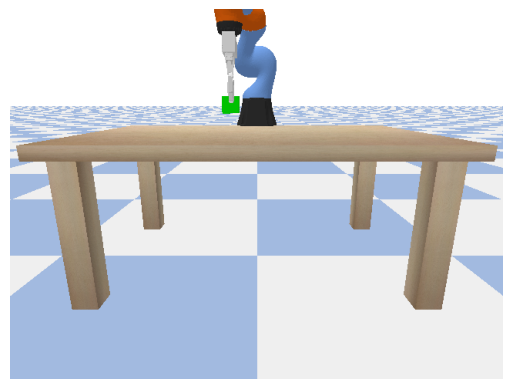

[Reward]: 1
Grasp green


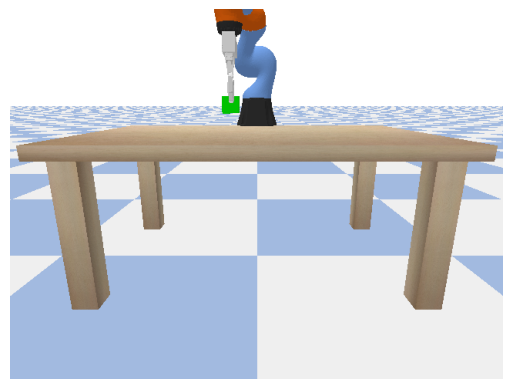

[Reward]: 1
Seize blue


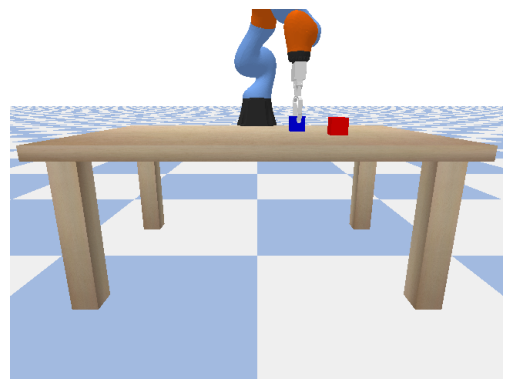

[Reward]: 1
Seize blue


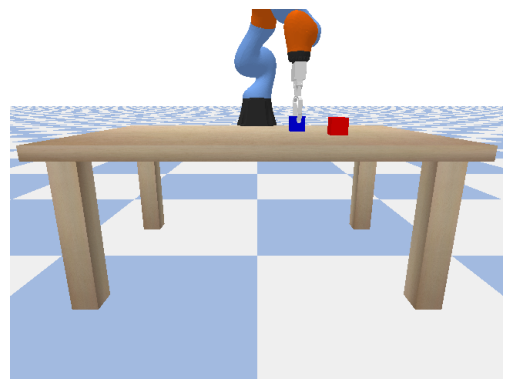

[Reward]: 1
Grab green


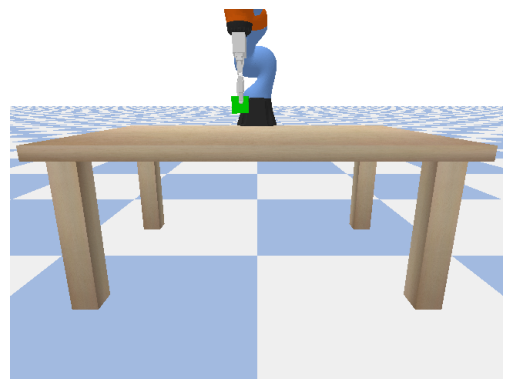

[Reward]: 1
Grab green


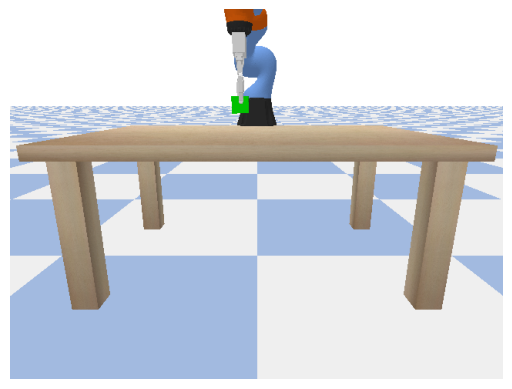

[Reward]: 1
Acquire green


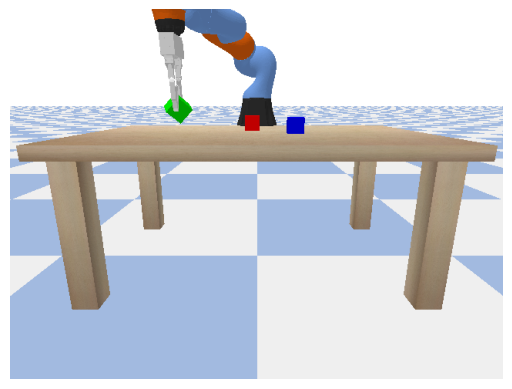

(-0.2398313730955124, 0.30880847573280334, 1.2815449237823486)
run fail
[Reward]: -1
Acquire green


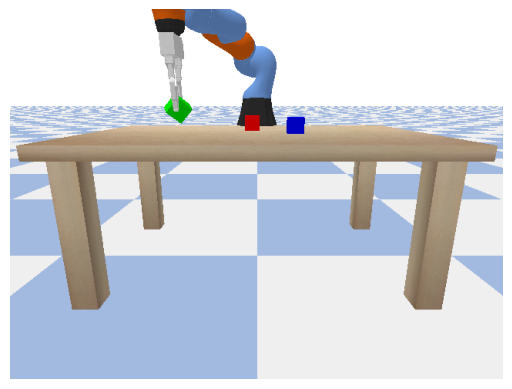

(-0.23983027040958405, 0.3088113069534302, 1.2815442085266113)
run fail
[Reward]: -1
Pick blue


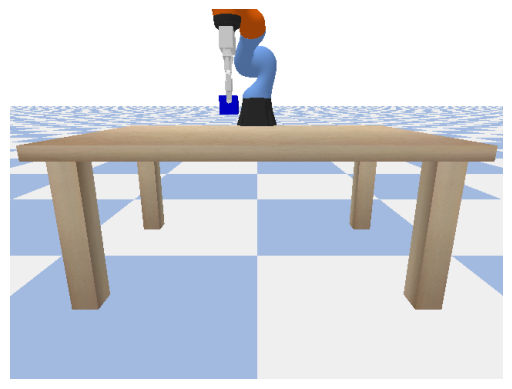

[Reward]: 1
Pick blue


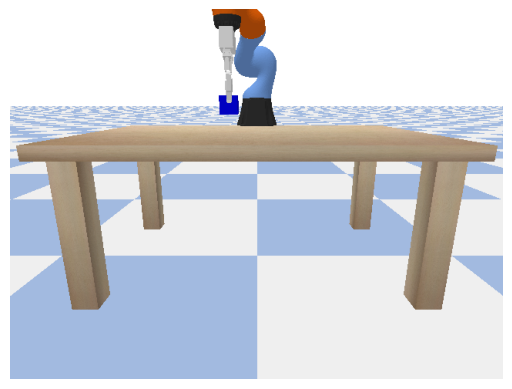

[Reward]: 1
Seize red


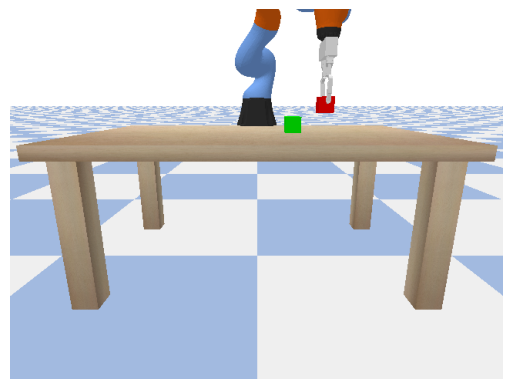

[Reward]: 1
Seize red


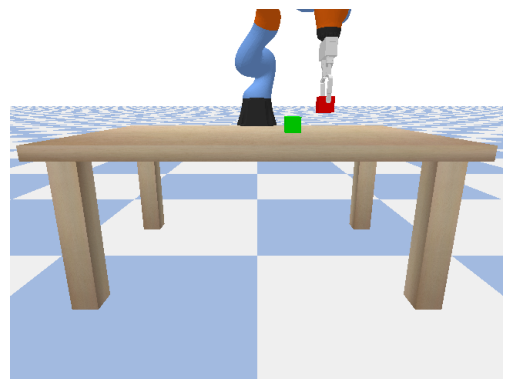

[Reward]: 1
Carry blue


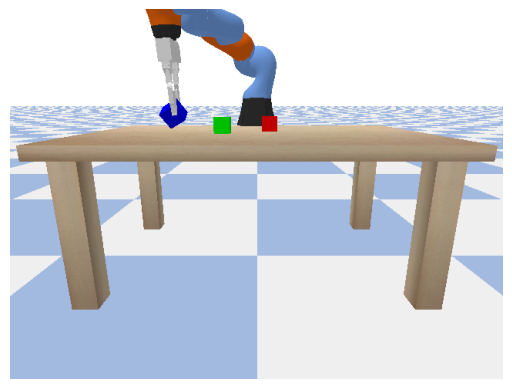

(-0.2319752275943756, 0.3256940543651581, 1.2667171955108643)
run fail
[Reward]: -1
Carry blue


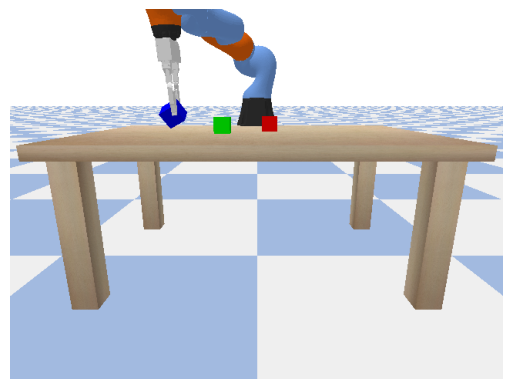

(-0.23196227848529816, 0.32571741938591003, 1.2666895389556885)
run fail
[Reward]: -1
Lift blue


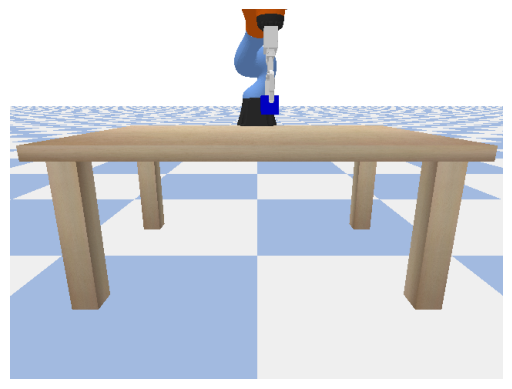

[Reward]: 1
Lift blue


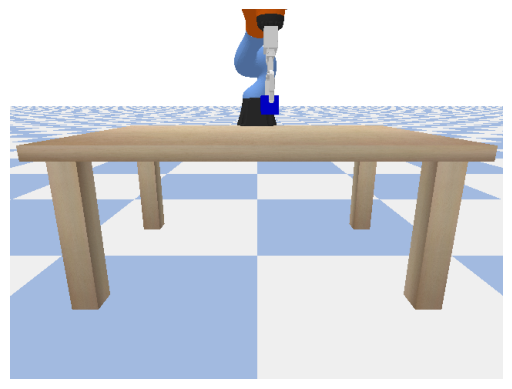

[Reward]: 1
Pick blue


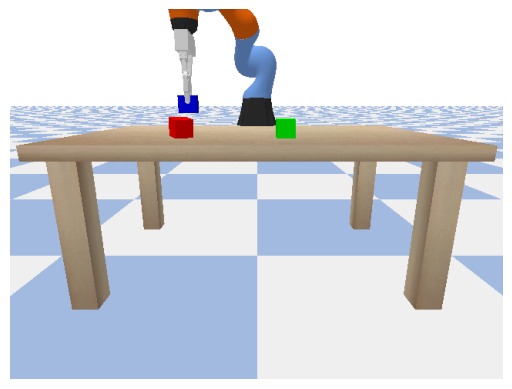

[Reward]: 1
Pick blue


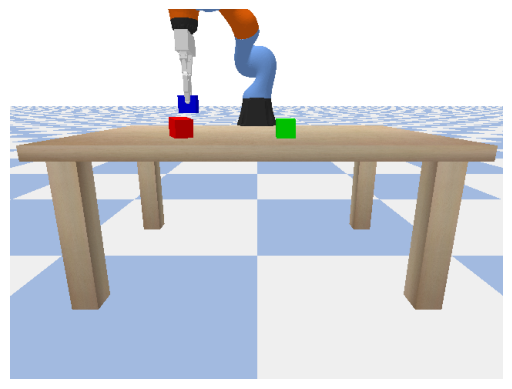

[Reward]: 1
Fetch blue


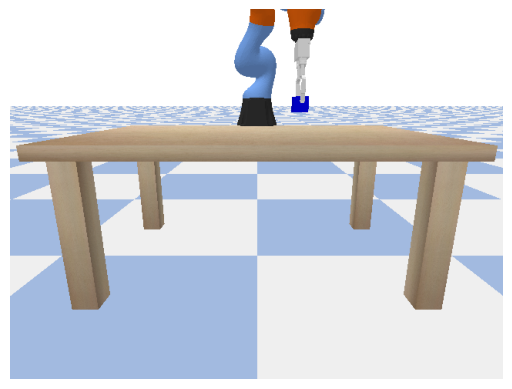

[Reward]: 1
Fetch blue


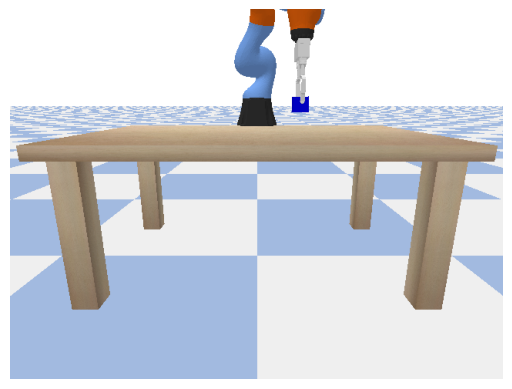

[Reward]: 1
Hold blue


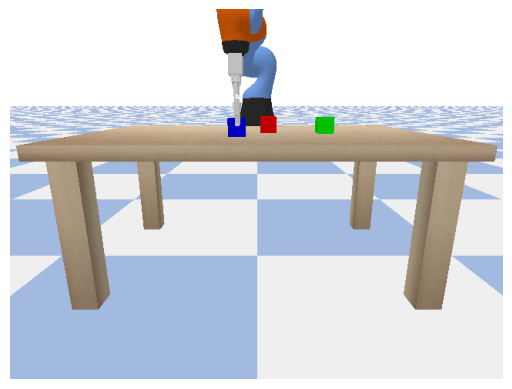

[Reward]: 1
Hold blue


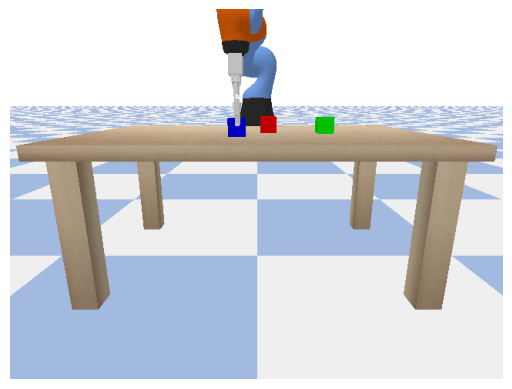

[Reward]: 1
Hoist green


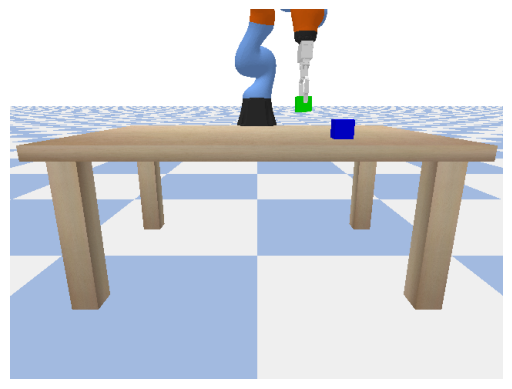

[Reward]: 1
Hoist green


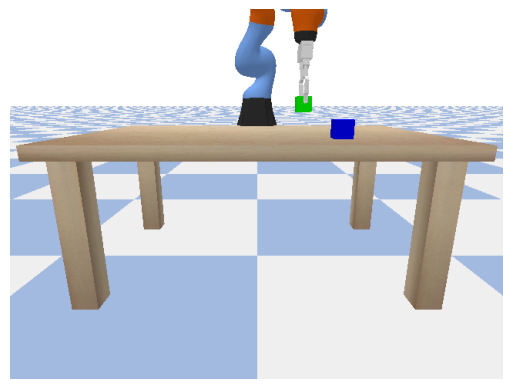

[Reward]: 1
Take green


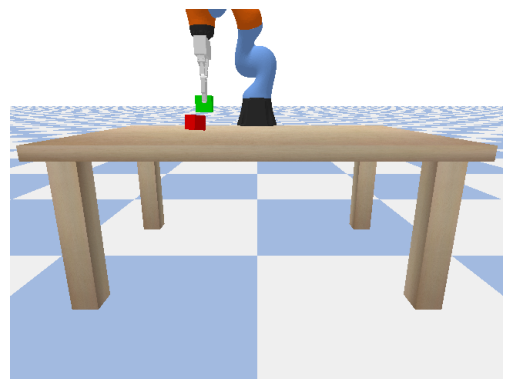

[Reward]: 1
Take green


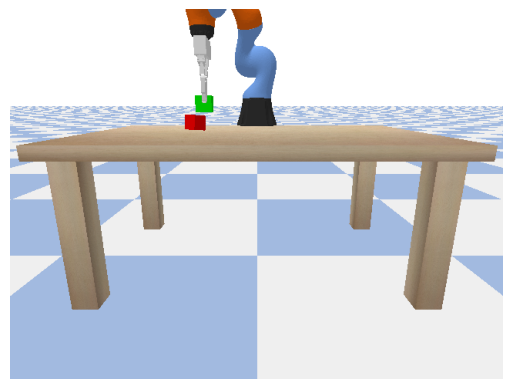

[Reward]: 1
Fetch green


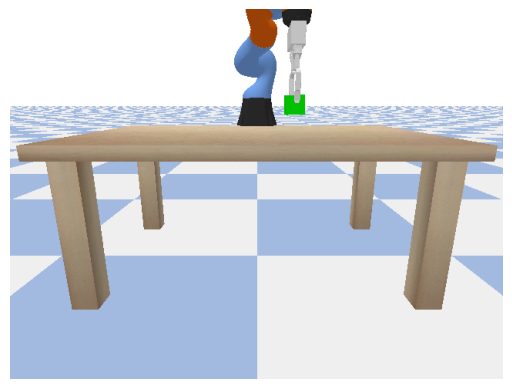

[Reward]: 1
Fetch green


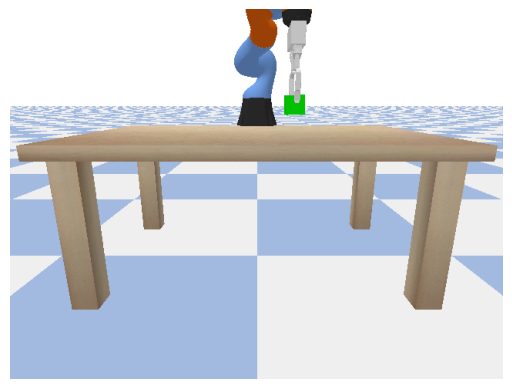

[Reward]: 1
Collect green


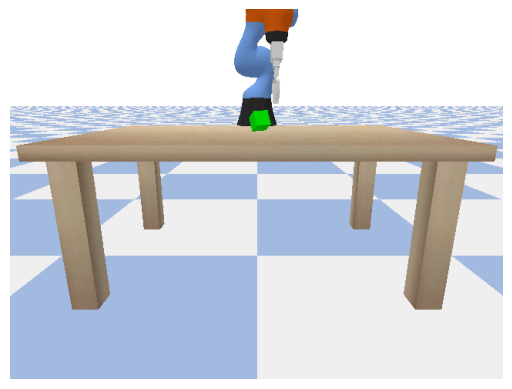

[Reward]: 1
Collect green


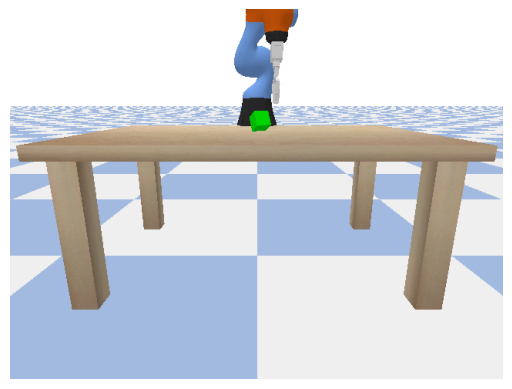

[Reward]: 1
Grab blue


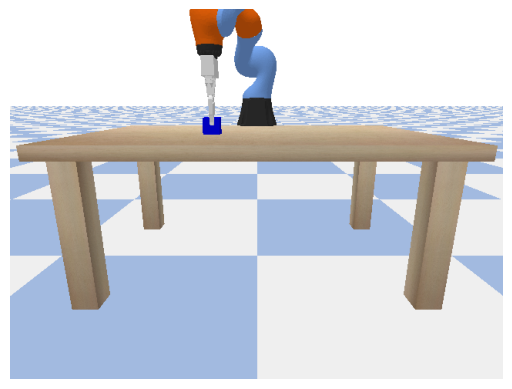

[Reward]: 1
Grab blue


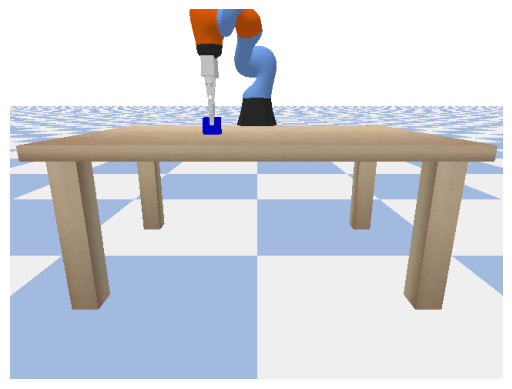

[Reward]: 1
Retrieve green


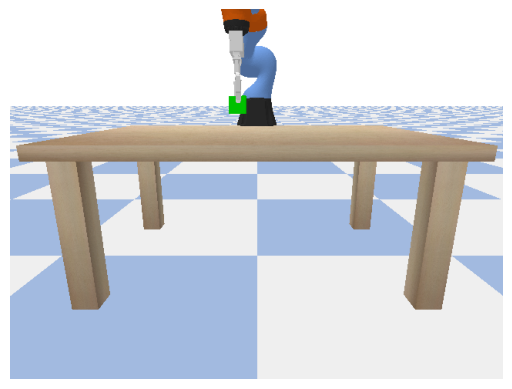

[Reward]: 1
Retrieve green


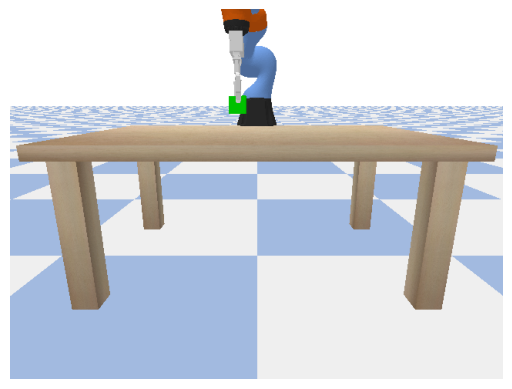

[Reward]: 1
Take green


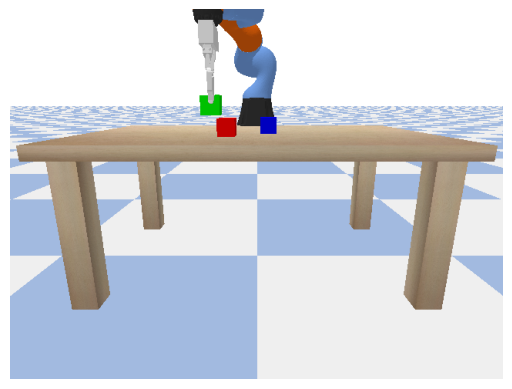

[Reward]: 1
Take green


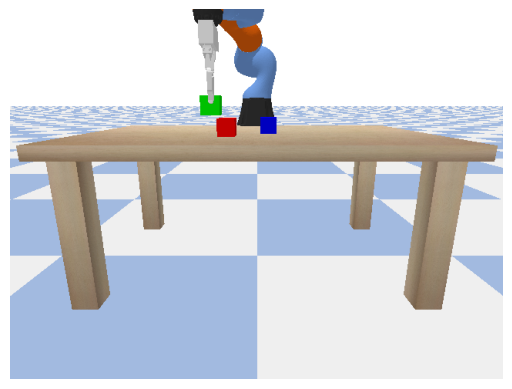

[Reward]: 1
Collect red


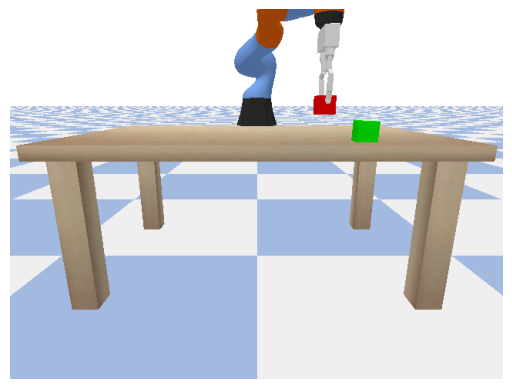

[Reward]: 1
Collect red


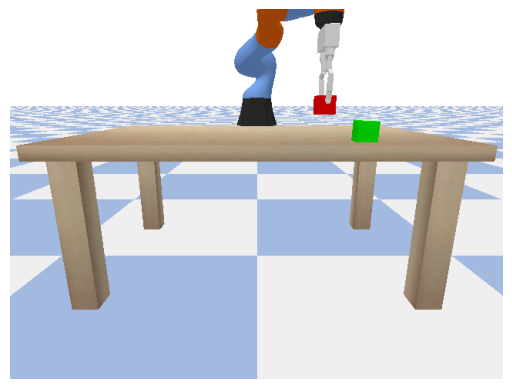

[Reward]: 1
Hoist blue


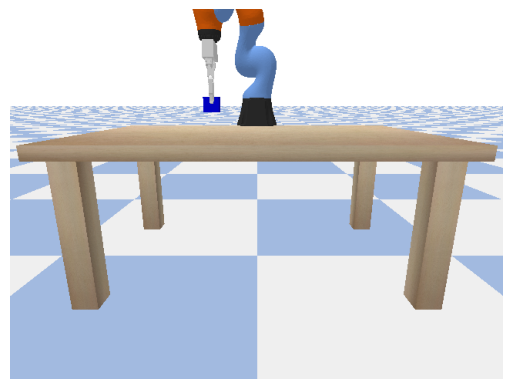

[Reward]: 1
Hoist blue


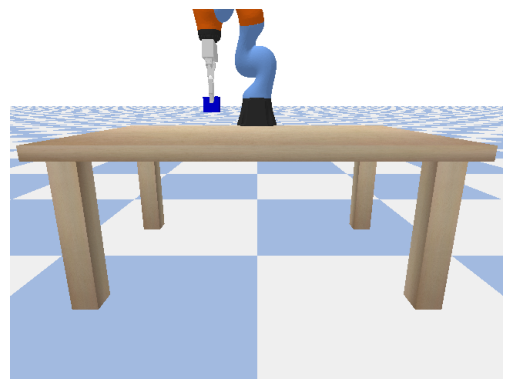

[Reward]: 1
Retrieve green


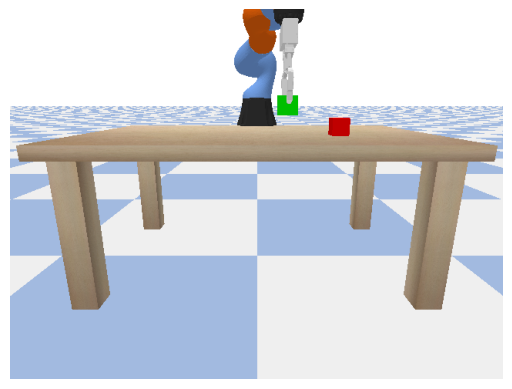

[Reward]: 1
Retrieve green


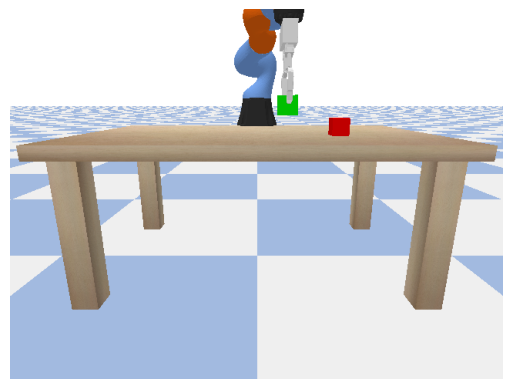

[Reward]: 1
Hold blue


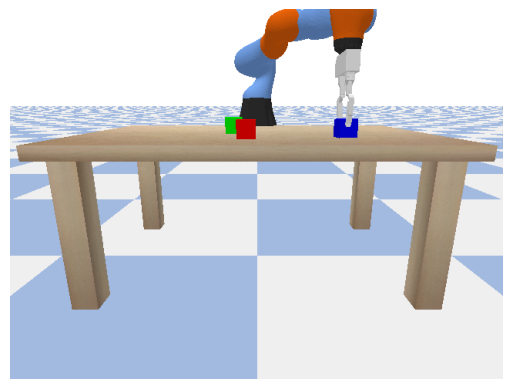

[Reward]: 1
Hold blue


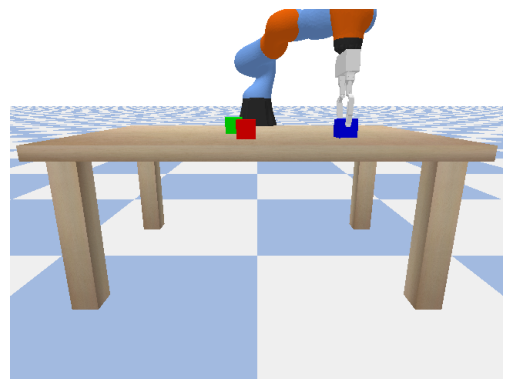

[Reward]: 1
Lift green


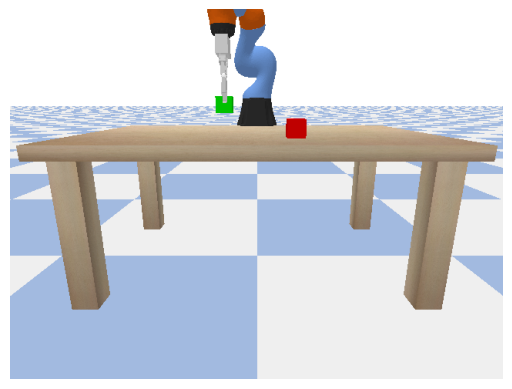

[Reward]: 1
Lift green


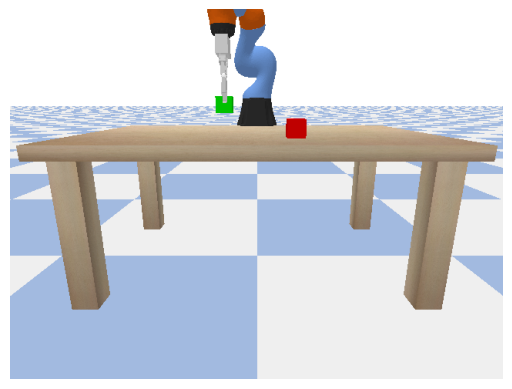

[Reward]: 1
Get red


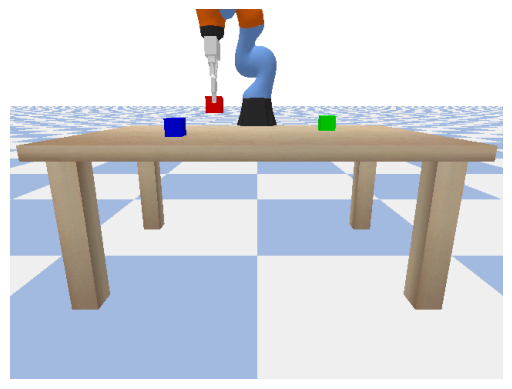

[Reward]: 1
Get red


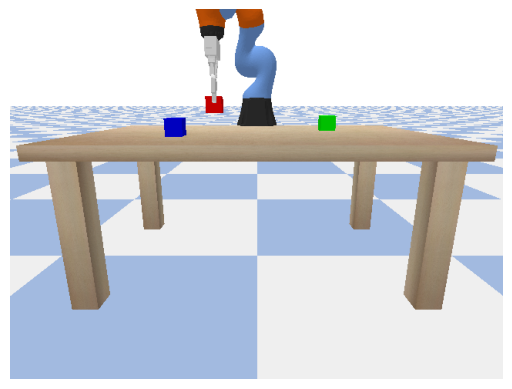

[Reward]: 1
Seize red


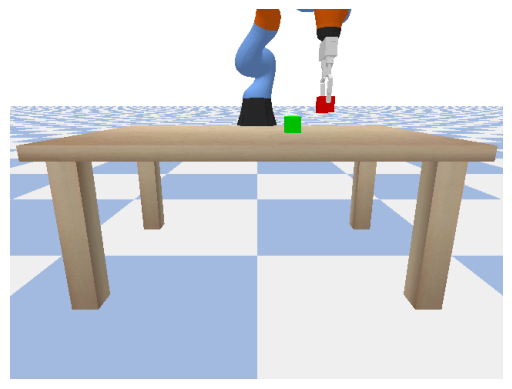

[Reward]: 1
Seize red


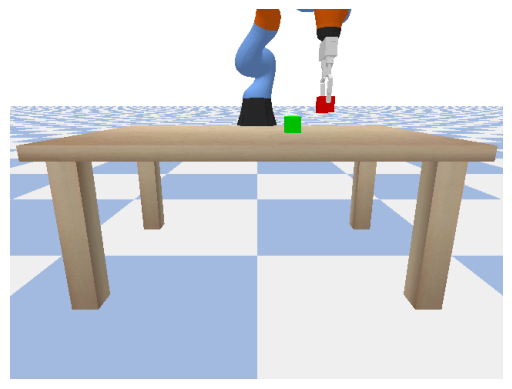

[Reward]: 1
Carry blue


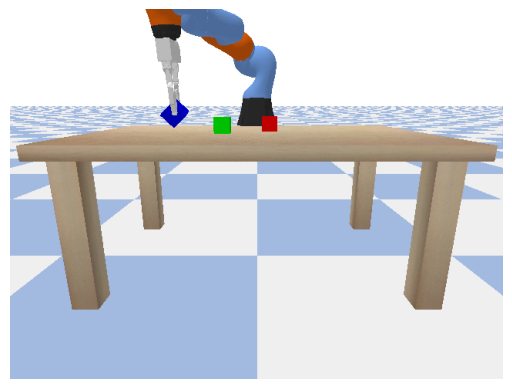

(-0.2319604903459549, 0.3257146179676056, 1.2666535377502441)
run fail
[Reward]: -1
Carry blue


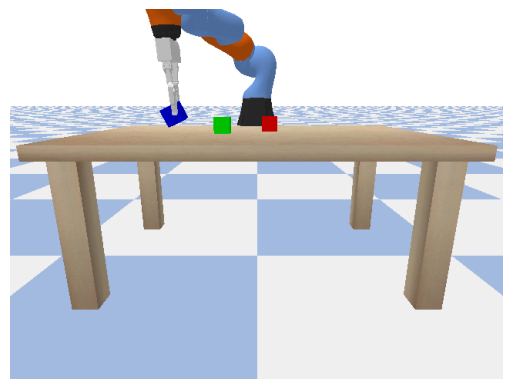

(-0.2319716364145279, 0.3256995379924774, 1.2666716575622559)
run fail
[Reward]: -1
Raise blue


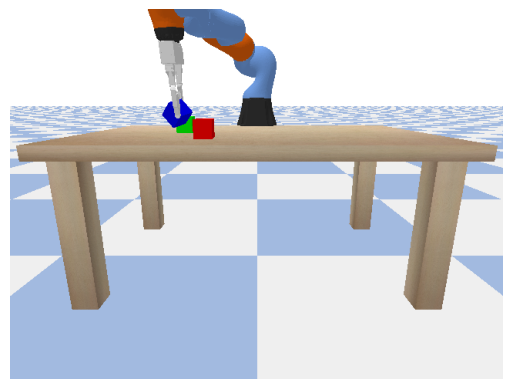

(-0.23641645908355713, 0.31455397605895996, 1.2584782838821411)
run fail
[Reward]: -1
Raise blue


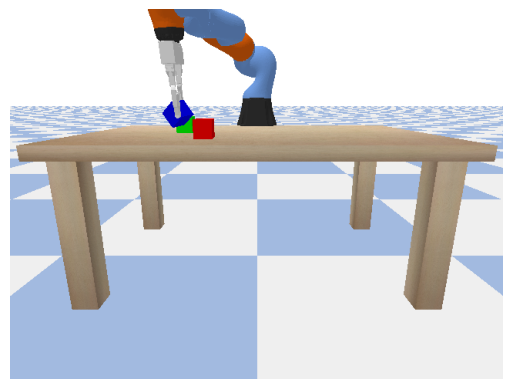

(-0.2364117056131363, 0.314561665058136, 1.258469581604004)
run fail
[Reward]: -1
Fetch green


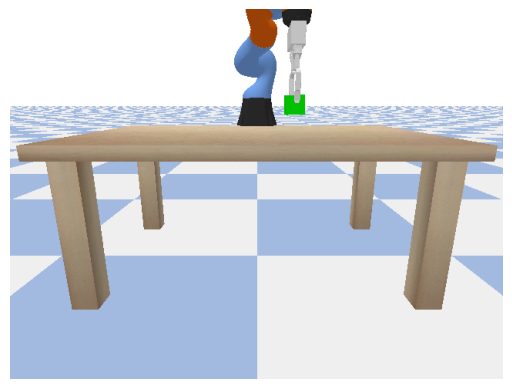

[Reward]: 1
Fetch green


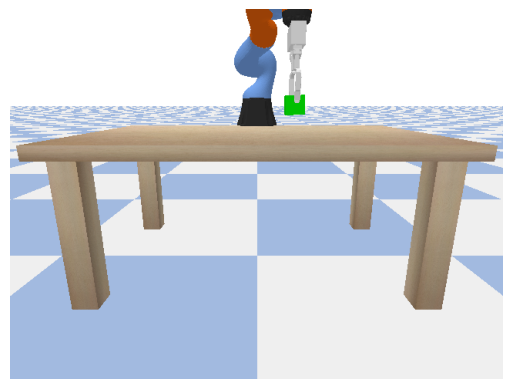

[Reward]: 1
Pick blue


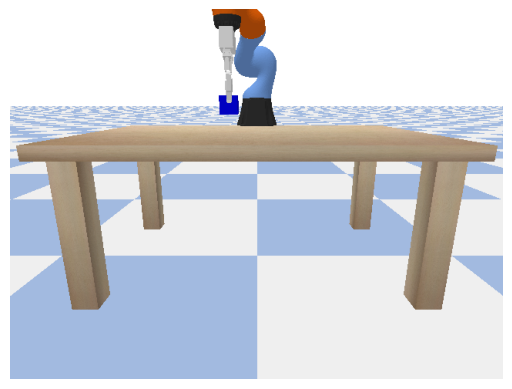

[Reward]: 1
Pick blue


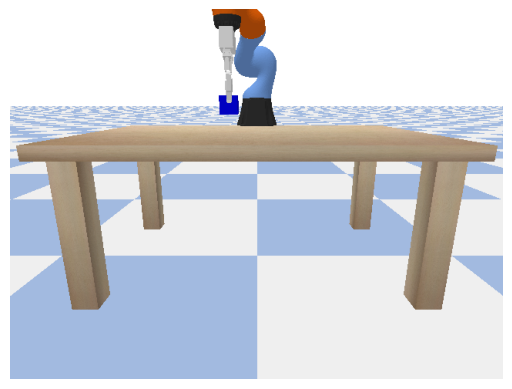

[Reward]: 1
Retrieve green


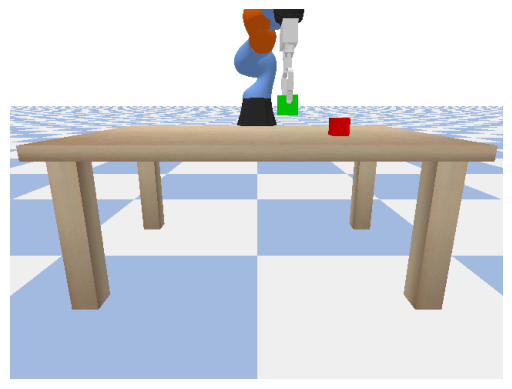

[Reward]: 1
Retrieve green


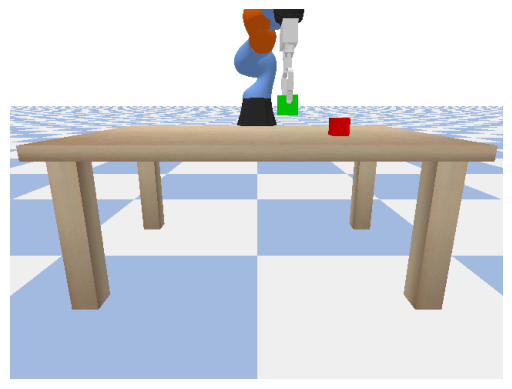

[Reward]: 1
Get red


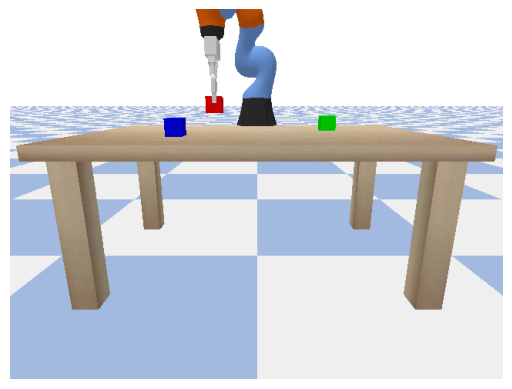

[Reward]: 1
Get red


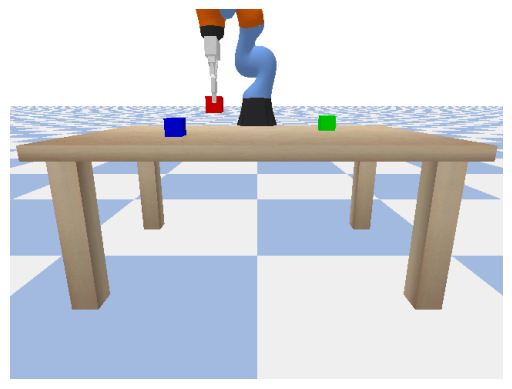

[Reward]: 1
Lift blue


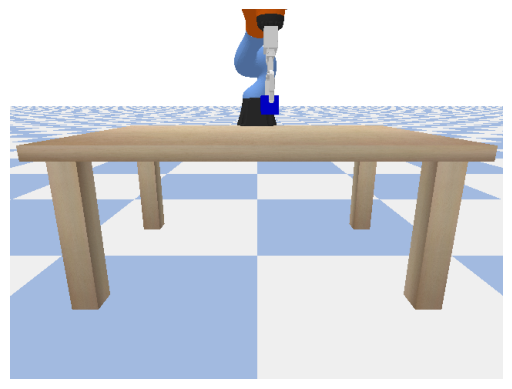

[Reward]: 1
Lift blue


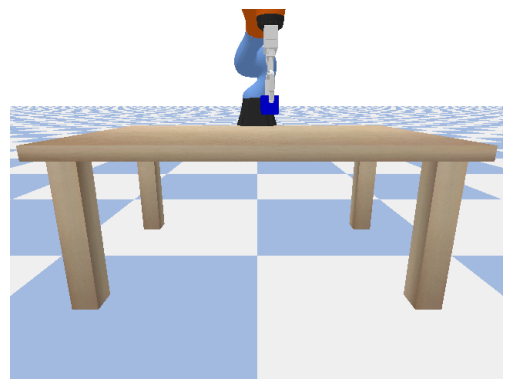

[Reward]: 1
Carry blue


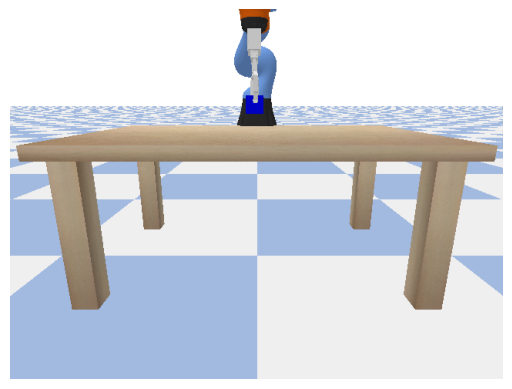

[Reward]: 1
Carry blue


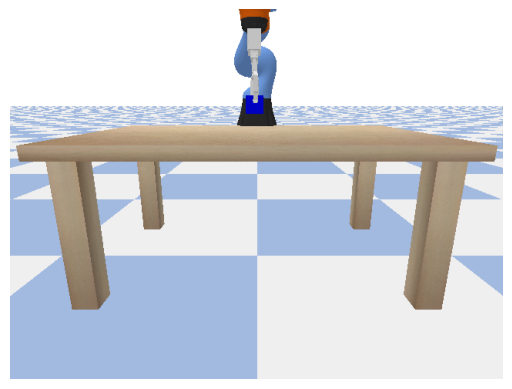

[Reward]: 1
Grasp green


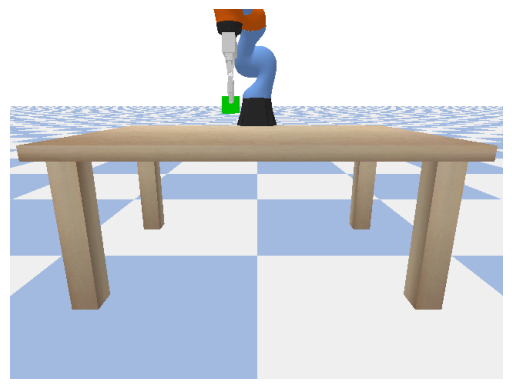

[Reward]: 1
Grasp green


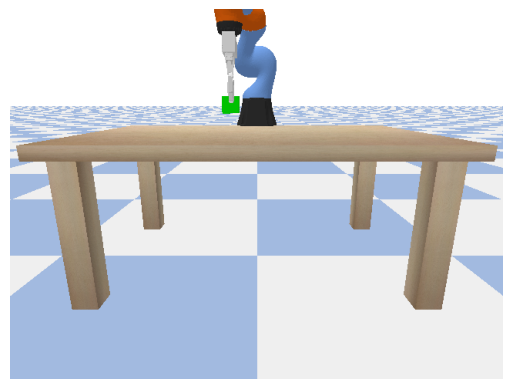

[Reward]: 1
Collect green


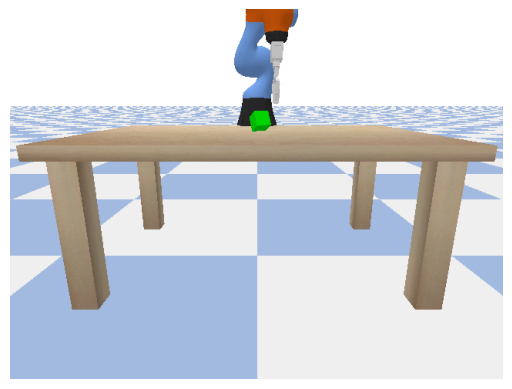

[Reward]: 1
Collect green


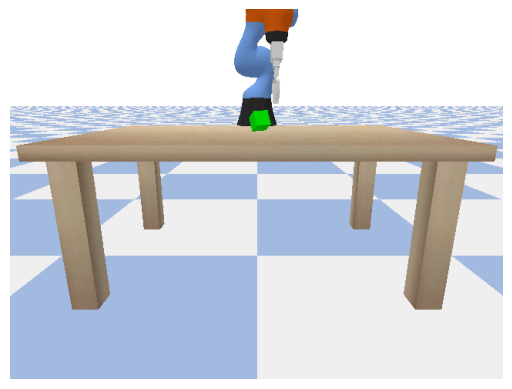

[Reward]: 1
Acquire blue


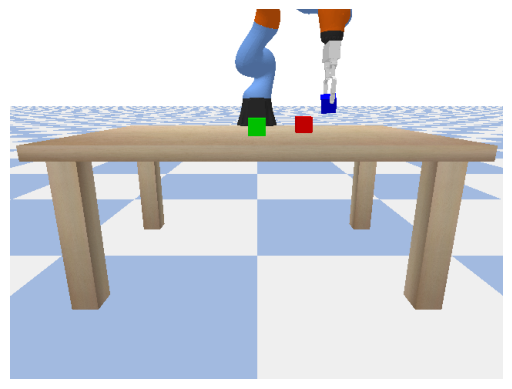

[Reward]: 1
Acquire blue


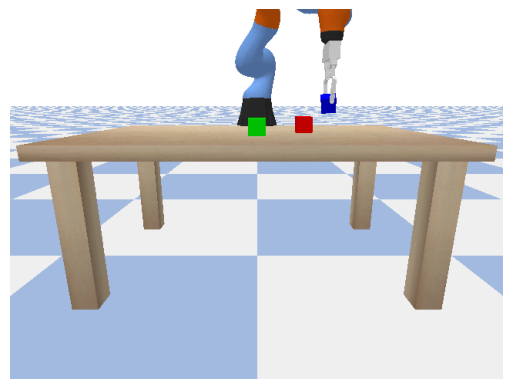

[Reward]: 1
Seize blue


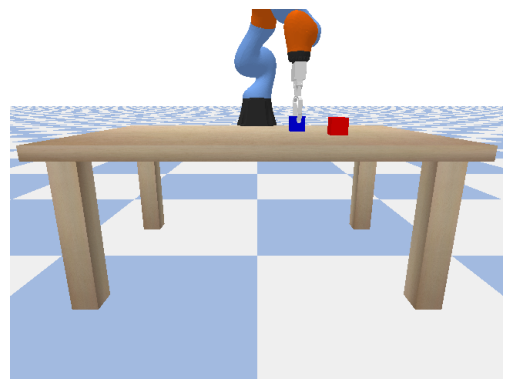

[Reward]: 1
Seize blue


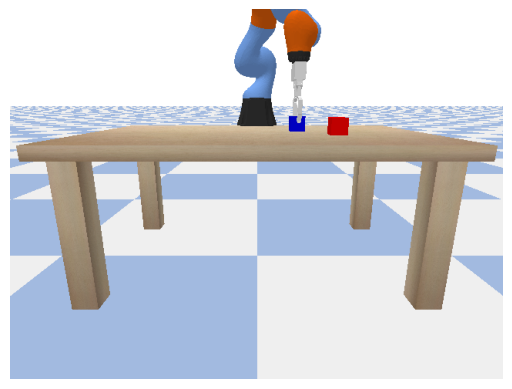

[Reward]: 1
Collect red


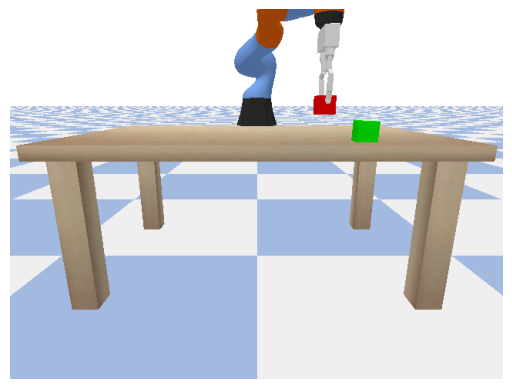

[Reward]: 1
Collect red


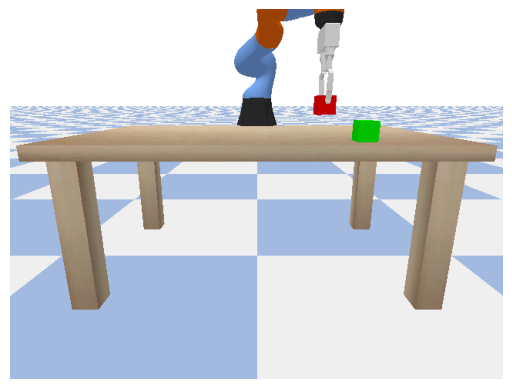

[Reward]: 1
Acquire green


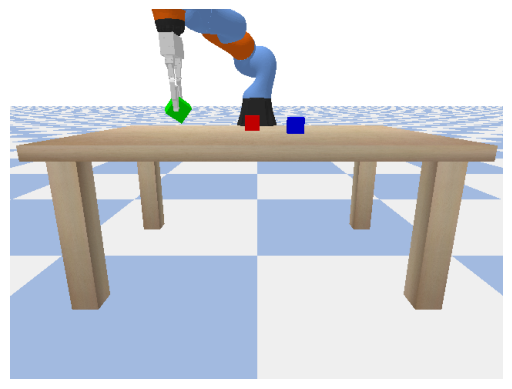

(-0.23982968926429749, 0.3088134825229645, 1.2815446853637695)
run fail
[Reward]: -1
Acquire green


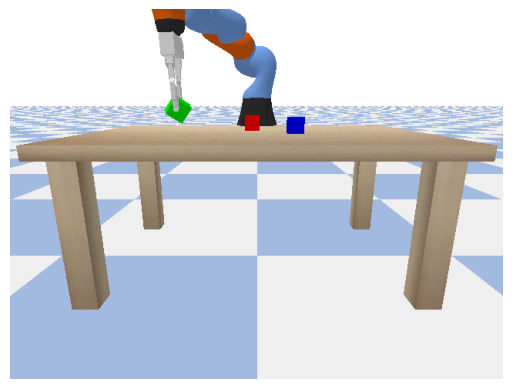

(-0.2398308962583542, 0.30881252884864807, 1.2815488576889038)
run fail
[Reward]: -1
Grab blue


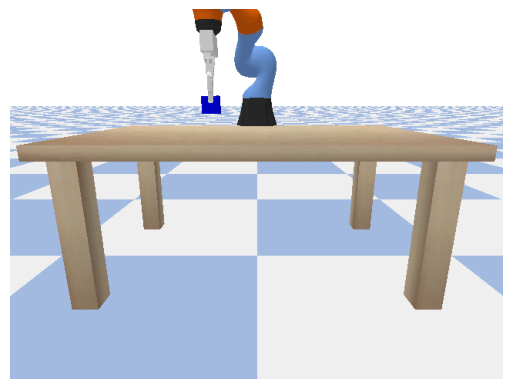

[Reward]: 1
Grab blue


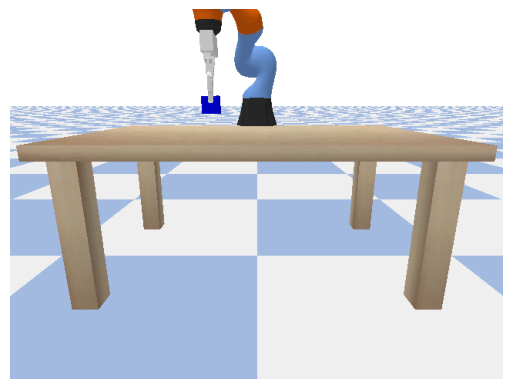

[Reward]: 1
Raise green


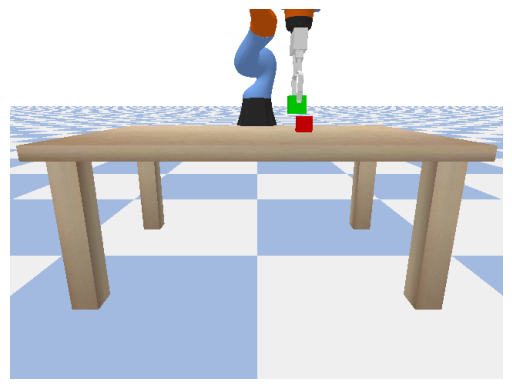

[Reward]: 1
Raise green


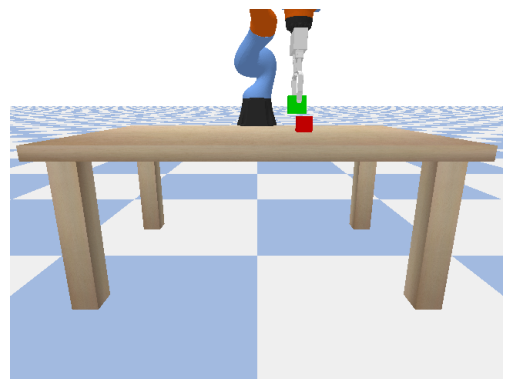

[Reward]: 0
Take green


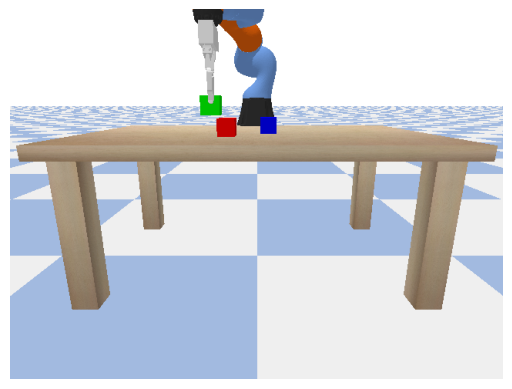

[Reward]: 1
Take green


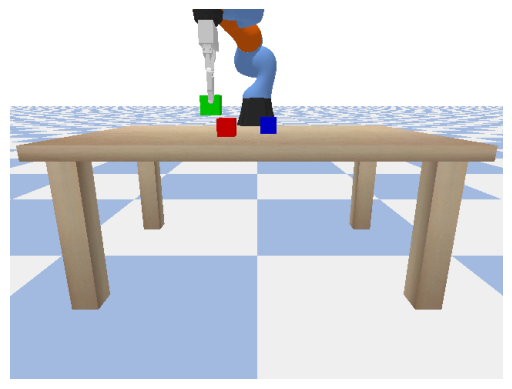

[Reward]: 1
Hold blue


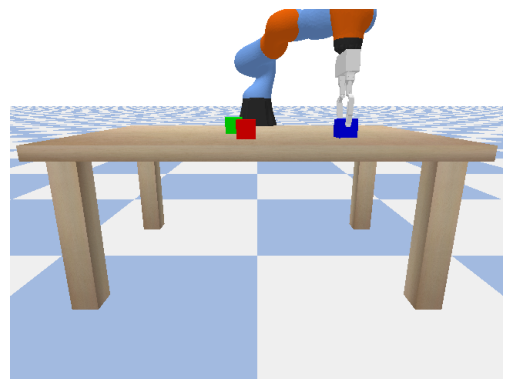

[Reward]: 1
Hold blue


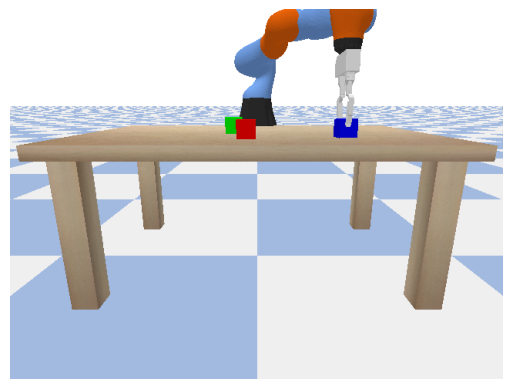

[Reward]: 1
Grab green


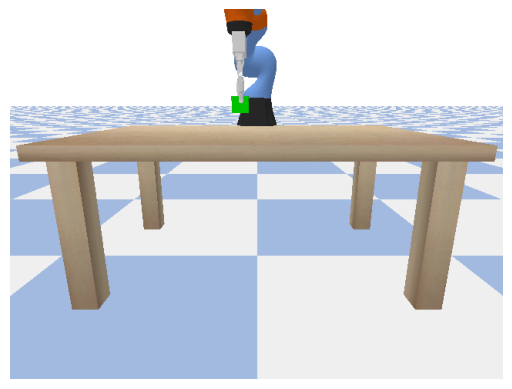

[Reward]: 1
Grab green


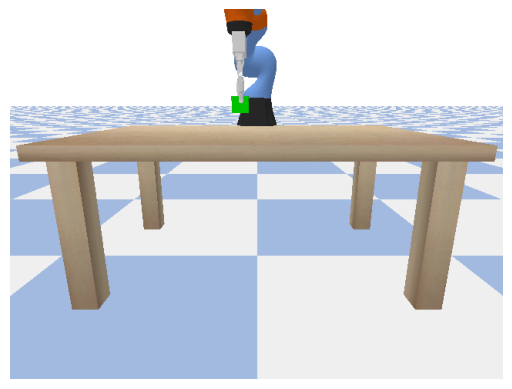

[Reward]: 1
Take green


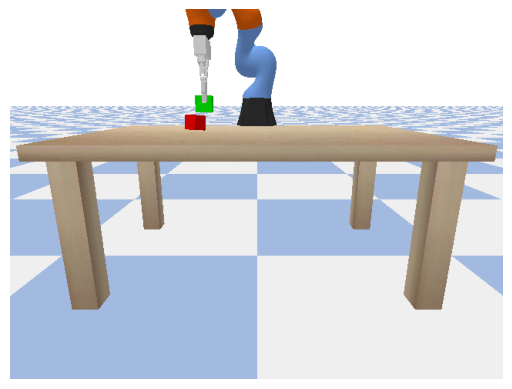

[Reward]: 0
Take green


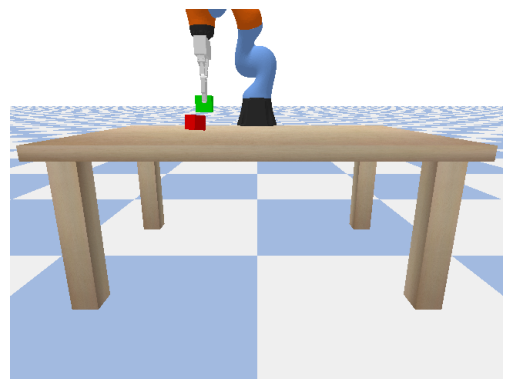

[Reward]: 1
Get green


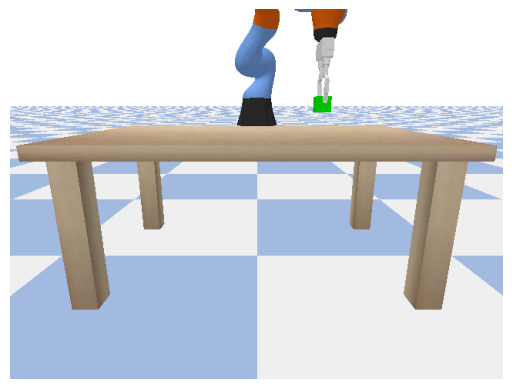

[Reward]: 1
Get green


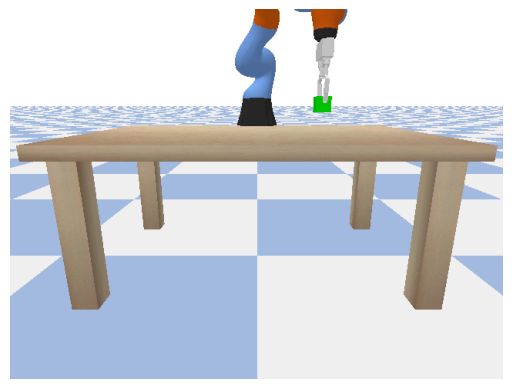

[Reward]: 1
Retrieve green


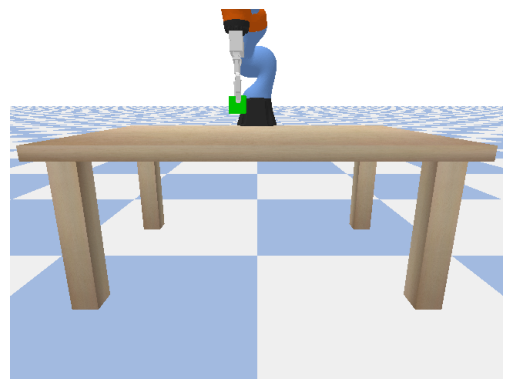

[Reward]: 1
Retrieve green


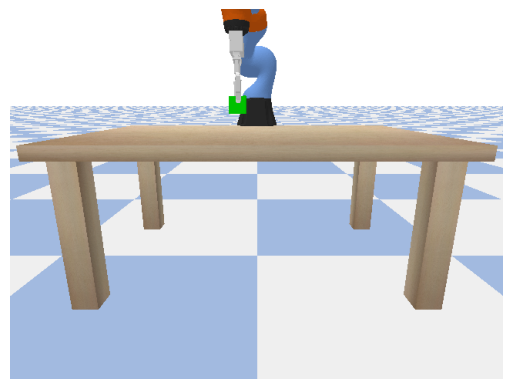

[Reward]: 1
Hold blue


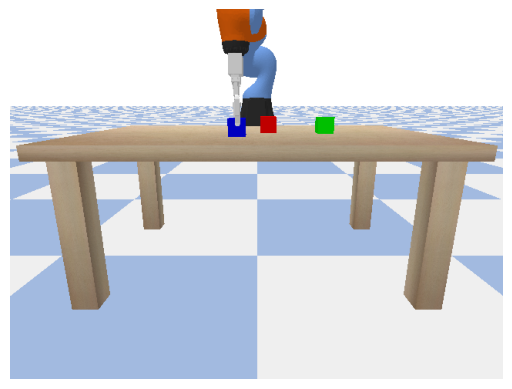

[Reward]: 1
Hold blue


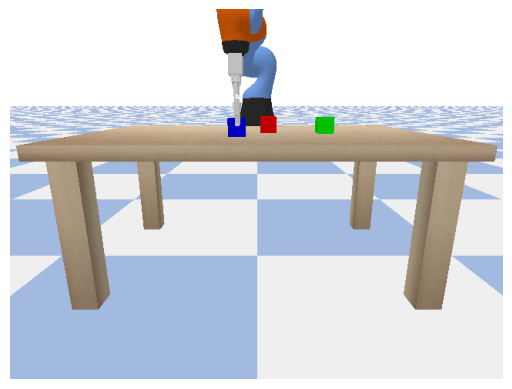

[Reward]: 1
Pick blue


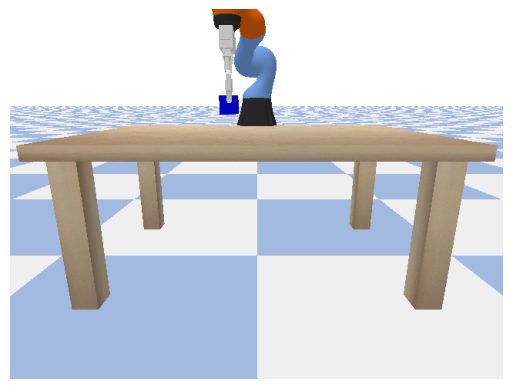

[Reward]: 1
Pick blue


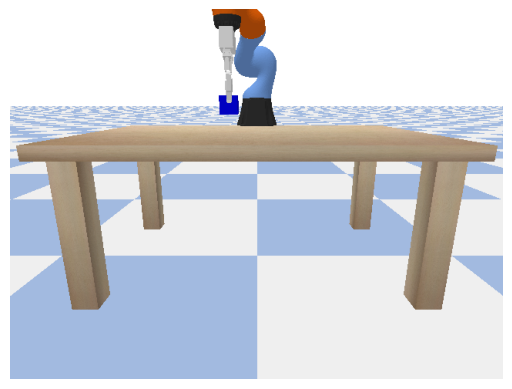

[Reward]: 1
Lift green


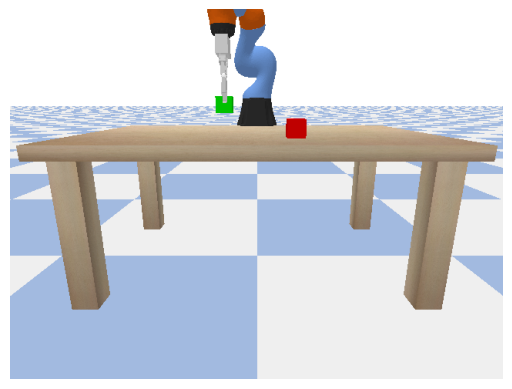

[Reward]: 1
Lift green


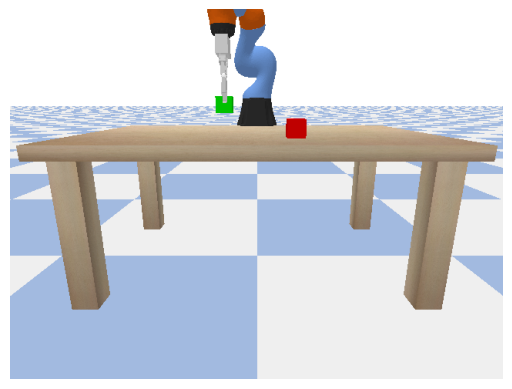

[Reward]: 1
Take green


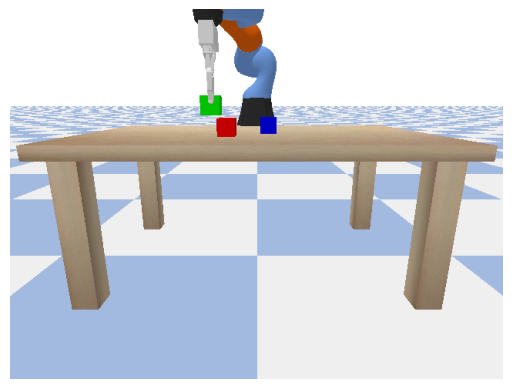

[Reward]: 1
Take green


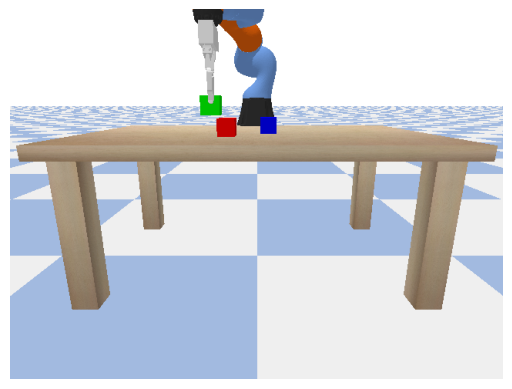

[Reward]: 1
Lift blue


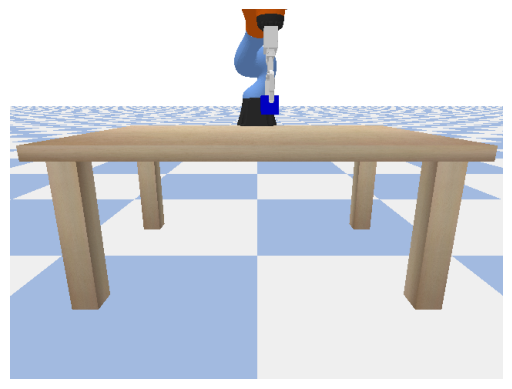

[Reward]: 1
Lift blue


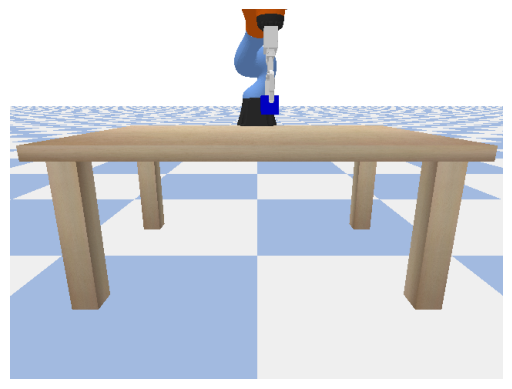

[Reward]: 1
Fetch blue


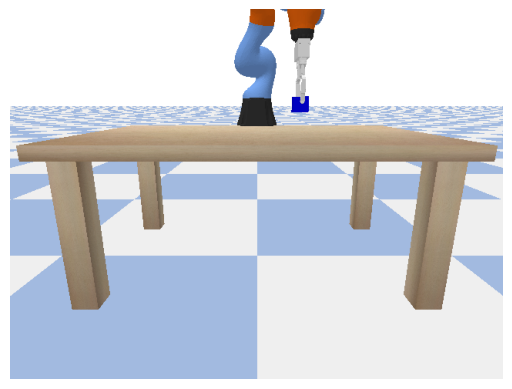

[Reward]: 1
Fetch blue


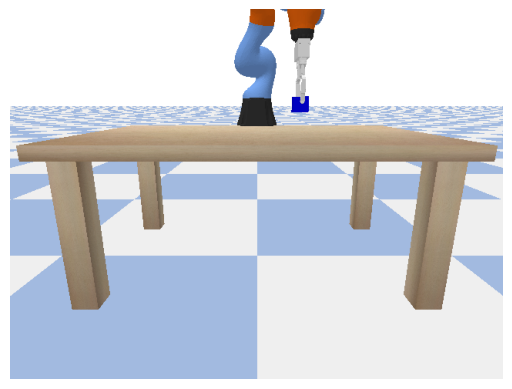

[Reward]: 1
Carry blue


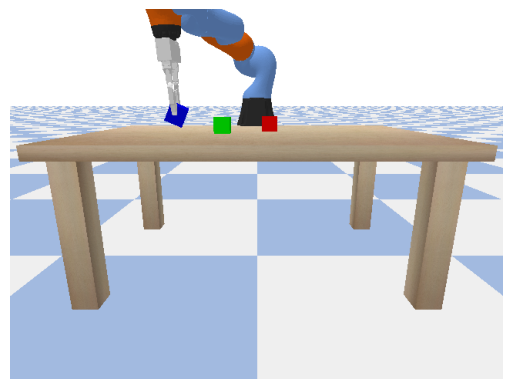

(-0.23195452988147736, 0.32574334740638733, 1.2666964530944824)
run fail
[Reward]: -1
Carry blue


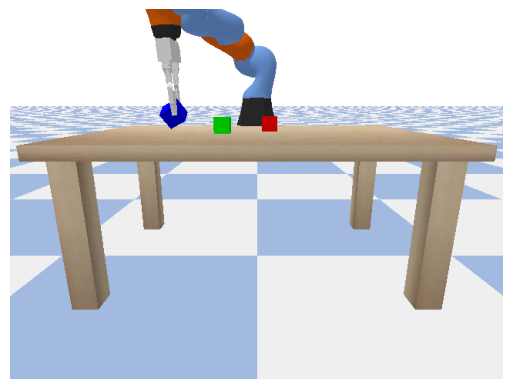

(-0.23197686672210693, 0.3256897032260895, 1.2667027711868286)
run fail
[Reward]: -1
Raise green


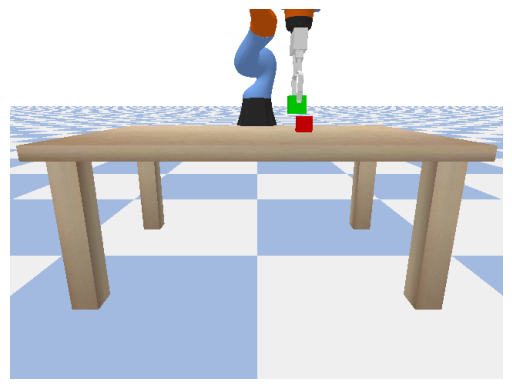

[Reward]: 1
Raise green


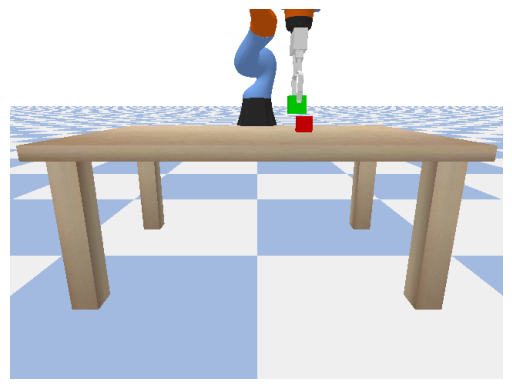

[Reward]: 1
Collect green


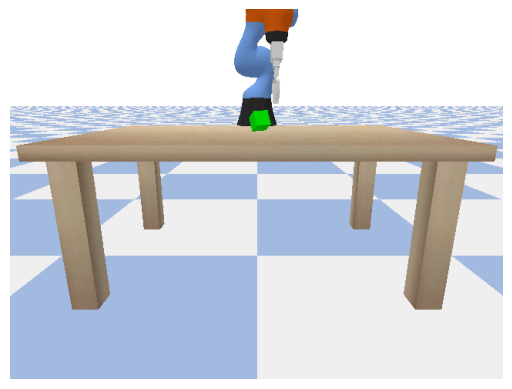

[Reward]: 1
Collect green


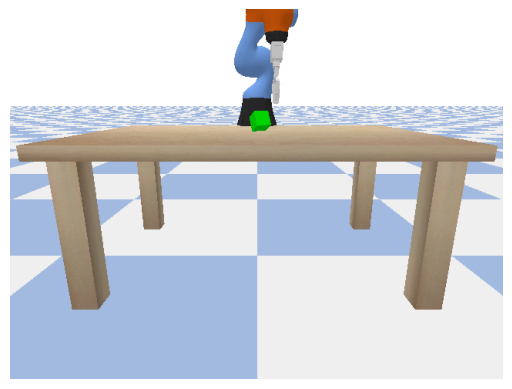

[Reward]: 1
Seize red


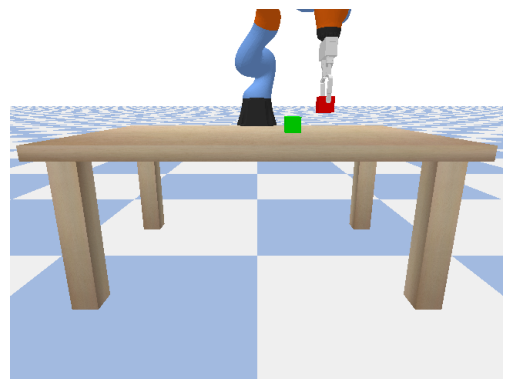

[Reward]: 1
Seize red


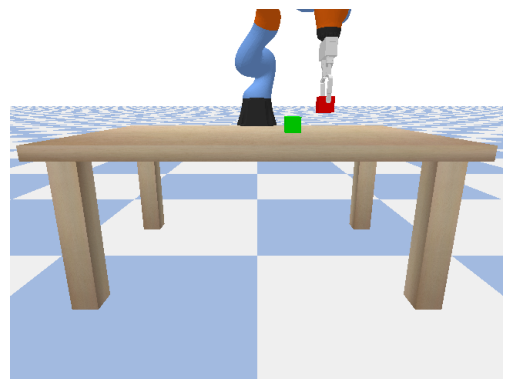

[Reward]: 1
Acquire blue


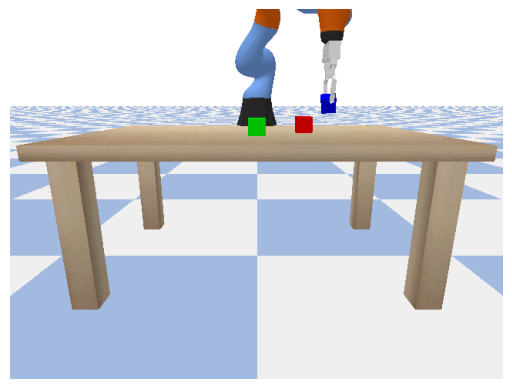

[Reward]: 1
Acquire blue


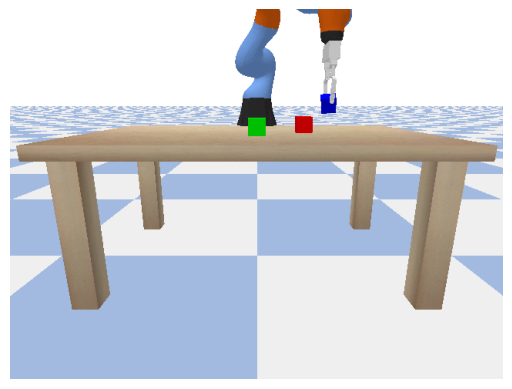

[Reward]: 1
Take green


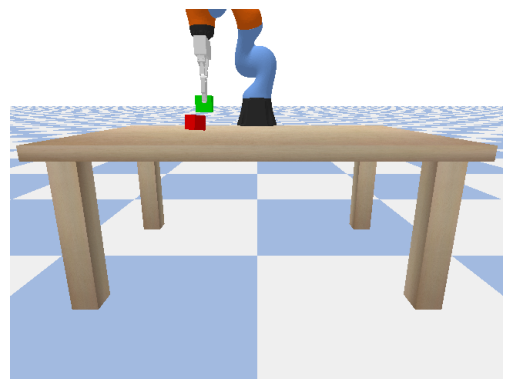

[Reward]: 1
Take green


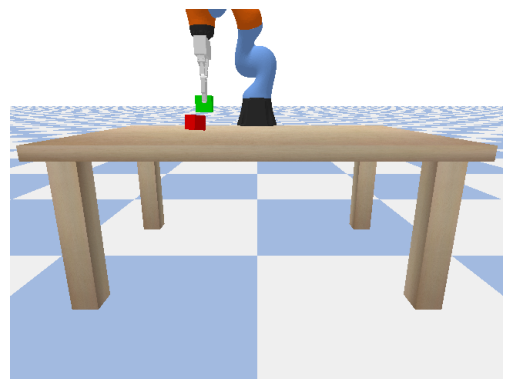

[Reward]: 1
Grab blue


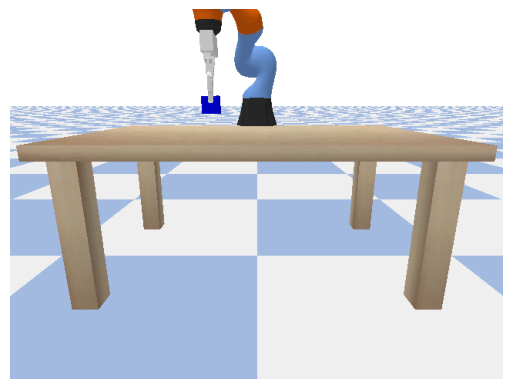

[Reward]: 1
Grab blue


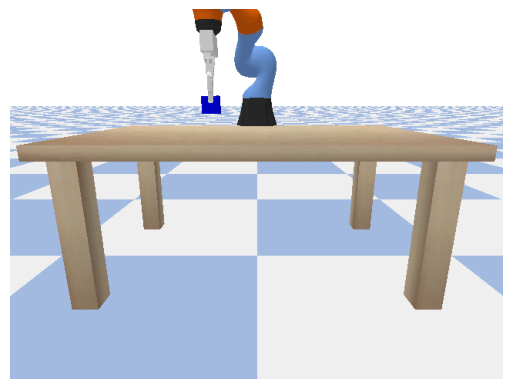

[Reward]: 1
Acquire green


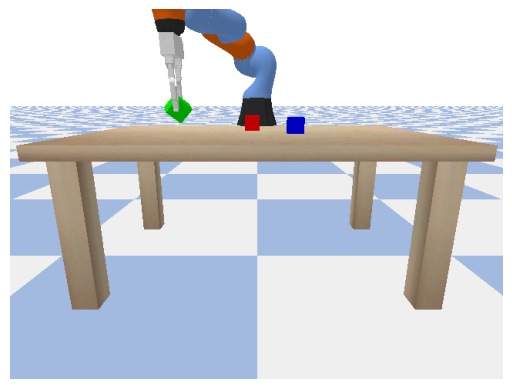

(-0.23983043432235718, 0.3088110387325287, 1.2815446853637695)
run fail
[Reward]: -1
Acquire green


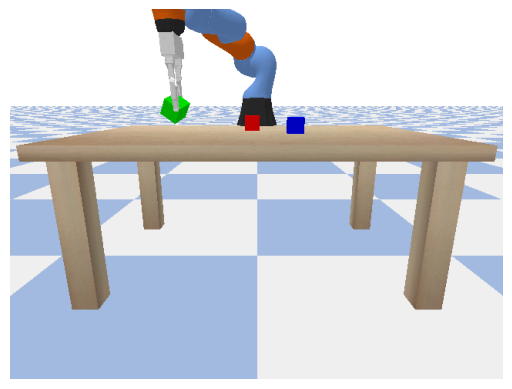

(-0.23985610902309418, 0.30874958634376526, 1.2815172672271729)
run fail
[Reward]: -1
Hold blue


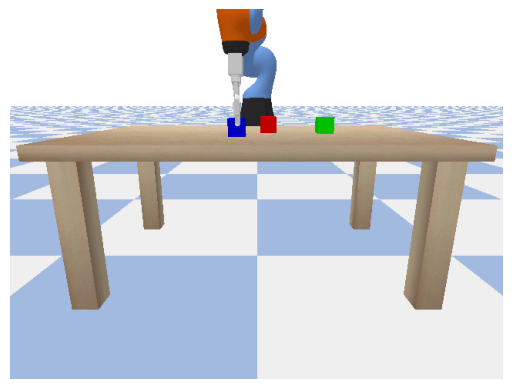

[Reward]: 1
Hold blue


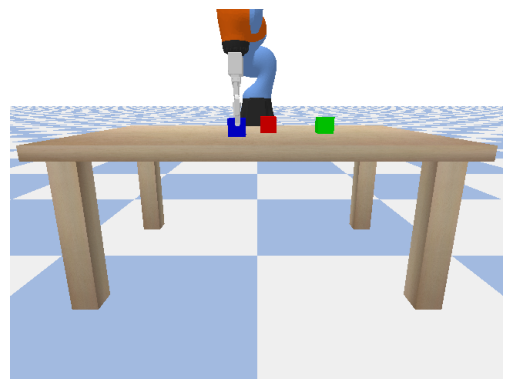

[Reward]: 1
Fetch green


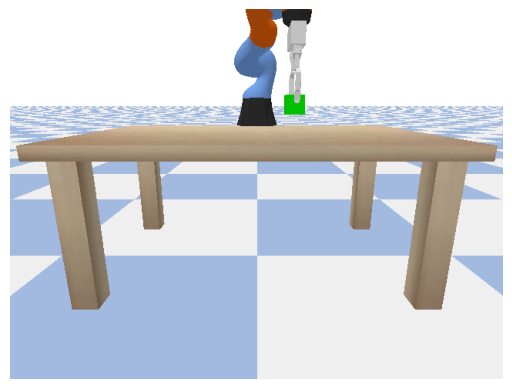

[Reward]: 1
Fetch green


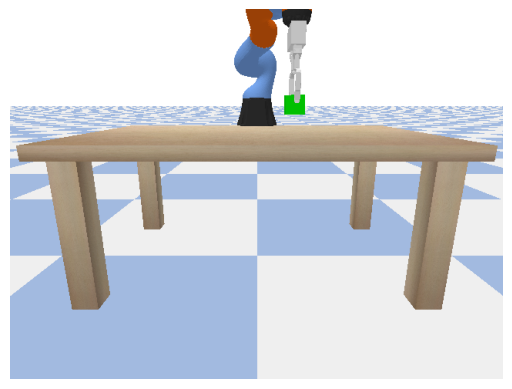

[Reward]: 1
Carry blue


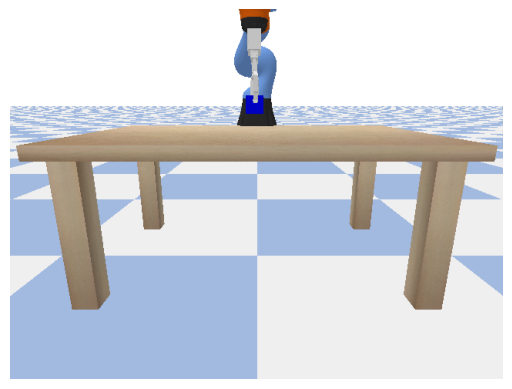

[Reward]: 1
Carry blue


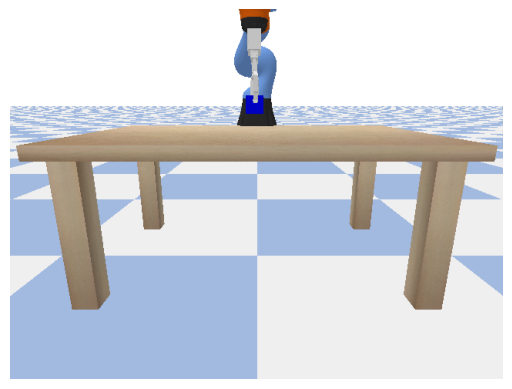

[Reward]: 1
Grab green


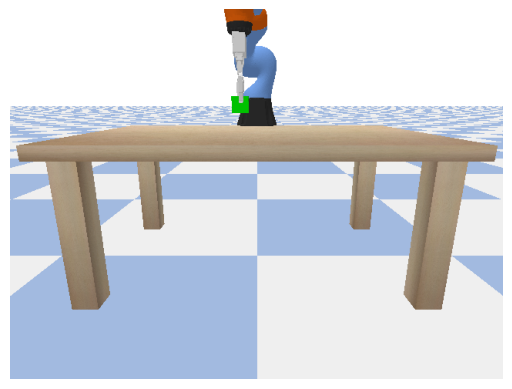

[Reward]: 1
Grab green


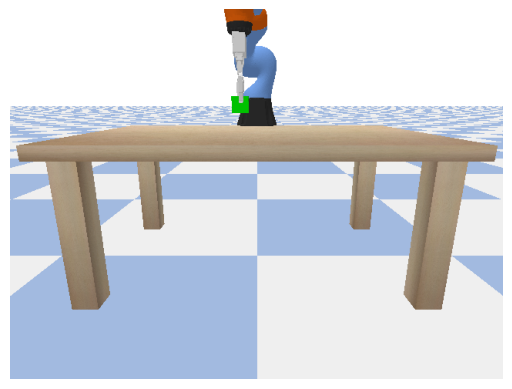

[Reward]: 1
Seize blue


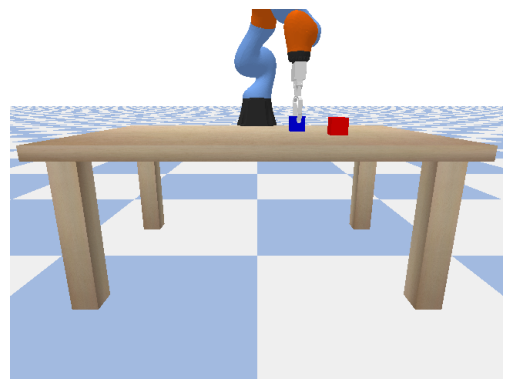

[Reward]: 1
Seize blue


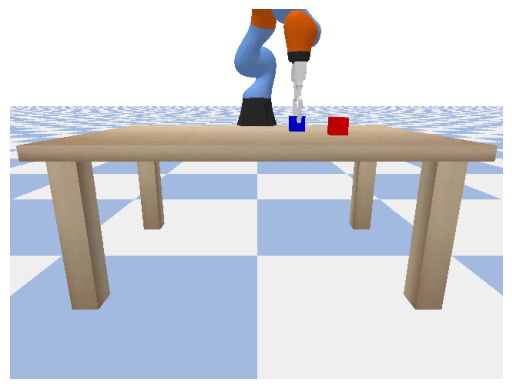

[Reward]: 1
Retrieve green


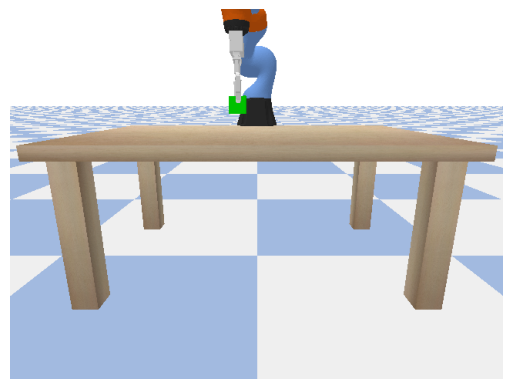

[Reward]: 1
Retrieve green


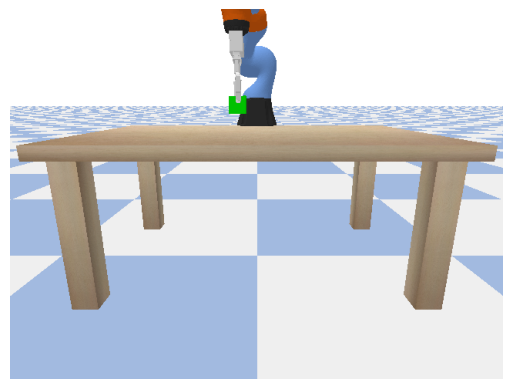

[Reward]: 1
Pick blue


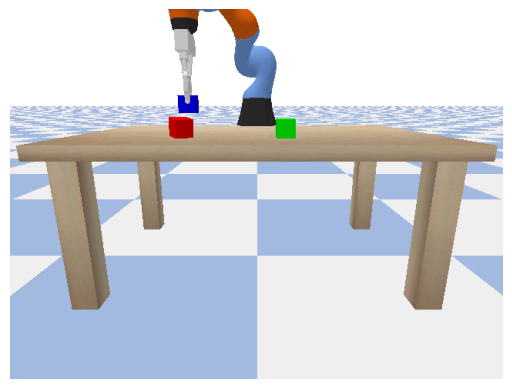

[Reward]: 1
Pick blue


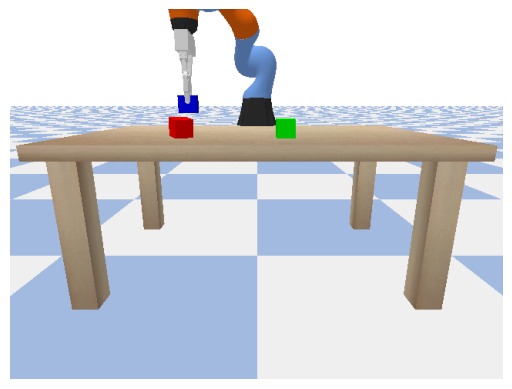

[Reward]: 1
Hold blue


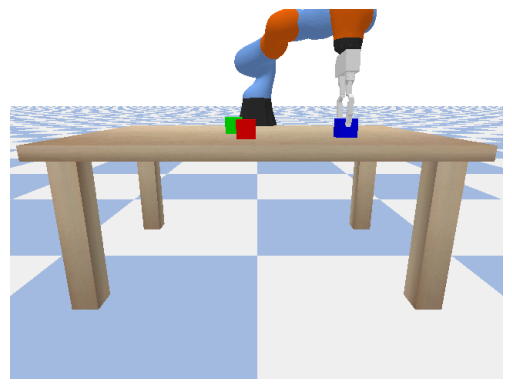

[Reward]: 1
Hold blue


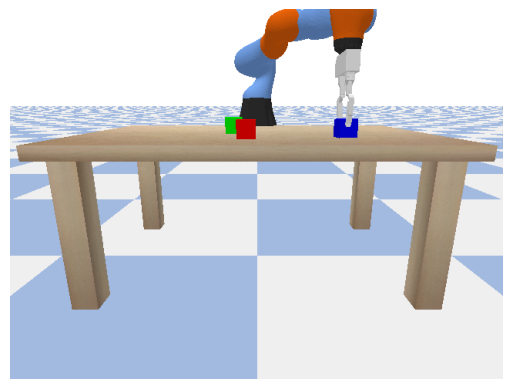

[Reward]: 1
Retrieve green


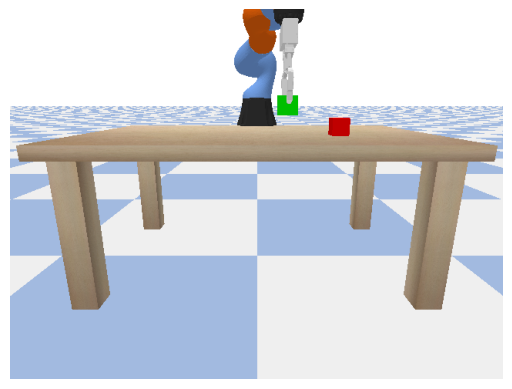

[Reward]: 1
Retrieve green


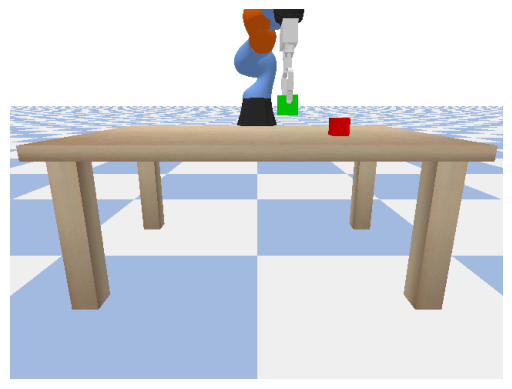

[Reward]: 1
Hoist green


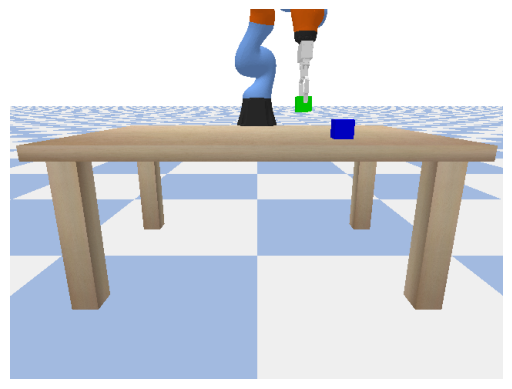

[Reward]: 1
Hoist green


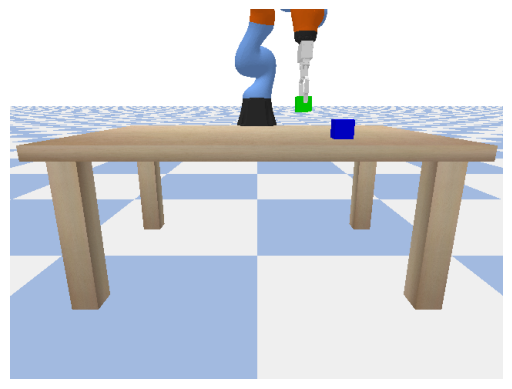

[Reward]: 1
Hoist blue


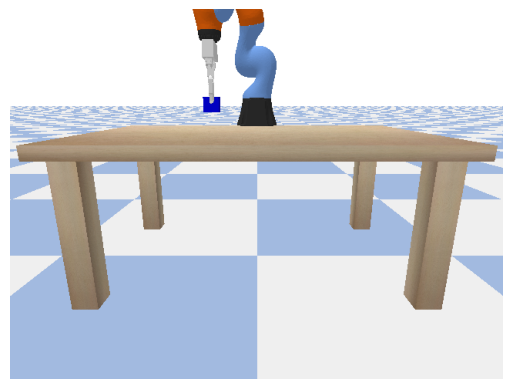

[Reward]: 1
Hoist blue


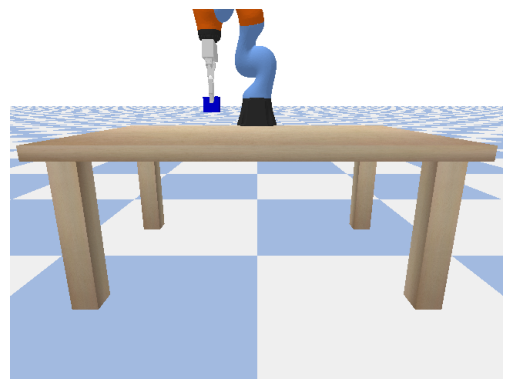

[Reward]: 1
Carry blue


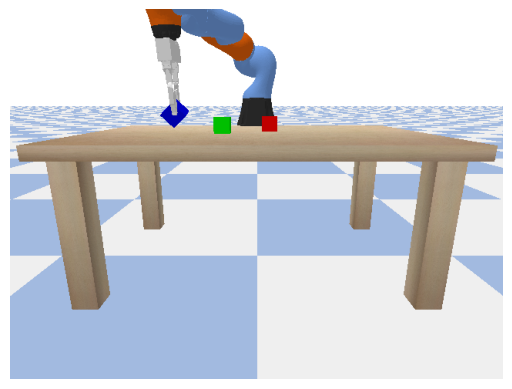

(-0.23196038603782654, 0.32571467757225037, 1.266653060913086)
run fail
[Reward]: -1
Carry blue


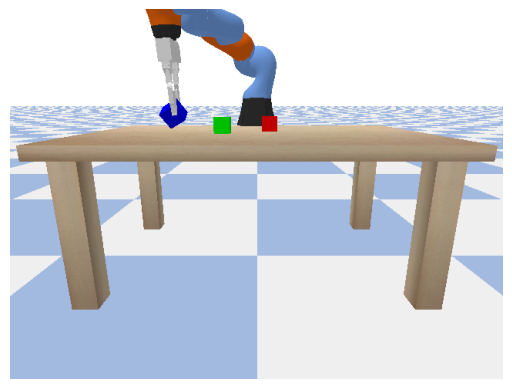

(-0.2319752424955368, 0.3256940245628357, 1.266717553138733)
run fail
[Reward]: -1
Acquire blue


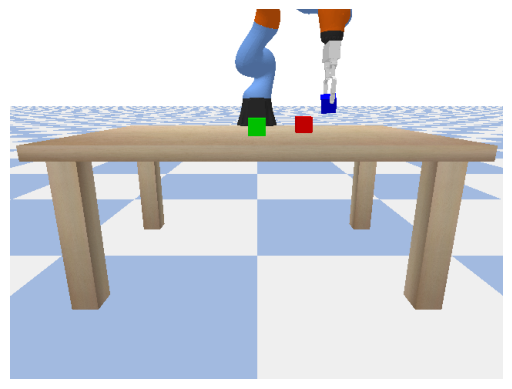

[Reward]: 1
Acquire blue


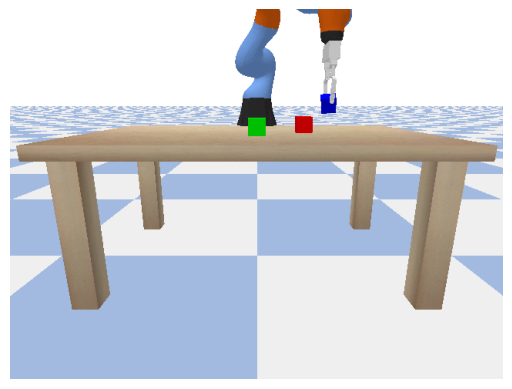

[Reward]: 1
Retrieve green


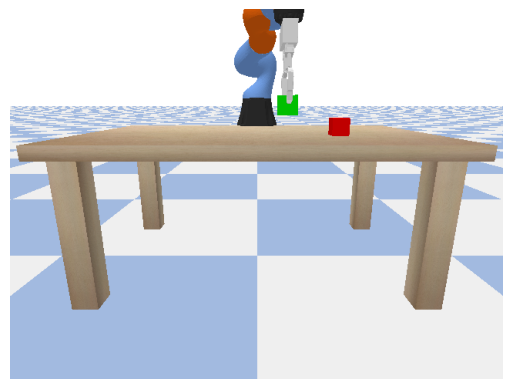

[Reward]: 1
Retrieve green


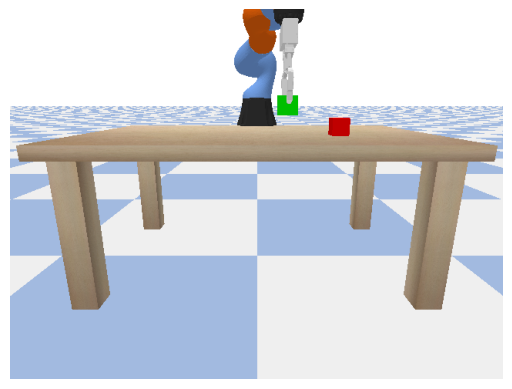

[Reward]: 1
Pick blue


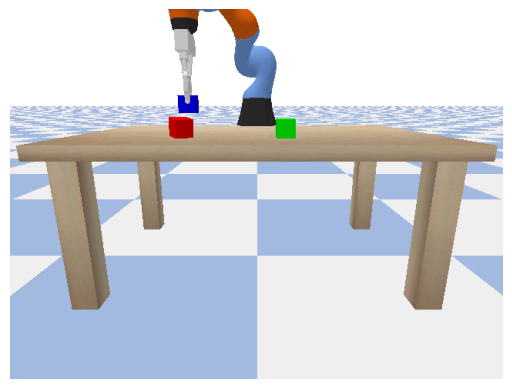

[Reward]: 1
Pick blue


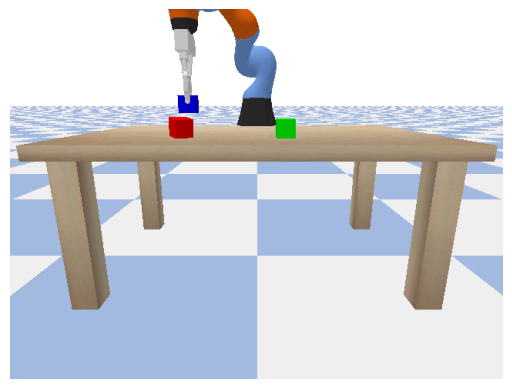

[Reward]: 1
Lift green


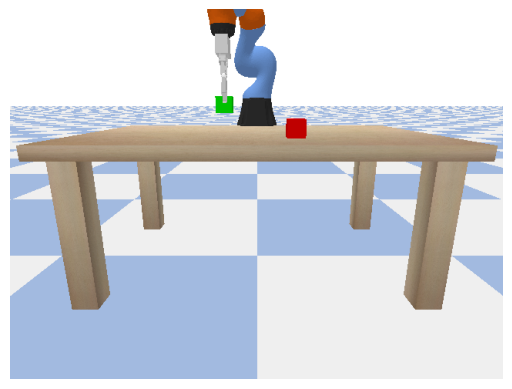

[Reward]: 1
Lift green


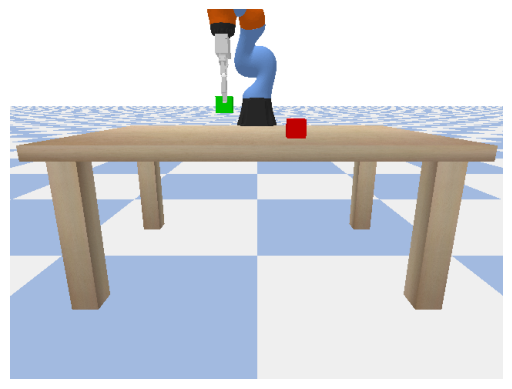

[Reward]: 1
Grab green


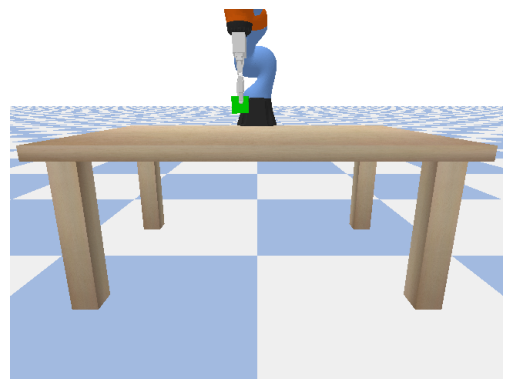

[Reward]: 1
Grab green


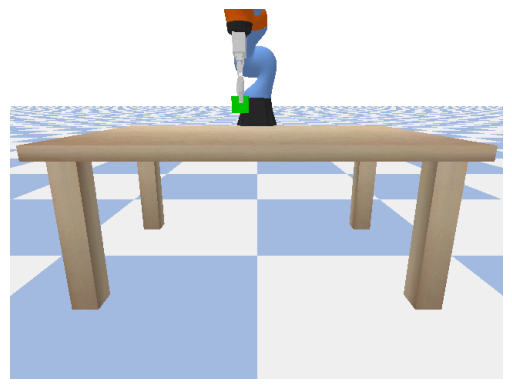

[Reward]: 1
Carry blue


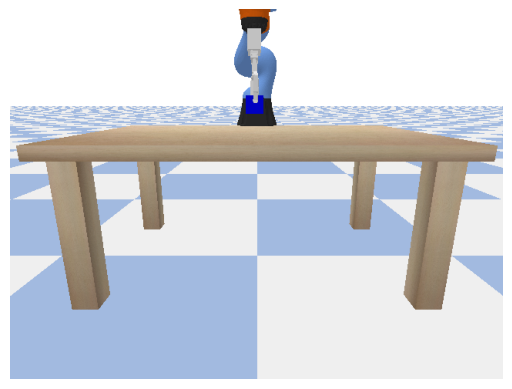

[Reward]: 1
Carry blue


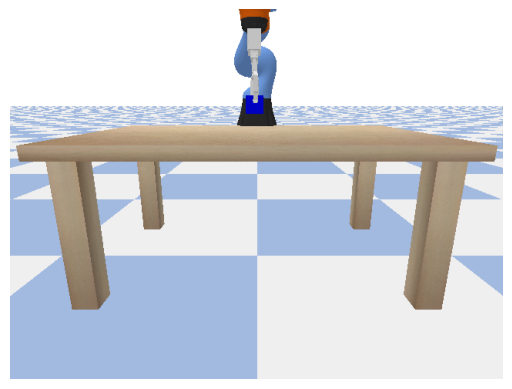

[Reward]: 1
Get green


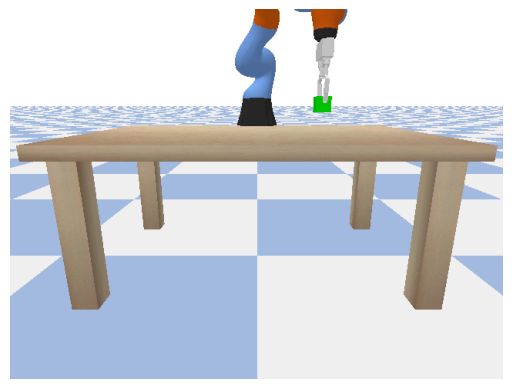

[Reward]: 1
Get green


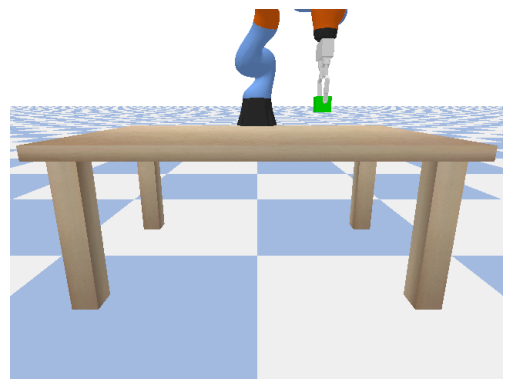

[Reward]: 1
Get red


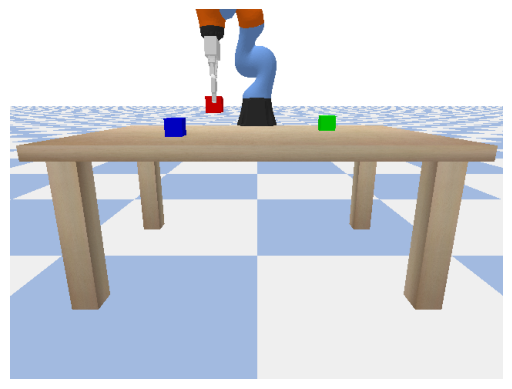

[Reward]: 1
Get red


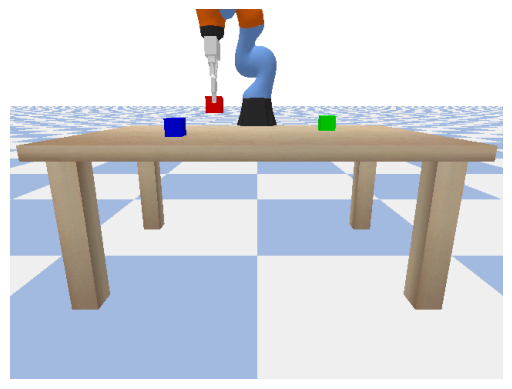

[Reward]: 1
Fetch blue


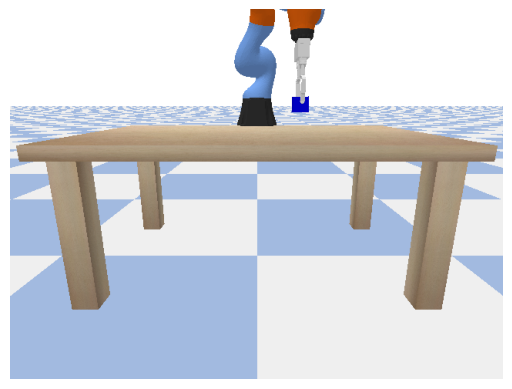

[Reward]: 1
Fetch blue


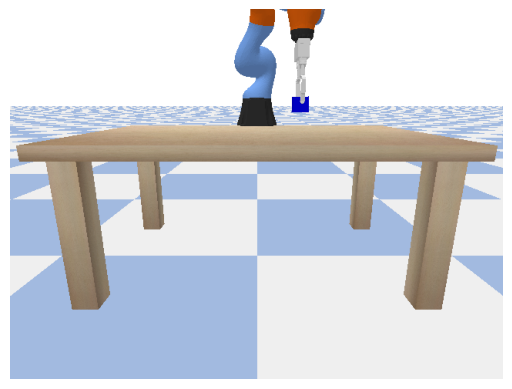

[Reward]: 1
Hoist blue


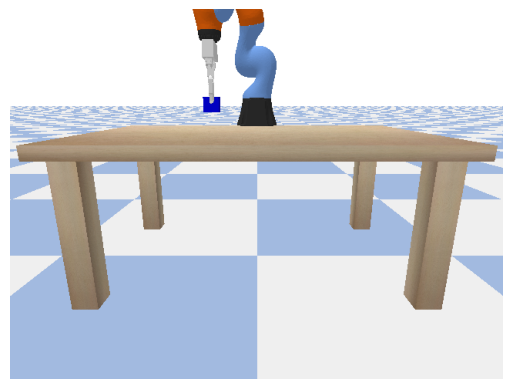

[Reward]: 1
Hoist blue


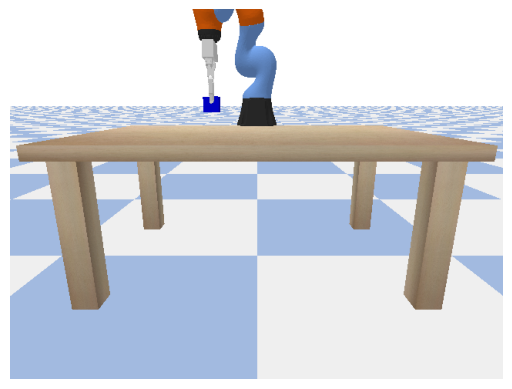

[Reward]: 1
Seize blue


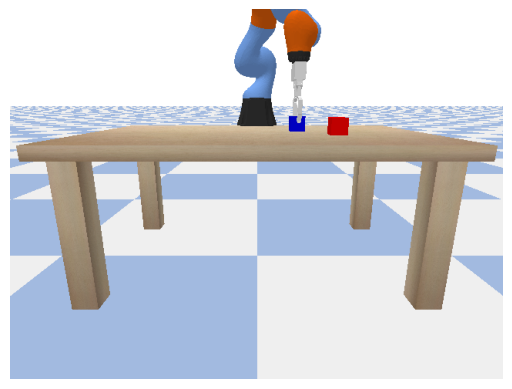

[Reward]: 1
Seize blue


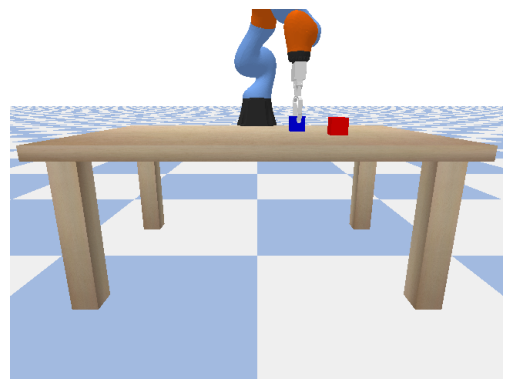

[Reward]: 1
Hold blue


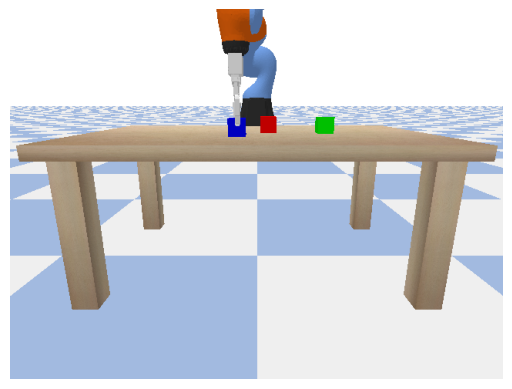

[Reward]: 1
Hold blue


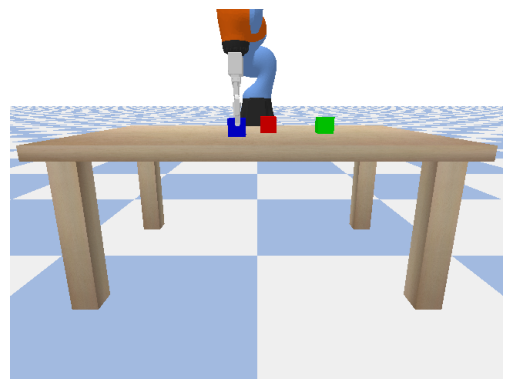

[Reward]: 1
Grab blue


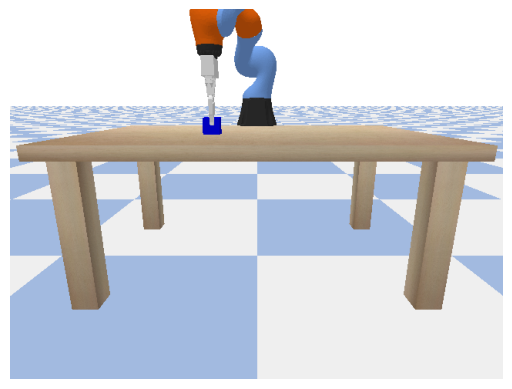

[Reward]: 1
Grab blue


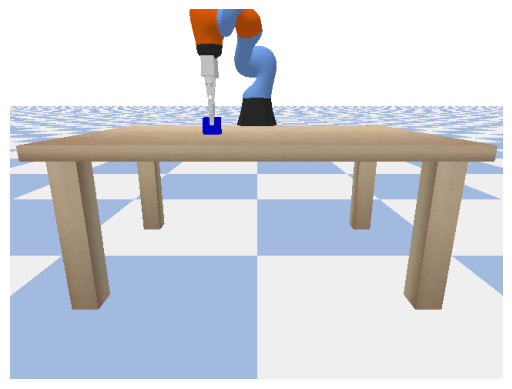

[Reward]: 1
Hold blue


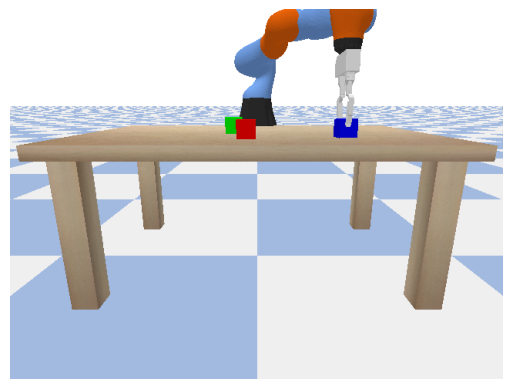

[Reward]: 1
Hold blue


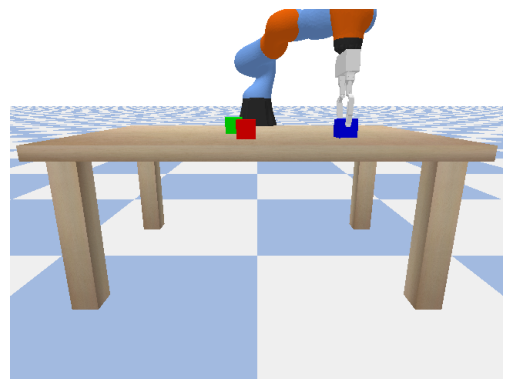

[Reward]: 1
Fetch green


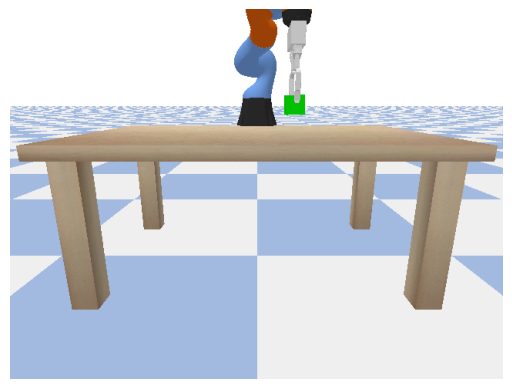

[Reward]: 1
Fetch green


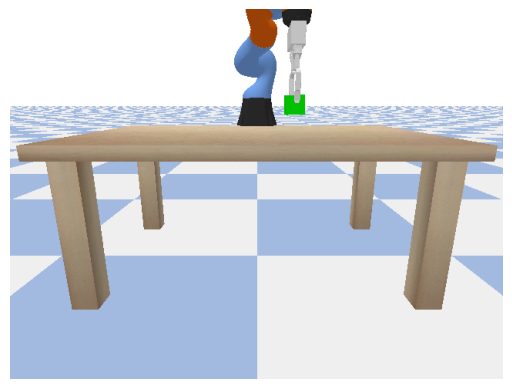

[Reward]: 1
Take green


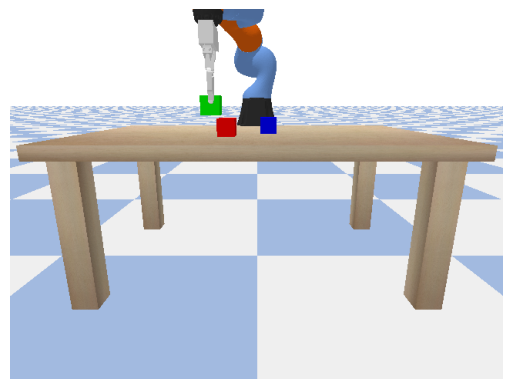

[Reward]: 1
Take green


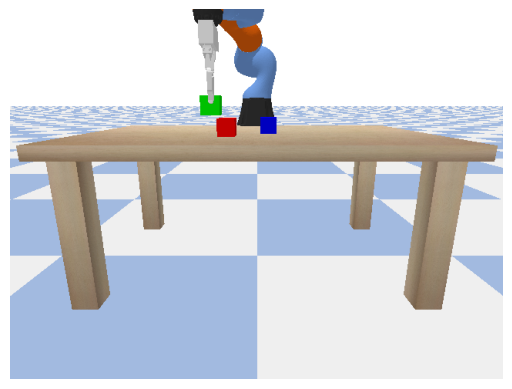

[Reward]: 1
Collect green


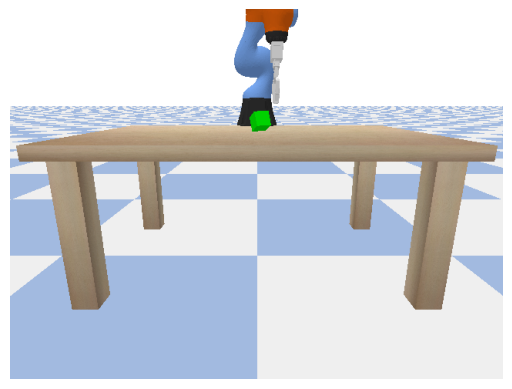

[Reward]: 1
Collect green


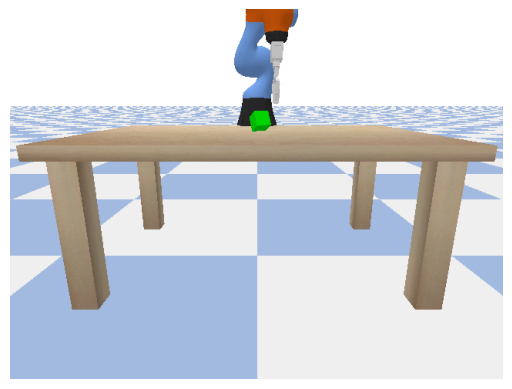

[Reward]: 1
Grasp green


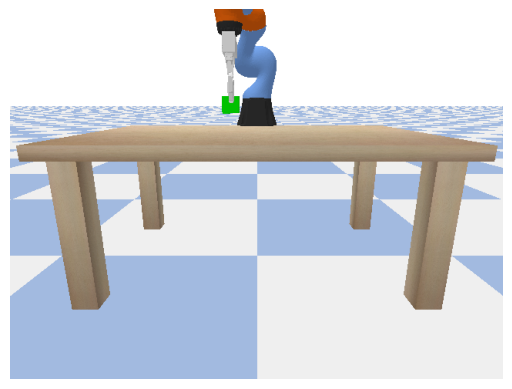

[Reward]: 1
Grasp green


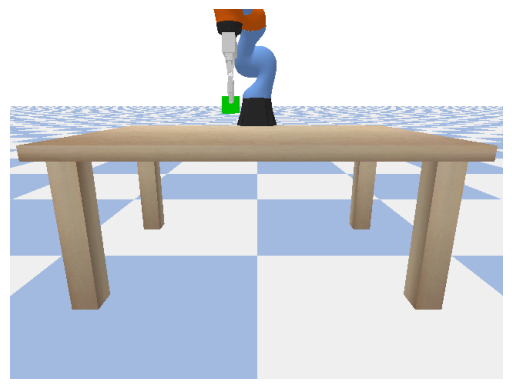

[Reward]: 1
Lift blue


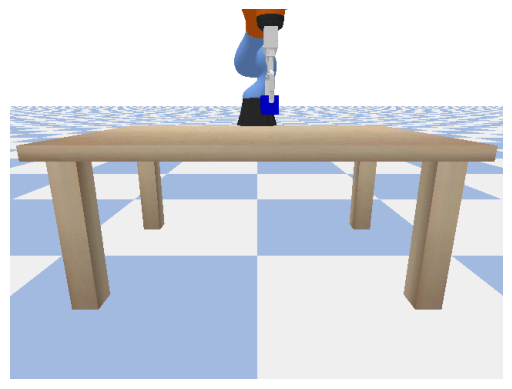

[Reward]: 1
Lift blue


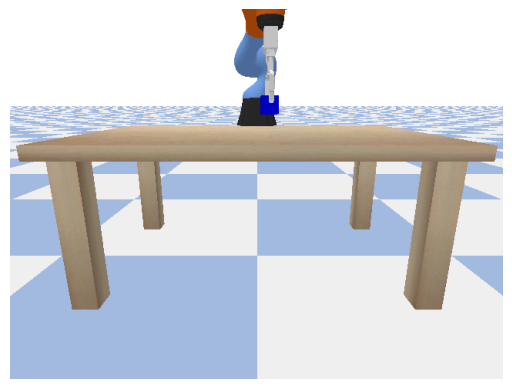

[Reward]: 1
Take green


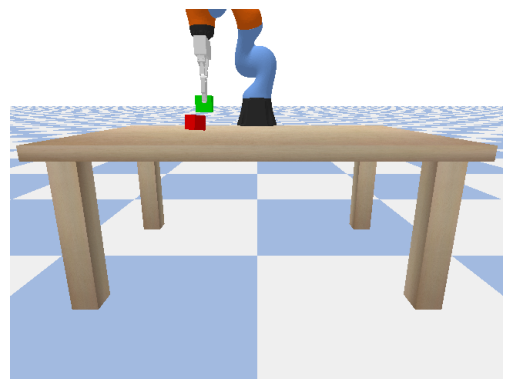

[Reward]: 1
Take green


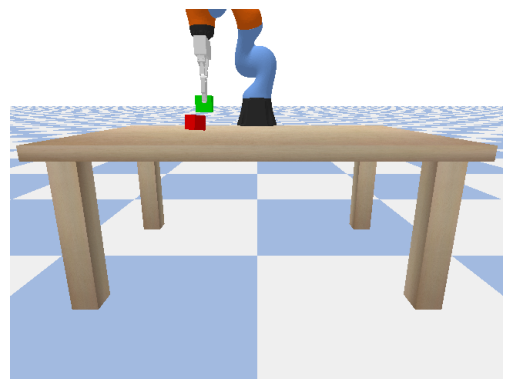

[Reward]: 1
Grasp red


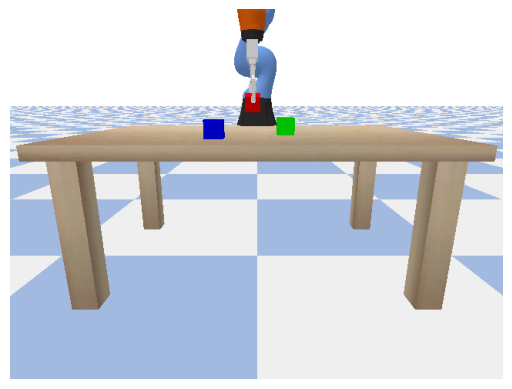

[Reward]: 1
Grasp red


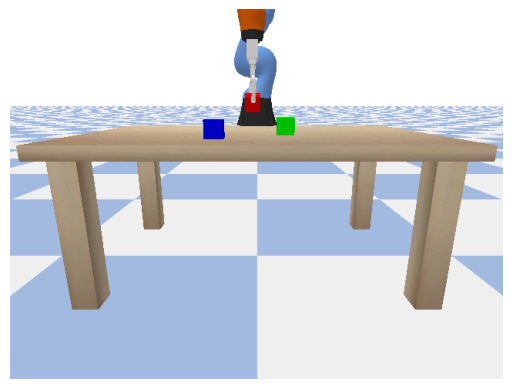

[Reward]: 1
Raise green


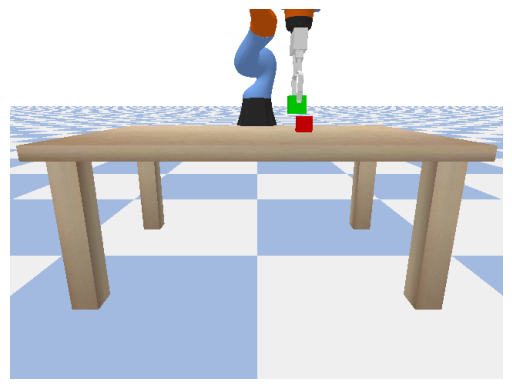

[Reward]: 1
Raise green


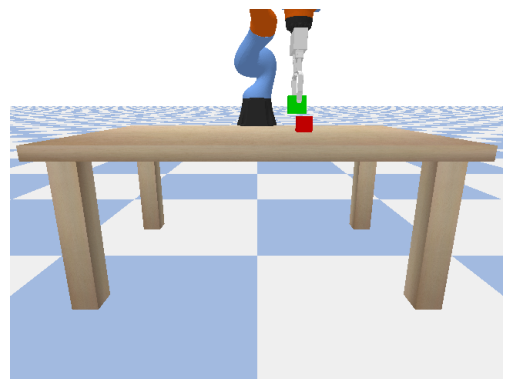

[Reward]: 0
Retrieve green


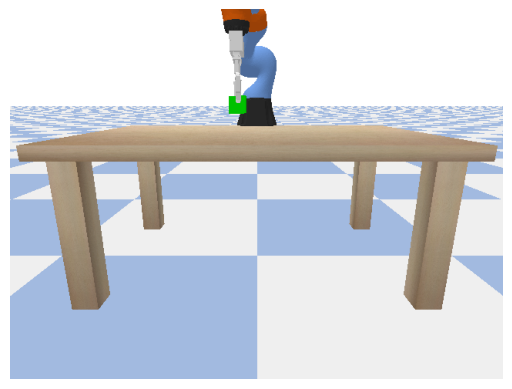

[Reward]: 1
Retrieve green


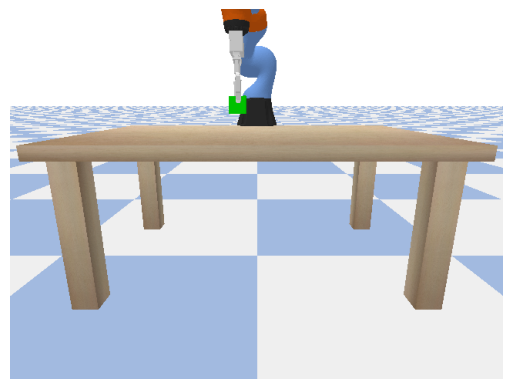

[Reward]: 1
Raise green


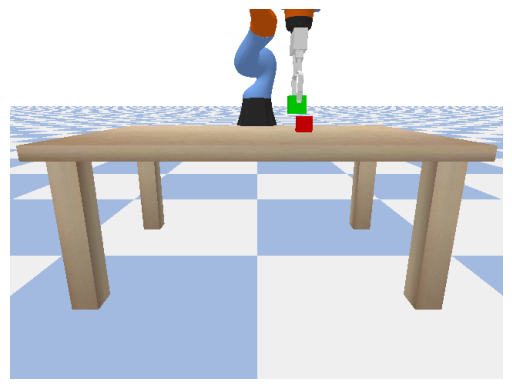

[Reward]: 1
Raise green


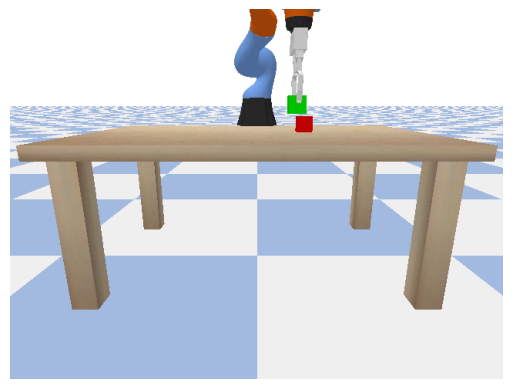

[Reward]: 0
Hoist blue


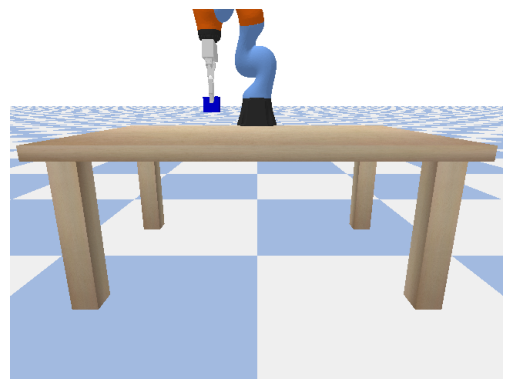

[Reward]: 1
Hoist blue


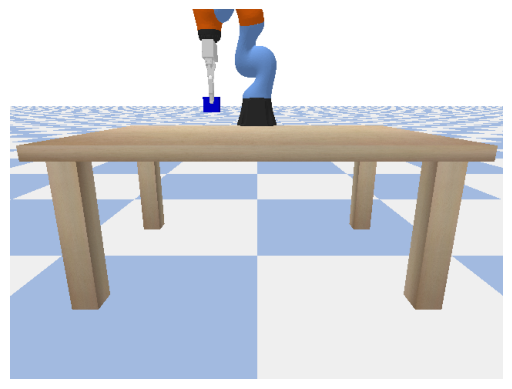

[Reward]: 1
Carry blue


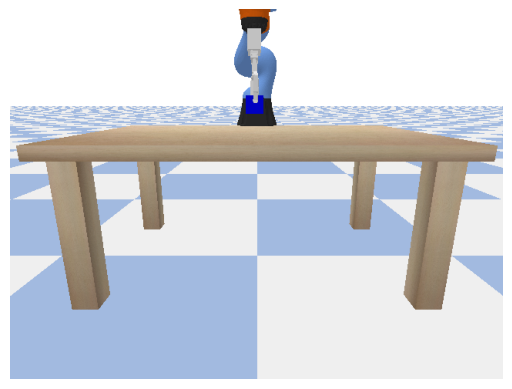

[Reward]: 1
Carry blue


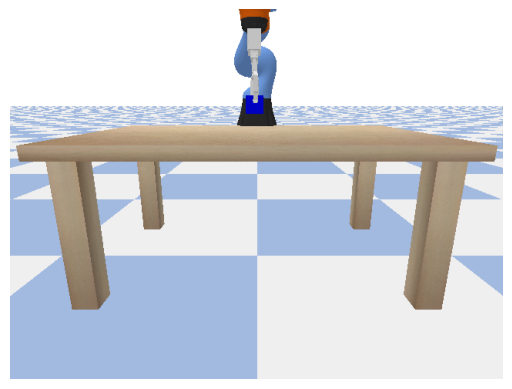

[Reward]: 1
Grab blue


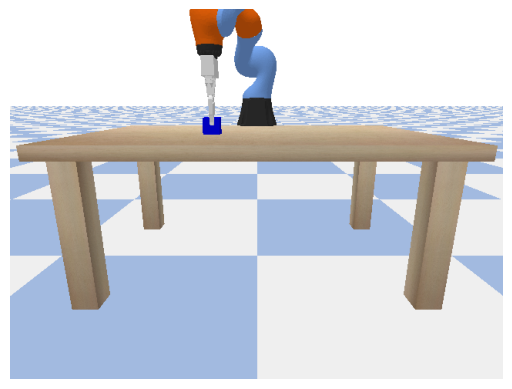

[Reward]: 1
Grab blue


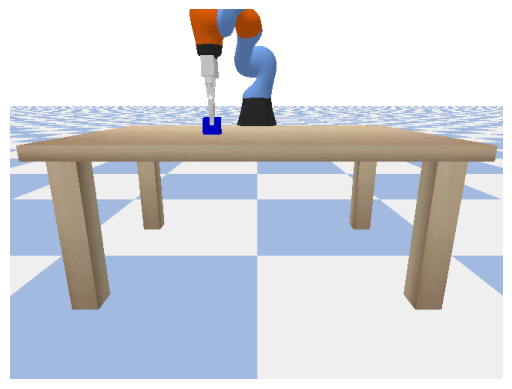

[Reward]: 1
Retrieve green


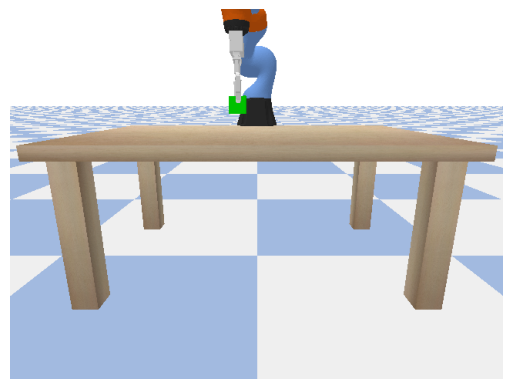

[Reward]: 1
Retrieve green


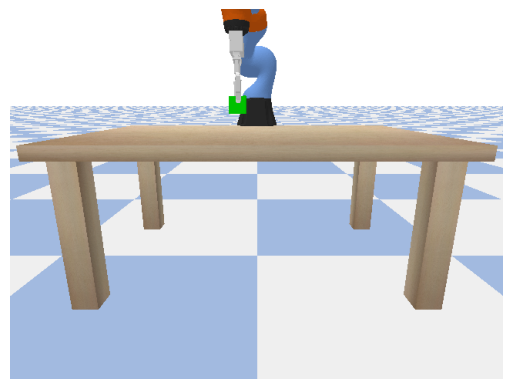

[Reward]: 1
Hold blue


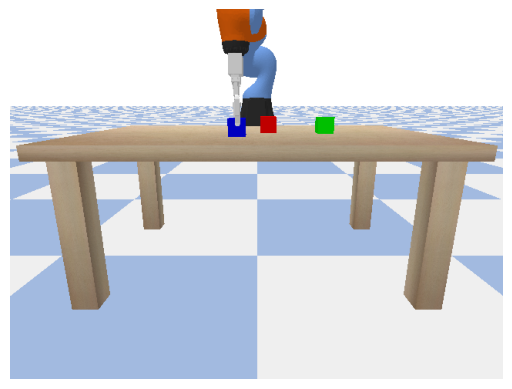

[Reward]: 1
Hold blue


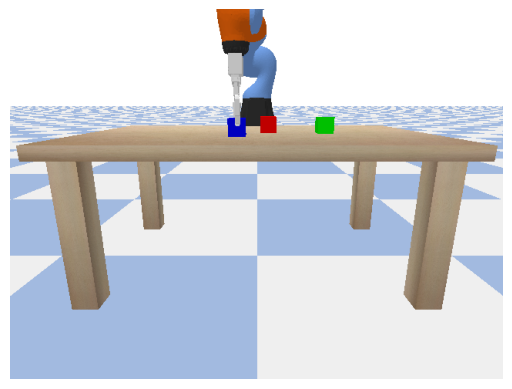

[Reward]: 1
Pick blue


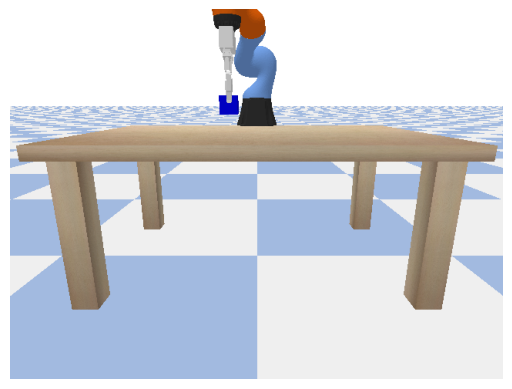

[Reward]: 1
Pick blue


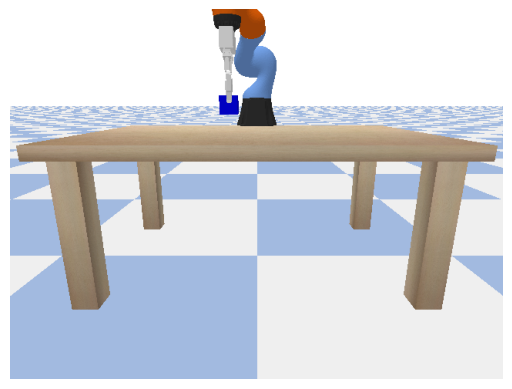

[Reward]: 1
Acquire blue


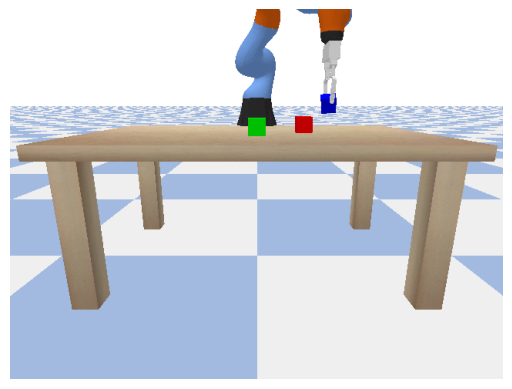

[Reward]: 1
Acquire blue


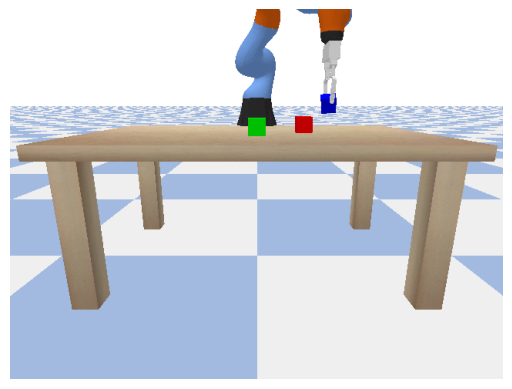

[Reward]: 1
Grab green


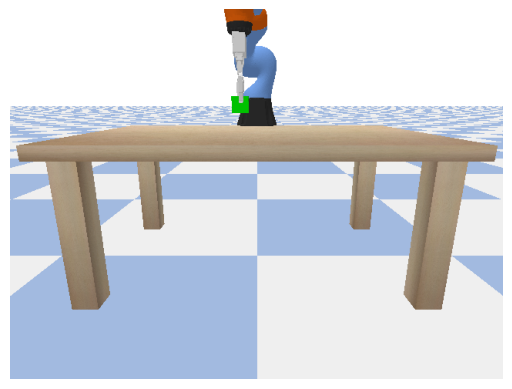

[Reward]: 1
Grab green


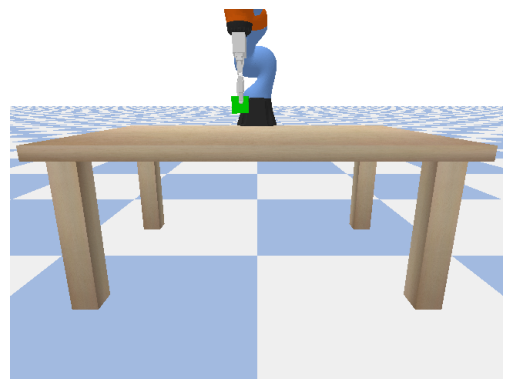

[Reward]: 1
Grasp green


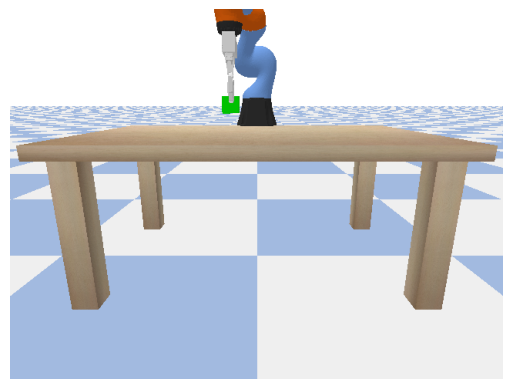

[Reward]: 1
Grasp green


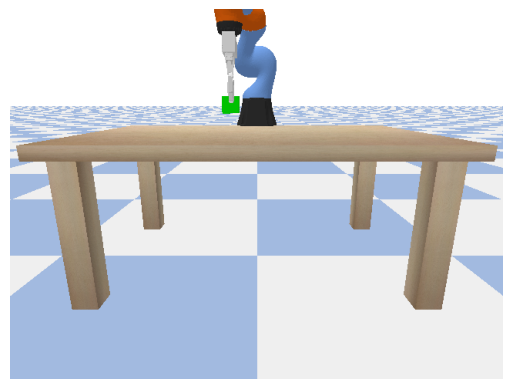

[Reward]: 1
Fetch green


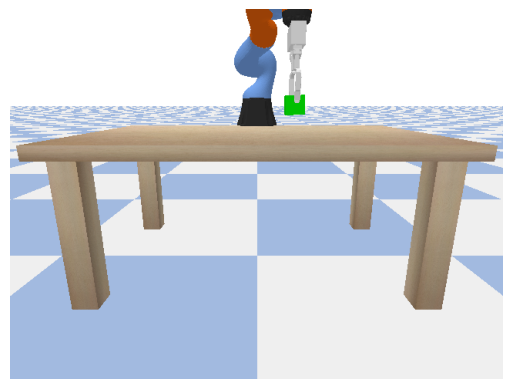

[Reward]: 1
Fetch green


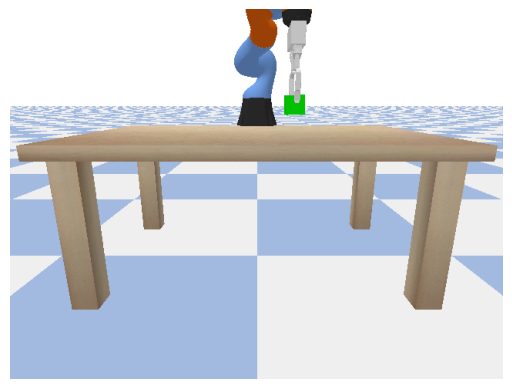

[Reward]: 1
Carry blue


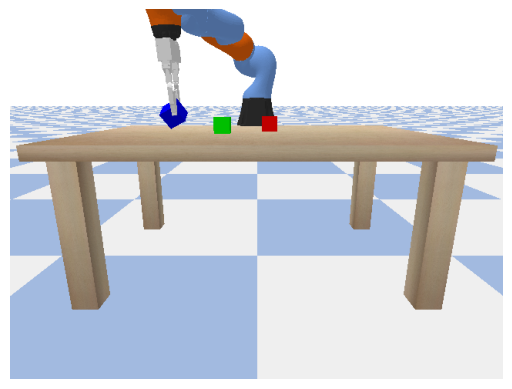

(-0.23197528719902039, 0.32569238543510437, 1.2666997909545898)
run fail
[Reward]: -1
Carry blue


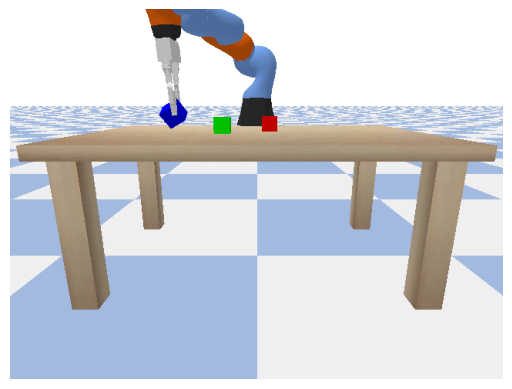

(-0.23197633028030396, 0.32569071650505066, 1.2667027711868286)
run fail
[Reward]: -1
Lift blue


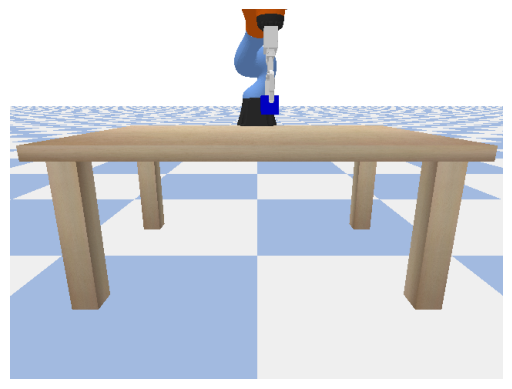

[Reward]: 1
Lift blue


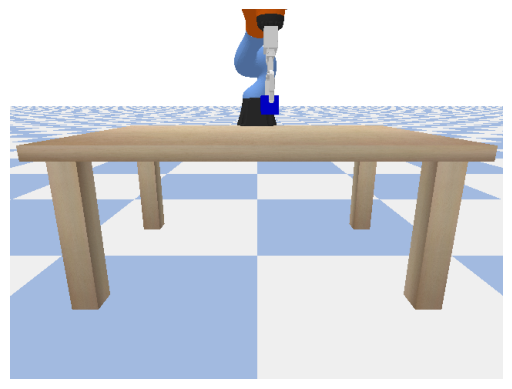

[Reward]: 1
Hoist green


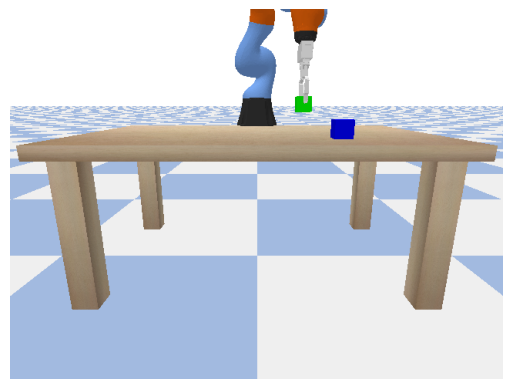

[Reward]: 1
Hoist green


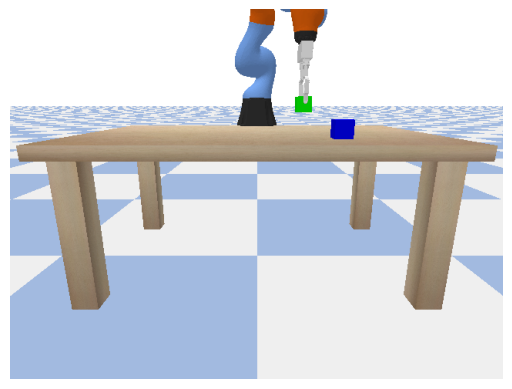

[Reward]: 1
Pick blue


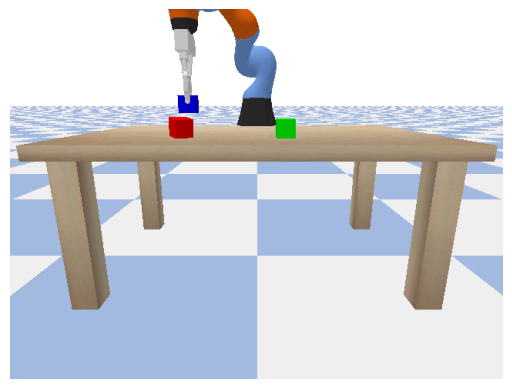

[Reward]: 1
Pick blue


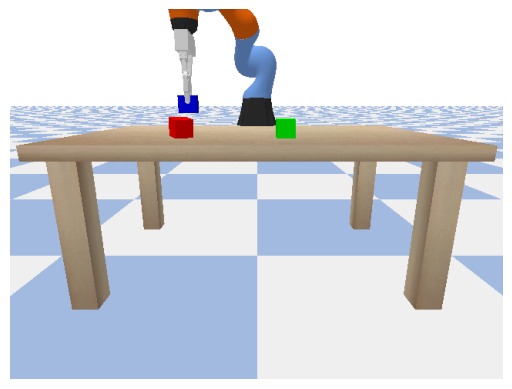

[Reward]: 1
Take green


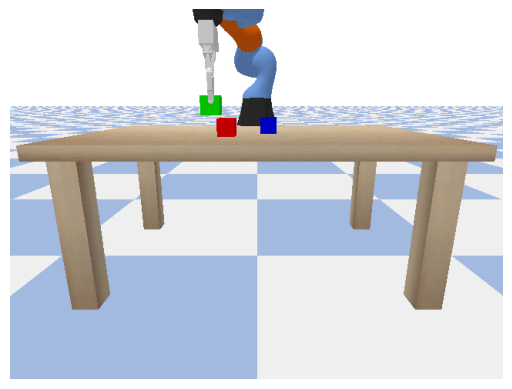

[Reward]: 1
Take green


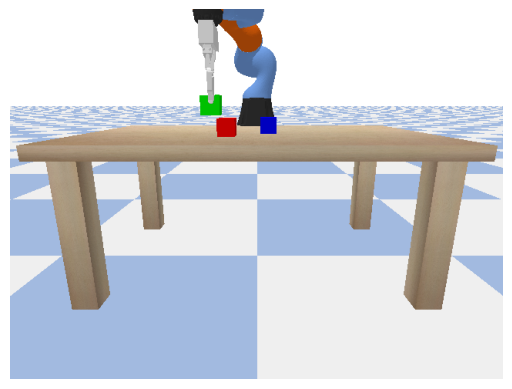

[Reward]: 1
Collect red


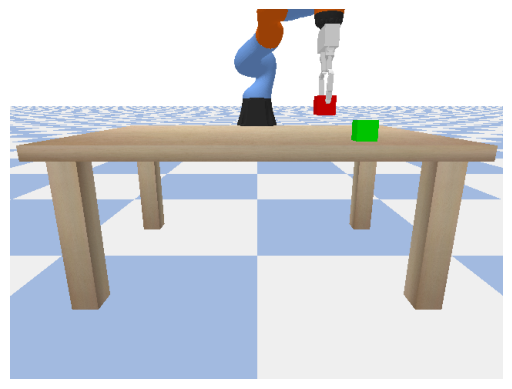

[Reward]: 1
Collect red


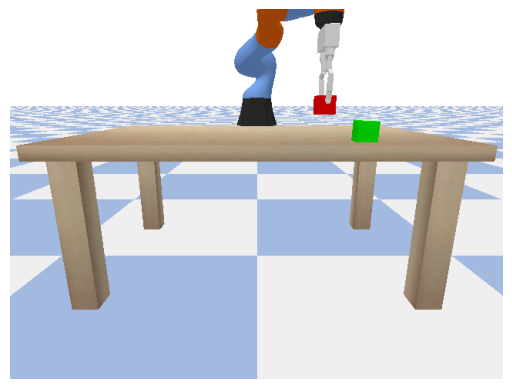

[Reward]: 1
Retrieve green


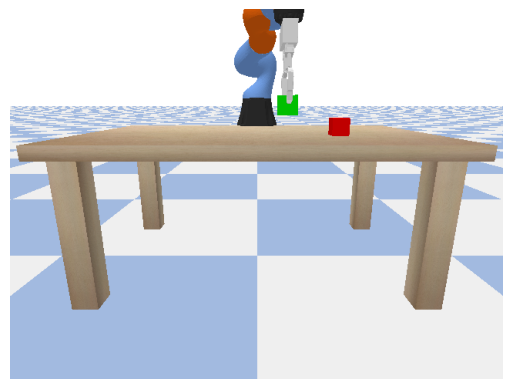

[Reward]: 1
Retrieve green


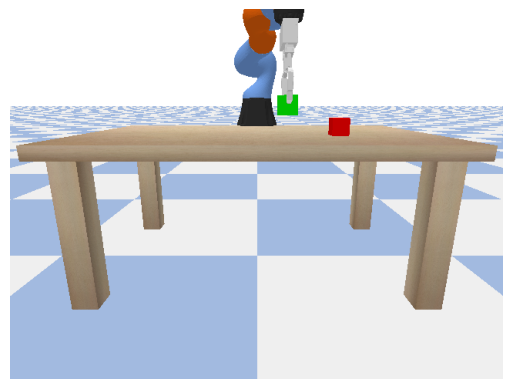

[Reward]: 1
Hold blue


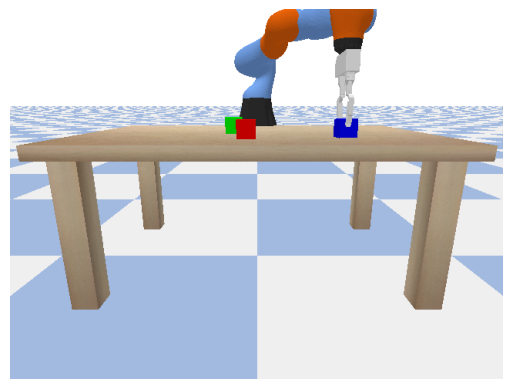

[Reward]: 1
Hold blue


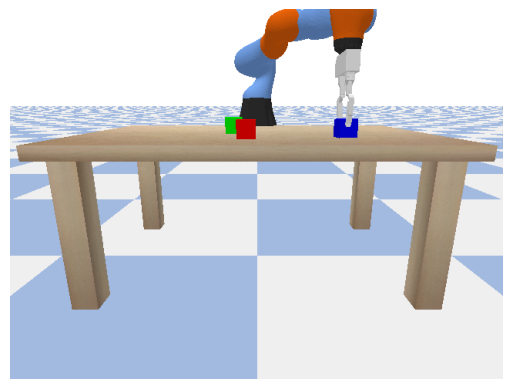

[Reward]: 1
Lift green


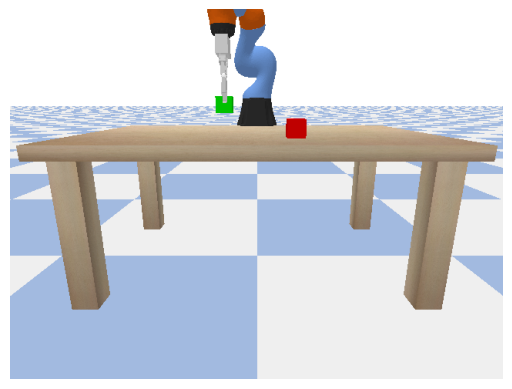

[Reward]: 1
Lift green


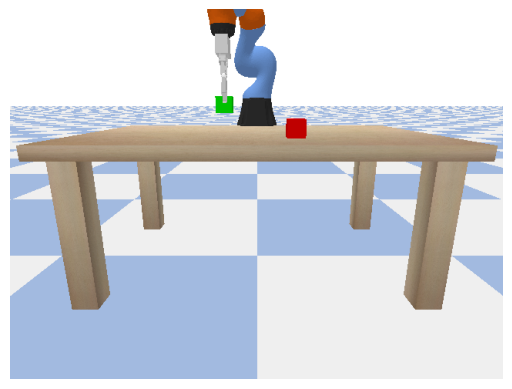

[Reward]: 1
Seize blue


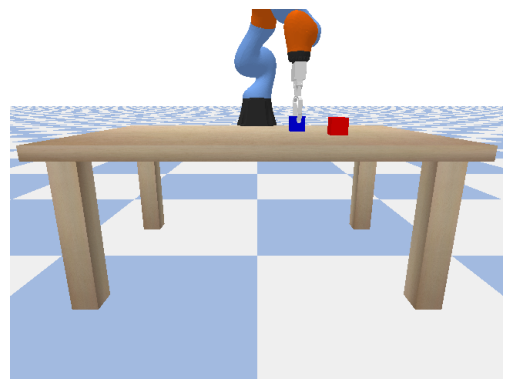

[Reward]: 1
Seize blue


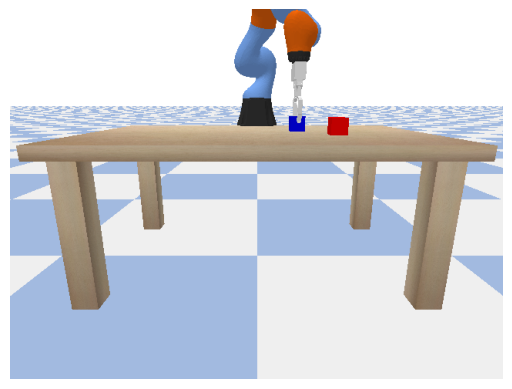

[Reward]: 1
Get red


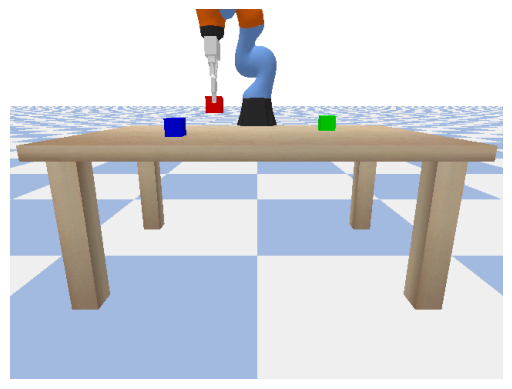

[Reward]: 1
Get red


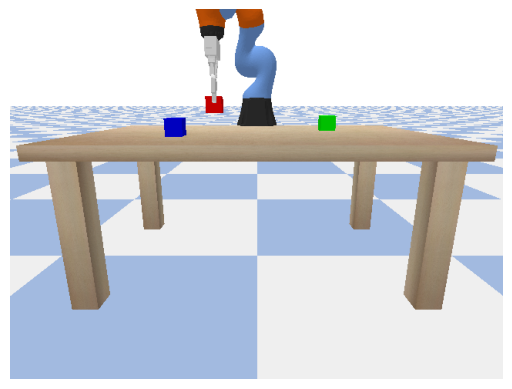

[Reward]: 1
Seize red


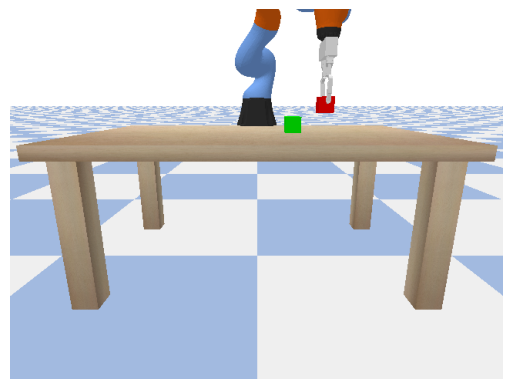

[Reward]: 1
Seize red


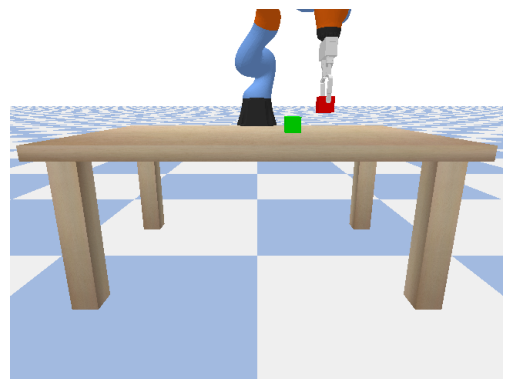

[Reward]: 1
Fetch blue


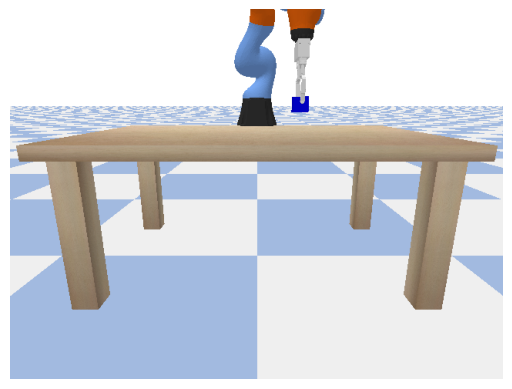

[Reward]: 1
Fetch blue


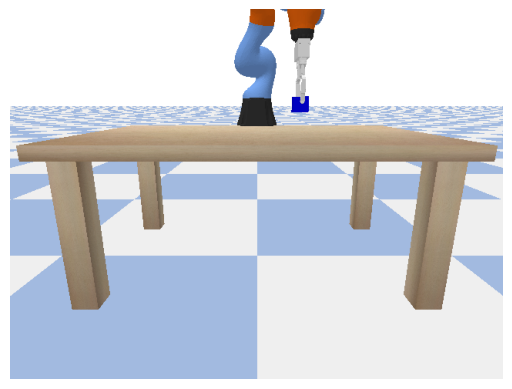

[Reward]: 1
Carry blue


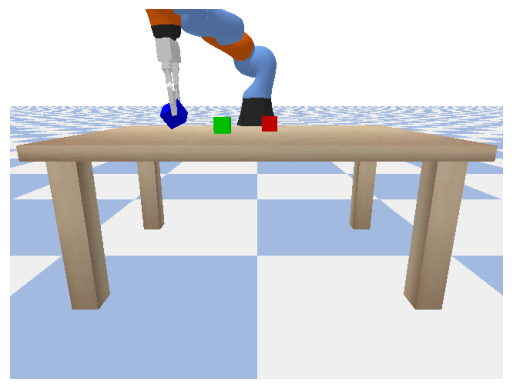

(-0.23197969794273376, 0.3256845474243164, 1.266703724861145)
run fail
[Reward]: -1
Carry blue


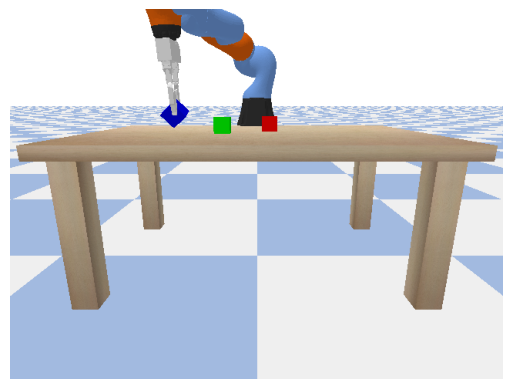

(-0.23196415603160858, 0.3257087171077728, 1.2666621208190918)
run fail
[Reward]: -1
Acquire green


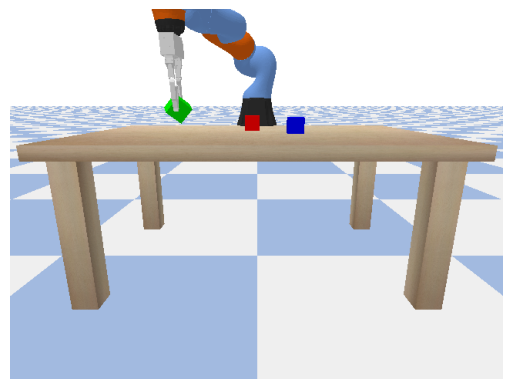

(-0.23983019590377808, 0.30881157517433167, 1.2815444469451904)
run fail
[Reward]: -1
Acquire green


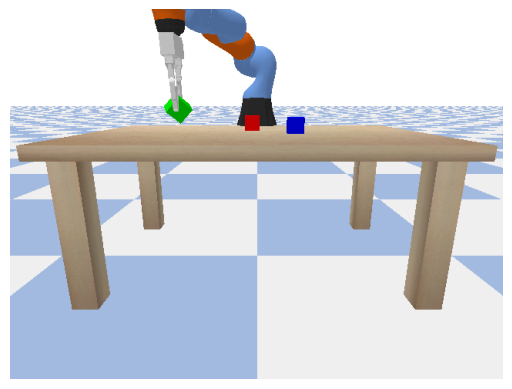

(-0.23983117938041687, 0.30880895256996155, 1.281544804573059)
run fail
[Reward]: -1
Fetch blue


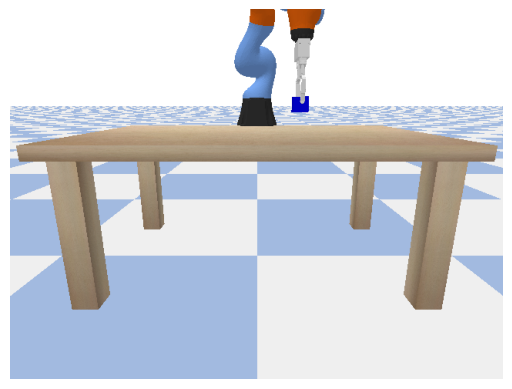

[Reward]: 1
Fetch blue


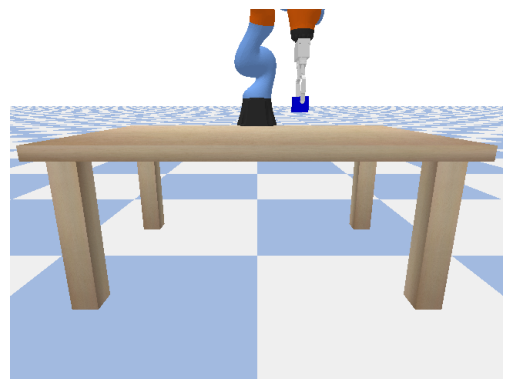

[Reward]: 1
Collect green


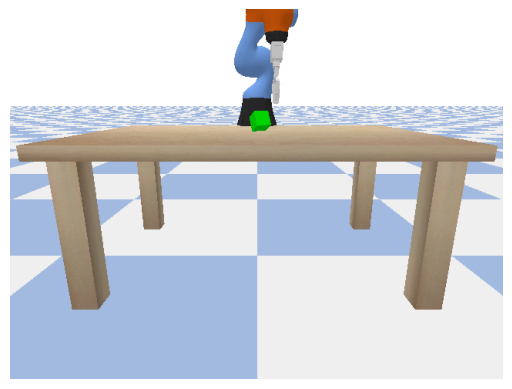

[Reward]: 1
Collect green


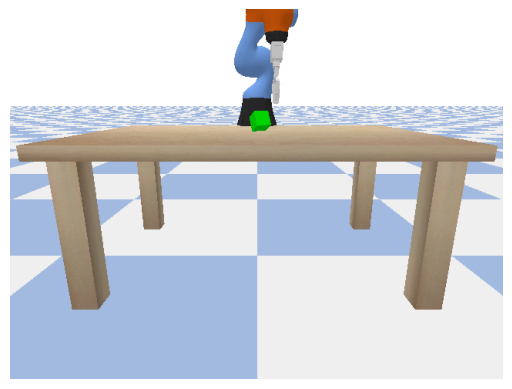

[Reward]: 1
Take green


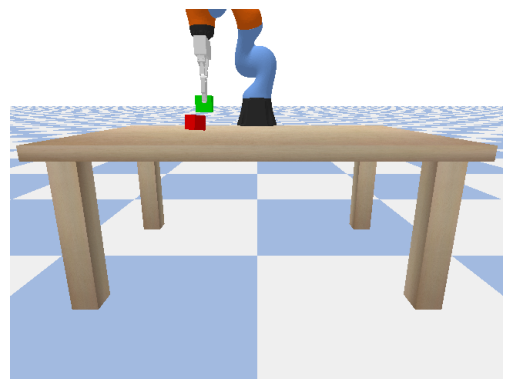

[Reward]: 1
Take green


KeyboardInterrupt: 

In [7]:
with PyBulletContext(False):
    base = Base()
    #state = saveState()

    generated_dataset = generate_train_dataset()
    train_dataset = tokenize_dataset(tokenizer, generated_dataset)

    #trainer = RLOOTrainer(
    #    model=model,
    #    args=training_args,
    #    reward_funcs=[reward_function],
    #    train_dataset=train_dataset,
    #    processing_class=tokenizer
    #)

    trainer = GRPOTrainer(
        model=model,
        processing_class=tokenizer,
        args=training_args,
        reward_funcs=[reward_function],
        train_dataset=train_dataset,
    )

    trainer.train()

In [ ]:
train_dataset[0]

In [ ]:
trainer.state.log_history